<a href="https://colab.research.google.com/github/EsuruPooja1022/Brain-Pet/blob/main/Calorie_Estimation_Indian_Food.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')

In [ ]:
df = pd.read_csv("C:\\Users\\Bala\\Downloads\\IndianFoodDatasetCSV.csv")

In [ ]:
df.head()

,Srno,RecipeName,TranslatedRecipeName,Ingredients,TranslatedIngredients,PrepTimeInMins,CookTimeInMins,TotalTimeInMins,Servings,Cuisine,Course,Diet,Instructions,TranslatedInstructions,URL
0,1,Masala Karela Recipe,Masala Karela Recipe,"6 Karela (Bitter Gourd/ Pavakkai) - deseeded,S...","6 Karela (Bitter Gourd/ Pavakkai) - deseeded,S...",15,30,45,6,Indian,Side Dish,Diabetic Friendly,"To begin making the Masala Karela Recipe,de-se...","To begin making the Masala Karela Recipe,de-se...",https://www.archanaskitchen.com/masala-karela-...
1,2,टमाटर पुलियोगरे रेसिपी - Spicy Tomato Rice (Re...,Spicy Tomato Rice (Recipe),"2-1/2 कप चावल - पका ले,3 टमाटर,3 छोटा चमच्च बी...","2-1 / 2 cups rice - cooked, 3 tomatoes, 3 teas...",5,10,15,3,South Indian Recipes,Main Course,Vegetarian,टमाटर पुलियोगरे बनाने के लिए सबसे पहले टमाटर क...,"To make tomato puliogere, first cut the tomato...",http://www.archanaskitchen.com/spicy-tomato-ri...
2,3,Ragi Semiya Upma Recipe - Ragi Millet Vermicel...,Ragi Semiya Upma Recipe - Ragi Millet Vermicel...,"1-1/2 cups Rice Vermicelli Noodles (Thin),1 On...","1-1/2 cups Rice Vermicelli Noodles (Thin),1 On...",20,30,50,4,South Indian Recipes,South Indian Breakfast,High Protein Vegetarian,"To begin making the Ragi Vermicelli Recipe, fi...","To begin making the Ragi Vermicelli Recipe, fi...",http://www.archanaskitchen.com/ragi-vermicelli...
3,4,Gongura Chicken Curry Recipe - Andhra Style Go...,Gongura Chicken Curry Recipe - Andhra Style Go...,"500 grams Chicken,2 Onion - chopped,1 Tomato -...","500 grams Chicken,2 Onion - chopped,1 Tomato -...",15,30,45,4,Andhra,Lunch,Non Vegeterian,To begin making Gongura Chicken Curry Recipe f...,To begin making Gongura Chicken Curry Recipe f...,http://www.archanaskitchen.com/gongura-chicken...
4,5,आंध्रा स्टाइल आलम पचड़ी रेसिपी - Adrak Chutney ...,Andhra Style Alam Pachadi Recipe - Adrak Chutn...,"1 बड़ा चमच्च चना दाल,1 बड़ा चमच्च सफ़ेद उरद दाल,2...","1 tablespoon chana dal, 1 tablespoon white ura...",10,20,30,4,Andhra,South Indian Breakfast,Vegetarian,आंध्रा स्टाइल आलम पचड़ी बनाने के लिए सबसे पहले ...,"To make Andhra Style Alam Pachadi, first heat ...",https://www.archanaskitchen.com/andhra-style-a...


In [ ]:
df.describe()

,Srno,PrepTimeInMins,CookTimeInMins,TotalTimeInMins,Servings
count,6871.000000,6871.000000,6871.000000,6871.000000,6871.000000
mean,4902.979042,28.585213,30.832339,59.417552,5.611410
std,3479.531022,81.042007,34.019694,88.699940,26.221807
min,1.000000,0.000000,0.000000,0.000000,1.000000
25%,1955.500000,10.000000,20.000000,30.000000,4.000000
50%,4304.000000,15.000000,30.000000,40.000000,4.000000
75%,7363.000000,20.000000,35.000000,55.000000,4.000000
max,14211.000000,2880.000000,900.000000,2925.000000,1000.000000


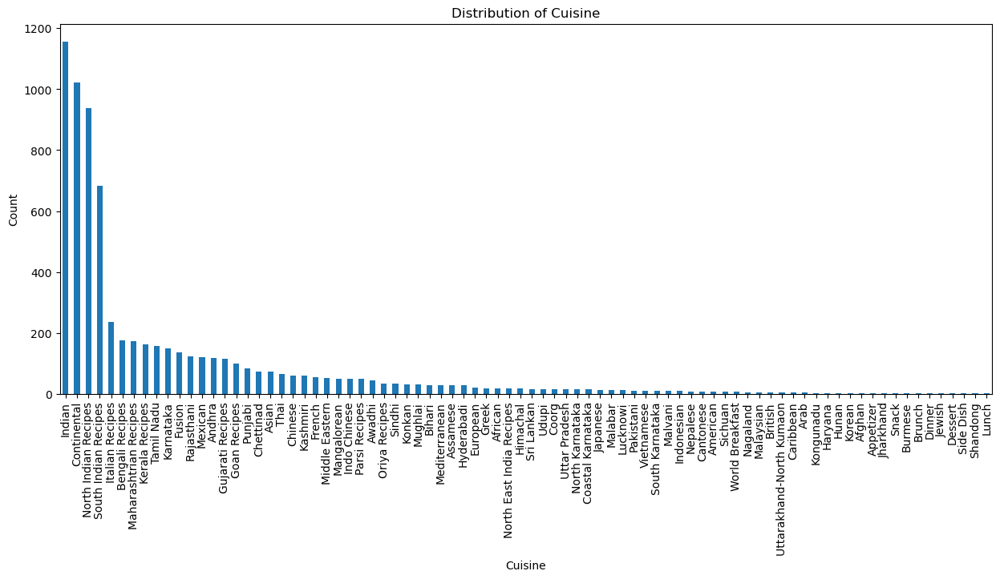

In [ ]:
plt.figure(figsize=(15, 6))
df['Cuisine'].value_counts().plot(kind='bar')
plt.title('Distribution of Cuisine')
plt.xlabel('Cuisine')
plt.ylabel('Count')
plt.xticks(rotation=90)
plt.show()

In [ ]:
calorie_map = {
    'idli': 39,
    'dosa': 133,
    'pongal': 200,
    'sambar': 150,
    'biryani (veg)': 250,
    'biryani (chicken)': 300,
    'vada': 156,
}


In [ ]:
predicted_class = 'dosa'  # Example: Predicted class from the model
calorie_value = calorie_map.get(predicted_class, "Unknown")
print(f"Predicted Food Item: {predicted_class}")
print(f"Calorie Value: {calorie_value} kcal")


Predicted Food Item: dosa
Calorie Value: 133 kcal


In [ ]:
import os
import cv2
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder

# Set paths
dataset_path = "C:\\Users\\Bala\\Downloads\\images"  # Update this path
image_size = (224, 224)  # Resize images to 224x224 (for CNN compatibility)

# Initialize variables
images = []
labels = []

# Debug: List files in the dataset path
print(f"Files in the dataset path: {os.listdir(dataset_path)}")

# Load images and labels
for file_name in os.listdir(dataset_path):
    if file_name.endswith('.jpg'):  # Consider only images
        try:
            # Read and preprocess the image
            img = cv2.imread(os.path.join(dataset_path, file_name))
            if img is not None:  # Check if image is valid
                img = cv2.resize(img, image_size)
                images.append(img)

                # Extract label from filename (example: "Chapati.jpg" -> "Chapati")
                label = file_name.split('.')[0]
                labels.append(label)
            else:
                print(f"Failed to load image: {file_name}")
        except Exception as e:
            print(f"Error loading image {file_name}: {e}")

# Convert to numpy arrays
images = np.array(images) / 255.0  # Normalize pixel values
labels = np.array(labels)

# Debug: Check the number of loaded images and labels
print(f"Loaded {len(images)} images and {len(labels)} labels.")

# Encode labels to integers
label_encoder = LabelEncoder()
labels_encoded = label_encoder.fit_transform(labels)

# Split dataset
if len(images) > 0:
    X_train, X_test, y_train, y_test = train_test_split(images, labels_encoded, test_size=0.2, random_state=42)

    print("Dataset Loaded and Preprocessed")
    print(f"Training samples: {X_train.shape[0]}, Test samples: {X_test.shape[0]}")
else:
    print("No images were loaded. Please check the dataset path or image files.")


Files in the dataset path: ['images']
Loaded 0 images and 0 labels.
No images were loaded. Please check the dataset path or image files.


In [ ]:
import zipfile
import os
import cv2
import matplotlib.pyplot as plt

# Path to the uploaded ZIP file and extraction path
zip_file_path = "C:\\Users\\Bala\\Downloads\\images.zip"
extraction_path = "C:\\Users\\Bala\\Downloads\\southfoodimages"

# Extract the ZIP file
with zipfile.ZipFile(zip_file_path, 'r') as zip_ref:
    zip_ref.extractall(extraction_path)

# Define the image folder (update this path if necessary)
image_folder = os.path.join(extraction_path, 'Indian-Food-Classification-main/uploads')

# List image files in the folder
image_files = [f for f in os.listdir(image_folder) if f.endswith(('.jpg', '.png'))]
print(f"Found {len(image_files)} images.")

# Display the first 5 images
for i, image_file in enumerate(image_files[:5]):
    # Load the image using cv2
    image_path = os.path.join(image_folder, image_file)
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert to RGB for display

    # Plot the image
    plt.figure(figsize=(4, 4))
    plt.imshow(image)
    plt.title(image_file)
    plt.axis('off')
    plt.show()


FileNotFoundError: [WinError 3] The system cannot find the path specified: 'C:\\Users\\Bala\\Downloads\\southfoodimages\\Indian-Food-Classification-main/uploads'

In [ ]:
import os

# Inspect the extraction directory
for root, dirs, files in os.walk(extraction_path):
    print(f"Directory: {root}")
    print(f"Subdirectories: {dirs}")
    print(f"Files: {files}")
    print("-" * 50)


Directory: C:\Users\Bala\Downloads\southfoodimages
Subdirectories: ['images']
Files: []
--------------------------------------------------
Directory: C:\Users\Bala\Downloads\southfoodimages\images
Subdirectories: ['All_Images', 'Apple', 'Bannana', 'beans', 'carrot', 'Cheese', 'cucumber', 'Onion', 'Orange', 'Pasta', 'Pepper', 'Qiwi', 'sauce', 'TestBeans', 'Test_Images', 'tomato', 'watermelon']
Files: []
--------------------------------------------------
Directory: C:\Users\Bala\Downloads\southfoodimages\images\All_Images
Subdirectories: []
Files: ['10_1.jpg', '10_10.jpg', '10_11.jpg', '10_12.jpg', '10_13.jpg', '10_14.jpg', '10_15.jpg', '10_16.jpg', '10_17.jpg', '10_18.jpg', '10_19.jpg', '10_2.jpg', '10_20.jpg', '10_3.jpg', '10_4.jpg', '10_5.jpg', '10_6.jpg', '10_7.jpg', '10_8.jpg', '10_9.jpg', '11_1.jpg', '11_10.jpg', '11_11.jpg', '11_12.jpg', '11_13.jpg', '11_14.jpg', '11_15.jpg', '11_16.jpg', '11_17.jpg', '11_18.jpg', '11_19.jpg', '11_2.jpg', '11_20.jpg', '11_3.jpg', '11_4.jpg', '11_5

In [ ]:
import zipfile
import os
import cv2
import matplotlib.pyplot as plt

# Paths to the uploaded ZIP file and extraction directory
zip_file_path = r"C:\Users\Bala\Downloads\images.zip"  # Use raw string to handle backslashes
extraction_path = r"C:\Users\Bala\Downloads\southfood"  # Ensure this directory exists

# Extract the ZIP file
with zipfile.ZipFile(zip_file_path, 'r') as zip_ref:
    zip_ref.extractall(extraction_path)

# Define the image folder
image_folder = extraction_path  # Images should now be directly in the extracted path

# List image files in the folder
image_files = [f for f in os.listdir(image_folder) if f.endswith(('.jpg', '.png'))]

# Print the number of images found
print(f"Found {len(image_files)} images.")

# Display the first 5 images
for i, image_file in enumerate(image_files[:5]):
    # Construct the full image path
    image_path = os.path.join(image_folder, image_file)

    # Load the image using cv2
    image = cv2.imread(image_path)
    if image is not None:
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert to RGB for display

        # Plot the image
        plt.figure(figsize=(4, 4))
        plt.imshow(image)
        plt.title(image_file)
        plt.axis('off')
        plt.show()
    else:
        print(f"Failed to load image: {image_file}")


Found 0 images.


In [ ]:
import os

extraction_path = r"C:\Users\Bala\Downloads\southfood"

# Walk through the extracted directory and list all files
for root, dirs, files in os.walk(extraction_path):
    print(f"Directory: {root}")
    print(f"Files: {files}")
    print("-" * 50)


Directory: C:\Users\Bala\Downloads\southfood
Files: []
--------------------------------------------------
Directory: C:\Users\Bala\Downloads\southfood\images
Files: []
--------------------------------------------------
Directory: C:\Users\Bala\Downloads\southfood\images\All_Images
Files: ['10_1.jpg', '10_10.jpg', '10_11.jpg', '10_12.jpg', '10_13.jpg', '10_14.jpg', '10_15.jpg', '10_16.jpg', '10_17.jpg', '10_18.jpg', '10_19.jpg', '10_2.jpg', '10_20.jpg', '10_3.jpg', '10_4.jpg', '10_5.jpg', '10_6.jpg', '10_7.jpg', '10_8.jpg', '10_9.jpg', '11_1.jpg', '11_10.jpg', '11_11.jpg', '11_12.jpg', '11_13.jpg', '11_14.jpg', '11_15.jpg', '11_16.jpg', '11_17.jpg', '11_18.jpg', '11_19.jpg', '11_2.jpg', '11_20.jpg', '11_3.jpg', '11_4.jpg', '11_5.jpg', '11_6.jpg', '11_7.jpg', '11_8.jpg', '11_9.jpg', '12_1.jpg', '12_10.jpg', '12_11.jpg', '12_12.jpg', '12_13.jpg', '12_14.jpg', '12_15.jpg', '12_16.jpg', '12_17.jpg', '12_18.jpg', '12_19.jpg', '12_2.jpg', '12_20.jpg', '12_3.jpg', '12_4.jpg', '12_5.jpg', '12_6

In [ ]:
image_folder = r"C:\Users\Bala\Downloads\southfood\images"  # Update this path based on the debug output


In [ ]:
image_files = [f for f in os.listdir(image_folder) if f.lower().endswith(('.jpg', '.png', '.jpeg'))]


No images found in the folder.


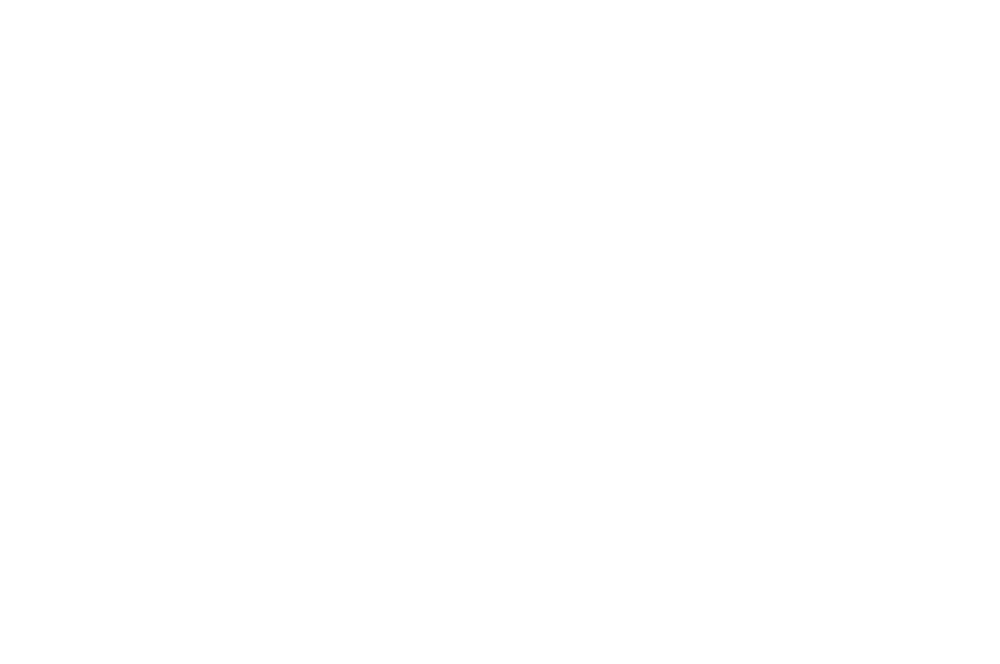

In [ ]:
import zipfile
import os
import cv2
import matplotlib.pyplot as plt

# Path to the ZIP file and extraction folder
zip_file_path = r"C:\Users\Bala\Downloads\images.zip"
extraction_path = r"C:\Users\Bala\Downloads\southfood"

# Extract the ZIP file
with zipfile.ZipFile(zip_file_path, 'r') as zip_ref:
    zip_ref.extractall(extraction_path)

# Define the folder containing the images
image_folder = extraction_path  # Update this path if images are in a subfolder

# List image files in the folder
image_files = [f for f in os.listdir(image_folder) if f.lower().endswith(('.jpg', '.png', '.jpeg'))]

# Check if images are found
if len(image_files) == 0:
    print("No images found in the folder.")
else:
    print(f"Found {len(image_files)} images.")

# Number of rows and columns for the grid
rows, cols = 2, 3  # Adjust as needed

# Plot images in a grid
fig, axes = plt.subplots(rows, cols, figsize=(12, 8))
axes = axes.flatten()

for i, ax in enumerate(axes):
    if i < len(image_files):
        # Load the image
        image_path = os.path.join(image_folder, image_files[i])
        image = cv2.imread(image_path)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert to RGB

        # Display the image
        ax.imshow(image)
        ax.set_title(os.path.splitext(image_files[i])[0])  # Use filename as the title
        ax.axis('off')
    else:
        # Hide unused subplots
        ax.axis('off')

plt.tight_layout()
plt.show()


No images found in the folder.


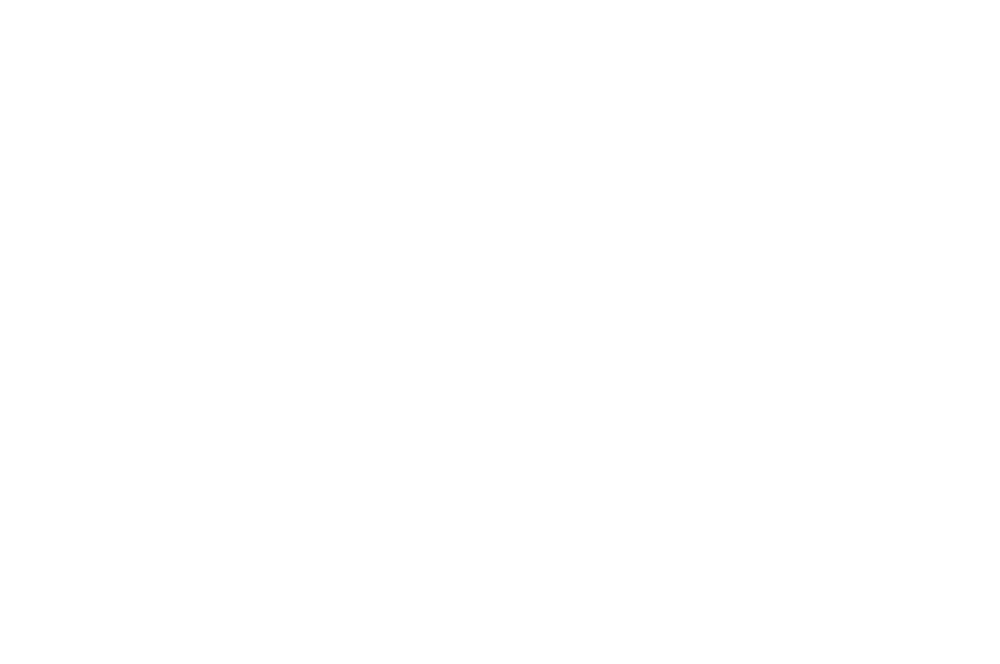

In [ ]:
import os
import cv2
import matplotlib.pyplot as plt

# Define the folder containing the images
image_folder = r"C:\Users\Bala\Desktop\Indian Food Images"  # Updated file path

# List image files in the folder
image_files = [f for f in os.listdir(image_folder) if f.lower().endswith(('.jpg', '.png', '.jpeg'))]

# Check if images are found
if len(image_files) == 0:
    print("No images found in the folder.")
else:
    print(f"Found {len(image_files)} images.")

# Number of rows and columns for the grid
rows, cols = 2, 3  # Adjust as needed

# Plot images in a grid
fig, axes = plt.subplots(rows, cols, figsize=(12, 8))
axes = axes.flatten()

for i, ax in enumerate(axes):
    if i < len(image_files):
        # Load the image
        image_path = os.path.join(image_folder, image_files[i])
        image = cv2.imread(image_path)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert to RGB

        # Display the image
        ax.imshow(image)
        ax.set_title(os.path.splitext(image_files[i])[0])  # Use filename as the title
        ax.axis('off')
    else:
        # Hide unused subplots
        ax.axis('off')

plt.tight_layout()
plt.show()


In [ ]:
from zipfile import ZipFile
import os
from PIL import Image

# Define paths for the dataset
zip_file_path = "C:\\Users\\Bala\\Downloads\\images.zip"  # Replace with the actual path
extracted_path = 'images_extracted/'

# Extract the zip file
with ZipFile(zip_file_path, 'r') as zip_ref:
    zip_ref.extractall(extracted_path)

# Get all image file names in the extracted folder
image_files = [f for f in os.listdir(extracted_path) if f.endswith(('png', 'jpg', 'jpeg'))]

# Resize and display the first 10 images
resized_images = []
for img_file in image_files[:10]:  # Process first 10 images
    img_path = os.path.join(extracted_path, img_file)
    with Image.open(img_path) as img:
        resized_img = img.resize((128, 128))  # Resize to 128x128
        resized_images.append(resized_img)

# Show resized images
for resized_img in resized_images:
    resized_img.show()


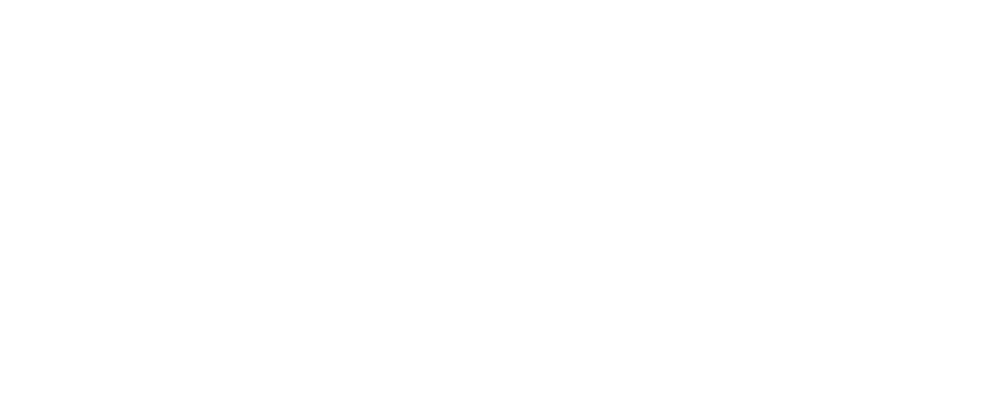

In [ ]:
import matplotlib.pyplot as plt
from PIL import Image
import os

# Assuming 'resized_images' contains the resized images (ensure they are created first)

# Create a grid to display the first 10 resized images
fig, axes = plt.subplots(2, 5, figsize=(15, 6))  # 2 rows, 5 columns

# Display each image in the grid
for i, ax in enumerate(axes.flat):
    if i < len(resized_images):
        ax.imshow(resized_images[i])
        ax.axis('off')  # Hide axes
    else:
        ax.axis('off')  # Hide unused grid cells

plt.tight_layout()
plt.show()


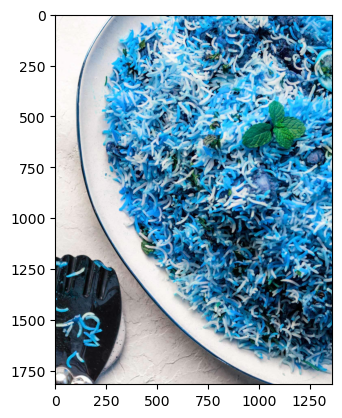

In [ ]:
import cv2
import matplotlib.pyplot as plt
vm=cv2.imread(r"C:\\Users\\Bala\\Desktop\\Indian Food Images\\biryani\\5f814c0627.jpg")
plt.imshow(vm)

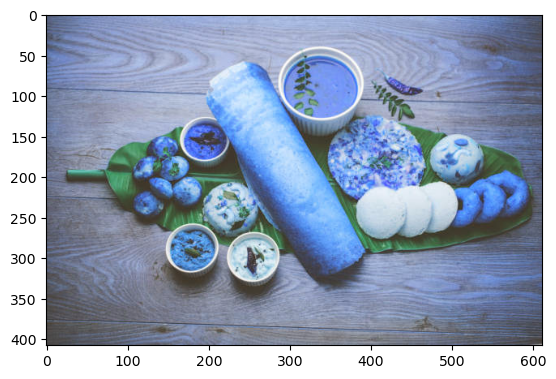

In [ ]:
import cv2
import matplotlib.pyplot as plt
vm=cv2.imread(r"C:\\Users\\Bala\\Desktop\\south food\\istockphoto-1024558340-612x612.jpg")
plt.imshow(vm)


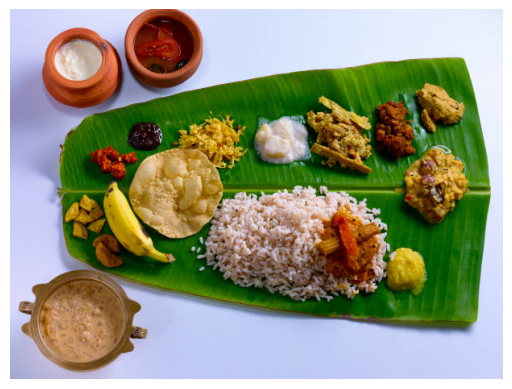

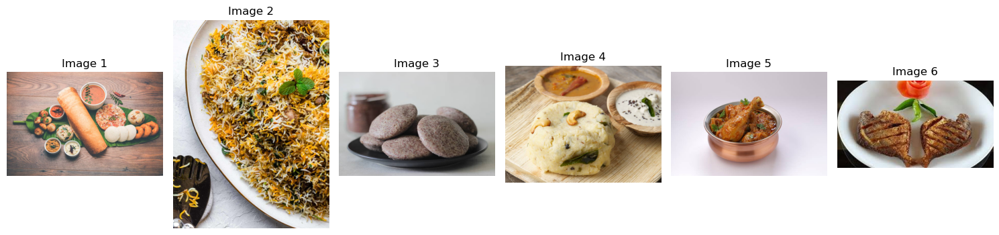

In [ ]:
import cv2
import matplotlib.pyplot as plt

# List of image file paths
image_paths = [
   r"C:\\Users\\Bala\\Desktop\\south food\\istockphoto-1024558340-612x612.jpg",
   r"C:\\Users\\Bala\\Desktop\\Indian Food Images\\biryani\\5f814c0627.jpg",
   r"C:\\Users\\Bala\\Desktop\\south food\\istockphoto-1313104347-612x612.jpg",
   r"C:\\Users\\Bala\\Desktop\\south food\\istockphoto-678434780-612x612.jpg",
   r"C:\\Users\\Bala\\Desktop\\south food\\istockphoto-1254597620-612x612.jpg",
   r"C:\\Users\\Bala\\Desktop\\south food\\images (1).jpg"
]

# Create a figure for the images
fig, axes = plt.subplots(1, len(image_paths), figsize=(15, 5))

# Loop through the images and display them
for i, path in enumerate(image_paths):
    # Read the image
    img = cv2.imread(path)

    # Check if the image is loaded successfully
    if img is None:
        print(f"Failed to load image from {path}")
        axes[i].axis('off')  # Hide axes for missing image
        continue

    # Convert BGR to RGB
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    # Display the image in the corresponding subplot
    axes[i].imshow(img_rgb)
    axes[i].axis('off')  # Hide axes
    axes[i].set_title(f"Image {i+1}")  # Optional title

# Adjust spacing
plt.tight_layout()
plt.show()


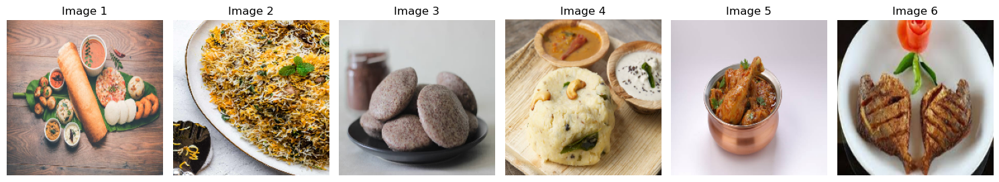

In [ ]:
import cv2
import matplotlib.pyplot as plt

# List of image file paths
image_paths = [
    r"C:\\Users\\Bala\\Desktop\\south food\\istockphoto-1024558340-612x612.jpg",
    r"C:\\Users\\Bala\\Desktop\\Indian Food Images\\biryani\\5f814c0627.jpg",
    r"C:\\Users\\Bala\\Desktop\\south food\\istockphoto-1313104347-612x612.jpg",
    r"C:\\Users\\Bala\\Desktop\\south food\\istockphoto-678434780-612x612.jpg",
    r"C:\\Users\\Bala\\Desktop\\south food\\istockphoto-1254597620-612x612.jpg",
    r"C:\\Users\\Bala\\Desktop\\south food\\images (1).jpg",
]

# Set the common size for all images (e.g., 200x200 pixels)
resize_dim = (200, 200)  # Width, Height

# Create a figure for the images
fig, axes = plt.subplots(1, len(image_paths), figsize=(15, 5))

# Loop through the images and display them
for i, path in enumerate(image_paths):
    # Read the image
    img = cv2.imread(path)

    # Check if the image is loaded successfully
    if img is None:
        print(f"Failed to load image from {path}")
        axes[i].axis('off')  # Hide axes for missing image
        continue

    # Resize the image to the specified dimensions
    img_resized = cv2.resize(img, resize_dim)

    # Convert BGR to RGB
    img_rgb = cv2.cvtColor(img_resized, cv2.COLOR_BGR2RGB)

    # Display the image in the corresponding subplot
    axes[i].imshow(img_rgb)
    axes[i].axis('off')  # Hide axes
    axes[i].set_title(f"Image {i+1}")  # Optional title

# Adjust spacing
plt.tight_layout()
plt.show()


IndexError: index 2 is out of bounds for axis 0 with size 2

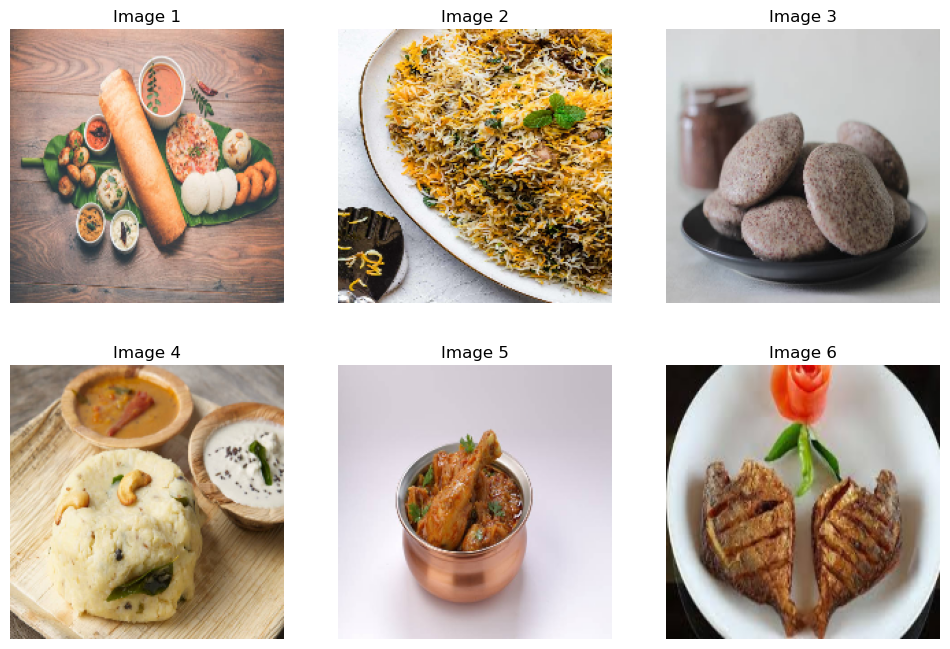

In [ ]:
import cv2
import matplotlib.pyplot as plt

# List of image file paths
image_paths = [
    r"C:\\Users\\Bala\\Desktop\\south food\\istockphoto-1024558340-612x612.jpg",
    r"C:\\Users\\Bala\\Desktop\\Indian Food Images\\biryani\\5f814c0627.jpg",
    r"C:\\Users\\Bala\\Desktop\\south food\\istockphoto-1313104347-612x612.jpg",
    r"C:\\Users\\Bala\\Desktop\\south food\\istockphoto-678434780-612x612.jpg",
    r"C:\\Users\\Bala\\Desktop\\south food\\istockphoto-1254597620-612x612.jpg",
    r"C:\\Users\\Bala\\Desktop\\south food\\images (1).jpg",
    r"C:\\Users\\Bala\\Desktop\\Indian Food Images\\unni_appam\5dbfa6d2d0.jpg",
    r"C:\\Users\\Bala\\Desktop\\Indian Food Images\\navrattan_korma\\0a45c68b4d.jpg"
]

# Set the common size for all images (e.g., 200x200 pixels)
resize_dim = (200, 200)  # Width, Height

# Create a 2x3 grid for the images
fig, axes = plt.subplots(2, 3, figsize=(12, 8))

# Loop through the images and display them
for i, path in enumerate(image_paths):
    # Read the image
    img = cv2.imread(path)

    # Check if the image is loaded successfully
    if img is None:
        print(f"Failed to load image from {path}")
        axes[i // 4, i % 4].axis('off')  # Hide axes for missing image
        continue

    # Resize the image to the specified dimensions
    img_resized = cv2.resize(img, resize_dim)

    # Convert BGR to RGB
    img_rgb = cv2.cvtColor(img_resized, cv2.COLOR_BGR2RGB)

    # Display the image in the corresponding subplot
    ax = axes[i // 3, i % 3]
    ax.imshow(img_rgb)
    ax.axis('off')  # Hide axes
    ax.set_title(f"Image {i+1}")  # Optional title

# Hide any unused subplots
for j in range(len(image_paths), 6):  # Adjust 6 for the total grid slots (2x3)
    axes[j // 4, j % 4].axis('off')

# Adjust spacing
plt.tight_layout()
plt.show()


In [ ]:
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Flatten, Dropout
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.preprocessing.image import ImageDataGenerator

# Load pre-trained model (ResNet50) and freeze its layers
base_model = ResNet50(weights='imagenet', include_top=False, input_shape=(224, 224, 3))
base_model.trainable = False

# Build your model
model = Sequential([
    base_model,
    Flatten(),
    Dense(128, activation='relu'),
    Dropout(0.5),
    Dense(1, activation='linear')  # Output layer for calorie prediction
])

model.compile(optimizer='adam', loss='mse', metrics=['mae'])
model.summary()


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ resnet50 (Functional)           │ (None, 7, 7, 2048)     │    23,587,712 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 100352)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 128)            │    12,845,184 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 1)              │           129 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 36,433,025 (138.98 MB)

 Trainable params: 12,845,313 (49.00 MB)

 Non-trainable params: 23,587,712 (89.98 MB)

In [ ]:
import numpy as np
from tensorflow.keras.preprocessing.image import load_img, img_to_array

def predict_calories(image_path, model):
    img = load_img(image_path, target_size=(224, 224))
    img_array = img_to_array(img) / 255.0
    img_array = np.expand_dims(img_array, axis=0)
    predicted_calories = model.predict(img_array)
    return predicted_calories[0][0]

# Predict
calories = predict_calories(r"C:\\Users\\Bala\\Desktop\\south food\\images (1).jpg", model)
print(f"Predicted Calories: {calories}")


1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step
Predicted Calories: 0.9662879705429077


In [ ]:
import numpy as np
from tensorflow.keras.preprocessing.image import load_img, img_to_array

def predict_calories(image_path, model):
    img = load_img(image_path, target_size=(224, 224))
    img_array = img_to_array(img) / 255.0
    img_array = np.expand_dims(img_array, axis=0)
    predicted_calories = model.predict(img_array)
    return predicted_calories[0][0]

# Predict
calories = predict_calories( r"C:\\Users\\Bala\\Desktop\\south food\\istockphoto-1024558340-612x612.jpg", model)
print(f"Predicted Calories: {calories}")


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step
Predicted Calories: 1.0052410364151


In [ ]:
import os
import pandas as pd
import numpy as np
from tensorflow.keras.preprocessing.image import load_img, img_to_array

# Path to the image folder
image_folder = r"C:\\Users\\Bala\\Desktop\\south food"

# Example calorie data (create your own or generate it dynamically)
calorie_data = {
    "filename": ["C:\\Users\\Bala\\Desktop\\south food\\51ho3ce412c.webp"],
    "calories": [250]  # Replace these with real calorie estimates
}

# Convert the data to a DataFrame
calorie_df = pd.DataFrame(calorie_data)

# Resize dimensions for the images
img_size = (224, 224)

# Prepare image data and labels
images = []
calories = []

for _, row in calorie_df.iterrows():
    img_path = os.path.join(image_folder, row['filename'])
    if os.path.exists(img_path):
        # Load the image
        img = load_img(img_path, target_size=img_size)
        img_array = img_to_array(img) / 255.0  # Normalize pixel values to [0, 1]
        images.append(img_array)
        calories.append(row['calories'])

# Convert to NumPy arrays
images = np.array(images)
calories = np.array(calories)

print(f"Image shape: {images.shape}, Calorie shape: {calories.shape}")


Image shape: (1, 224, 224, 3), Calorie shape: (1,)


In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# South Indian food dataset
data = {
    'Food Item': ['Dosa', 'Idli', 'Sambar', 'Vada', 'Pongal', 'Biryani', 'Uttapam',
                  'Rava Kesari', 'Masala Dosa', 'Appam', 'Chettinad Curry', 'Pesarattu',
                  'Puliyodarai', 'Curd Rice'],
    'Category': ['Breakfast', 'Breakfast', 'Soup', 'Snack', 'Breakfast', 'Main Course',
                 'Breakfast', 'Dessert', 'Snack', 'Breakfast', 'Main Course', 'Breakfast',
                 'Main Course', 'Side Dish'],
    'Calories': [120, 39, 150, 180, 350, 250, 150, 200, 350, 150, 450, 250, 300, 150],
    'Serving Size (g)': [150, 100, 200, 100, 200, 300, 150, 100, 200, 120, 250, 150, 200, 200]
}

# Create a DataFrame
df = pd.DataFrame(data)

# 1. Bar Plot for Calories by Food Item
plt.figure(figsize=(10,6))
sns.barplot(x='Food Item', y='Calories', data=df, palette='viridis')
plt.title('Calories per South Indian Food Item')
plt.xticks(rotation=45)
plt.show()

# 2. Pie Chart for Food Category Distribution
category_counts = df['Category'].value_counts()
plt.figure(figsize=(8,8))
category_counts.plot(kind='pie', autopct='%1.1f%%', colors=sns.color_palette("Set3", len(category_counts)))
plt.title('Food Category Distribution (South Indian)')
plt.ylabel('')
plt.show()

# 3. Scatter Plot: Calories vs Serving Size
plt.figure(figsize=(8,6))
sns.scatter


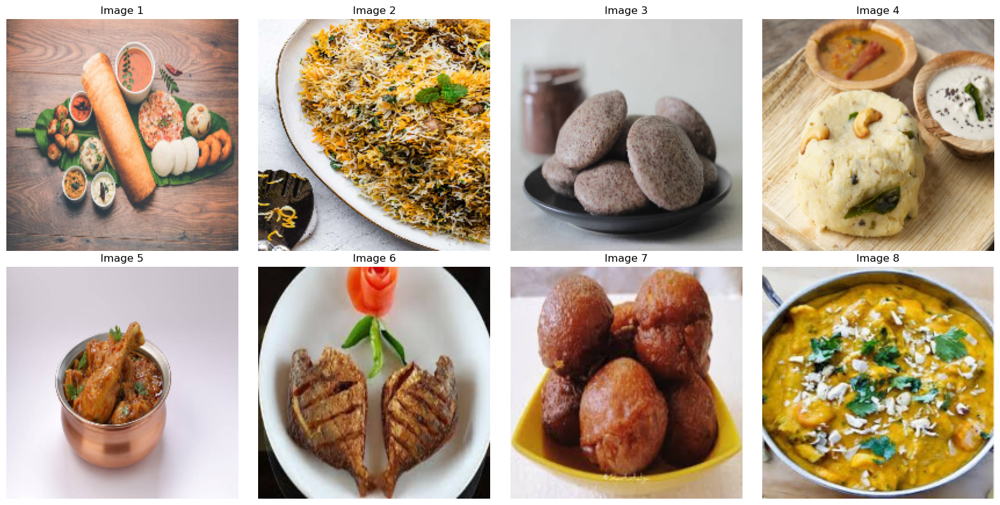

In [ ]:
import cv2
import matplotlib.pyplot as plt

# List of image file paths
image_paths = [
    r"C:\\Users\\Bala\\Desktop\\south food\\istockphoto-1024558340-612x612.jpg",
    r"C:\\Users\\Bala\\Desktop\\Indian Food Images\\biryani\\5f814c0627.jpg",
    r"C:\\Users\\Bala\\Desktop\\south food\\istockphoto-1313104347-612x612.jpg",
    r"C:\\Users\\Bala\\Desktop\\south food\\istockphoto-678434780-612x612.jpg",
    r"C:\\Users\\Bala\\Desktop\\south food\\istockphoto-1254597620-612x612.jpg",
    r"C:\\Users\\Bala\\Desktop\\south food\\images (1).jpg",
    r"C:\\Users\\Bala\\Desktop\\Indian Food Images\\unni_appam\\5dbfa6d2d0.jpg",
    r"C:\\Users\\Bala\\Desktop\\Indian Food Images\\navrattan_korma\\0a45c68b4d.jpg"
]

# Set the common size for all images (e.g., 200x200 pixels)
resize_dim = (200, 200)  # Width, Height

# Create a 2x4 grid for the images
rows, cols = 2, 4
fig, axes = plt.subplots(rows, cols, figsize=(16, 8))

# Flatten the axes array for easier indexing
axes = axes.flatten()

# Loop through the images and display them
for i, path in enumerate(image_paths):
    # Read the image
    img = cv2.imread(path)

    # Check if the image is loaded successfully
    if img is None:
        print(f"Failed to load image from {path}")
        axes[i].axis('off')  # Hide axes for missing image
        continue

    # Resize the image to the specified dimensions
    img_resized = cv2.resize(img, resize_dim)

    # Convert BGR to RGB
    img_rgb = cv2.cvtColor(img_resized, cv2.COLOR_BGR2RGB)

    # Display the image in the corresponding subplot
    axes[i].imshow(img_rgb)
    axes[i].axis('off')  # Hide axes
    axes[i].set_title(f"Image {i+1}")  # Optional title

# Hide any unused subplots
for j in range(len(image_paths), len(axes)):
    axes[j].axis('off')

# Adjust spacing
plt.tight_layout()
plt.show()


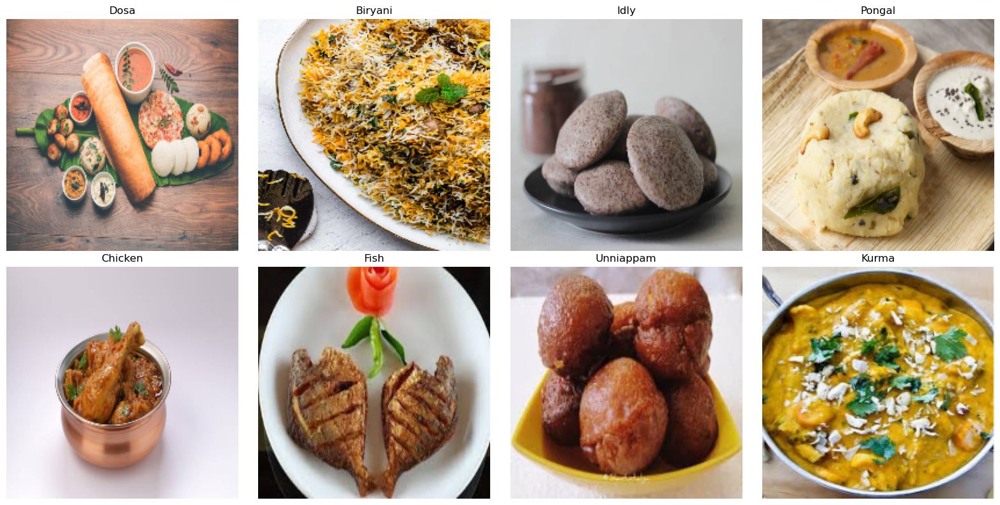

In [ ]:
import cv2
import matplotlib.pyplot as plt

# List of image file paths
image_paths = [
    r"C:\\Users\\Bala\\Desktop\\south food\\istockphoto-1024558340-612x612.jpg",
    r"C:\\Users\\Bala\\Desktop\\Indian Food Images\\biryani\\5f814c0627.jpg",
    r"C:\\Users\\Bala\\Desktop\\south food\\istockphoto-1313104347-612x612.jpg",
    r"C:\\Users\\Bala\\Desktop\\south food\\istockphoto-678434780-612x612.jpg",
    r"C:\\Users\\Bala\\Desktop\\south food\\istockphoto-1254597620-612x612.jpg",
    r"C:\\Users\\Bala\\Desktop\\south food\\images (1).jpg",
    r"C:\\Users\\Bala\\Desktop\\Indian Food Images\\unni_appam\\5dbfa6d2d0.jpg",
    r"C:\\Users\\Bala\\Desktop\\Indian Food Images\\navrattan_korma\\0a45c68b4d.jpg"
]

# List of image labels (names)
image_labels = [
    "Dosa", "Biryani", "Idly", "Pongal", "Chicken", "Fish", "Unniappam", "Kurma"
]

# Set the common size for all images (e.g., 200x200 pixels)
resize_dim = (200, 200)  # Width, Height

# Create a 2x4 grid for the images
rows, cols = 2, 4
fig, axes = plt.subplots(rows, cols, figsize=(16, 8))

# Flatten the axes array for easier indexing
axes = axes.flatten()

# Loop through the images and display them
for i, (path, label) in enumerate(zip(image_paths, image_labels)):
    # Read the image
    img = cv2.imread(path)

    # Check if the image is loaded successfully
    if img is None:
        print(f"Failed to load image from {path}")
        axes[i].axis('off')  # Hide axes for missing image
        continue

    # Resize the image to the specified dimensions
    img_resized = cv2.resize(img, resize_dim)

    # Convert BGR to RGB
    img_rgb = cv2.cvtColor(img_resized, cv2.COLOR_BGR2RGB)

    # Display the image in the corresponding subplot
    axes[i].imshow(img_rgb)
    axes[i].axis('off')  # Hide axes
    axes[i].set_title(label)  # Use the label as the title

# Hide any unused subplots
for j in range(len(image_paths), len(axes)):
    axes[j].axis('off')

# Adjust spacing
plt.tight_layout()
plt.show()


In [ ]:
pip install numpy opencv-python matplotlib


Note: you may need to restart the kernel to use updated packages.


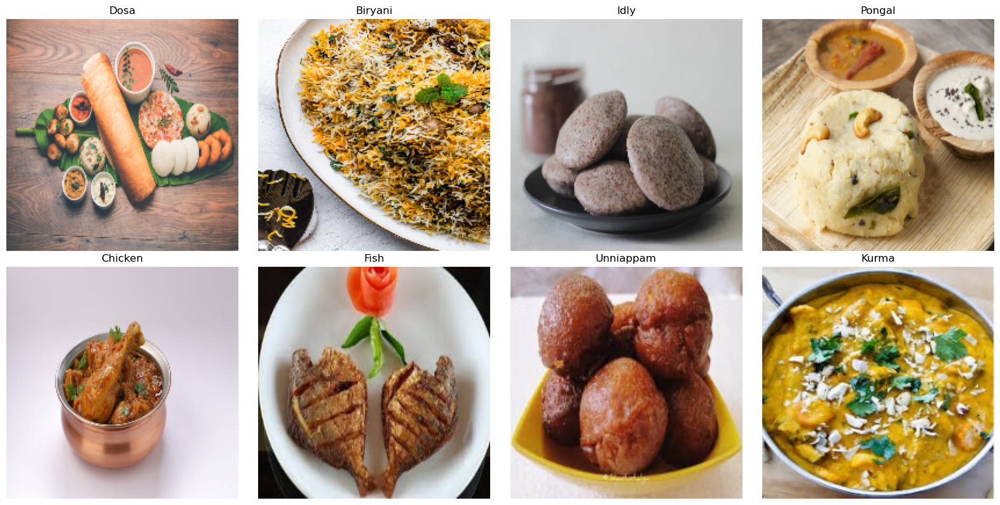

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# List of image file paths
image_paths = [
    r"C:\\Users\\Bala\\Desktop\\south food\\istockphoto-1024558340-612x612.jpg",
    r"C:\\Users\\Bala\\Desktop\\Indian Food Images\\biryani\\5f814c0627.jpg",
    r"C:\\Users\\Bala\\Desktop\\south food\\istockphoto-1313104347-612x612.jpg",
    r"C:\\Users\\Bala\\Desktop\\south food\\istockphoto-678434780-612x612.jpg",
    r"C:\\Users\\Bala\\Desktop\\south food\\istockphoto-1254597620-612x612.jpg",
    r"C:\\Users\\Bala\\Desktop\\south food\\images (1).jpg",
    r"C:\\Users\\Bala\\Desktop\\Indian Food Images\\unni_appam\\5dbfa6d2d0.jpg",
    r"C:\\Users\\Bala\\Desktop\\Indian Food Images\\navrattan_korma\\0a45c68b4d.jpg"
]

# List of image labels (names)
image_labels = [
    "Dosa", "Biryani", "Idly", "Pongal", "Chicken", "Fish", "Unniappam", "Kurma"
]

# Set the common size for all images (e.g., 200x200 pixels)
resize_dim = (200, 200)  # Width, Height

# Normalization parameters (mean and std for each channel)
mean = [0.485, 0.456, 0.406]  # Example mean (ImageNet standards)
std = [0.229, 0.224, 0.225]  # Example std (ImageNet standards)

# Create a 2x4 grid for the images
rows, cols = 2, 4
fig, axes = plt.subplots(rows, cols, figsize=(16, 8))

# Flatten the axes array for easier indexing
axes = axes.flatten()

# Loop through the images and normalize them
for i, (path, label) in enumerate(zip(image_paths, image_labels)):
    # Read the image
    img = cv2.imread(path)

    # Check if the image is loaded successfully
    if img is None:
        print(f"Failed to load image from {path}")
        axes[i].axis('off')  # Hide axes for missing image
        continue

    # Resize the image to the specified dimensions
    img_resized = cv2.resize(img, resize_dim)

    # Convert BGR to RGB
    img_rgb = cv2.cvtColor(img_resized, cv2.COLOR_BGR2RGB)

    # Normalize the image
    img_rgb = img_rgb / 255.0  # Scale to [0, 1]
    img_normalized = (img_rgb - mean) / std  # Normalize using mean and std

    # Convert back to [0, 1] range for visualization (denormalize)
    img_display = (img_normalized * std) + mean
    img_display = np.clip(img_display, 0, 1)  # Ensure values are within [0, 1]

    # Display the normalized image in the corresponding subplot
    axes[i].imshow(img_display)
    axes[i].axis('off')  # Hide axes
    axes[i].set_title(label)  # Use the label as the title

# Hide any unused subplots
for j in range(len(image_paths), len(axes)):
    axes[j].axis('off')

# Adjust spacing
plt.tight_layout()
plt.show()


In [ ]:
from torchvision import transforms
from PIL import Image
import matplotlib.pyplot as plt
import cv2

# Define data augmentation transformations
augmentation_transform = transforms.Compose([
    transforms.Resize((200, 200)),  # Resize to a fixed size
    transforms.RandomHorizontalFlip(p=0.5),  # Flip horizontally with 50% probability
    transforms.RandomRotation(degrees=15),  # Rotate randomly within ±15 degrees
    transforms.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.1),  # Adjust color properties
    transforms.RandomCrop(size=(150, 150)),  # Randomly crop a region of the image
])

# Example image path
image_path = r"C:\\Users\\Bala\\Desktop\\south food\\istockphoto-1024558340-612x612.jpg"

# Load the image
img = cv2.imread(image_path)
img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # Convert to RGB
img_pil = Image.fromarray(img_rgb)  # Convert to PIL format

# Apply data augmentation
augmented_images = [augmentation_transform(img_pil) for _ in range(5)]  # Generate 5 augmented versions

# Display the original and augmented images
fig, axes = plt.subplots(1, 6, figsize=(18, 6))
axes[0].imshow(img_rgb)
axes[0].set_title("Original")
axes[0].axis('off')

for i, aug_img in enumerate(augmented_images):
    axes[i + 1].imshow(aug_img)
    axes[i + 1].set_title(f"Augmented {i + 1}")
    axes[i + 1].axis('off')

plt.tight_layout()
plt.show()


In [ ]:
from sklearn.datasets import load_iris
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report, accuracy_score

# Load dataset
data = load_iris()
X = data.data  # Features
y = data.target  # Labels

# Split data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Train a Random Forest Classifier
model = RandomForestClassifier(random_state=42)
model.fit(X_train, y_train)

# Make predictions
y_pred = model.predict(X_test)


In [ ]:
# Calculate metrics
report = classification_report(y_test, y_pred, target_names=data.target_names)
accuracy = accuracy_score(y_test, y_pred)

# Display results
print("Classification Report:")
print(report)
print(f"Accuracy: {accuracy:.2f}")


Classification Report:
              precision    recall  f1-score   support

      setosa       1.00      1.00      1.00        19
  versicolor       1.00      1.00      1.00        13
   virginica       1.00      1.00      1.00        13

    accuracy                           1.00        45
   macro avg       1.00      1.00      1.00        45
weighted avg       1.00      1.00      1.00        45

Accuracy: 1.00


In [ ]:
from sklearn.model_selection import train_test_split

# Re-split the data with a different random seed
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=10)


In [ ]:
import numpy as np

# Add noise to the training data
X_train_noisy = X_train + np.random.normal(0, 0.1, X_train.shape)


In [ ]:
from sklearn.tree import DecisionTreeClassifier

# Use a simpler model
model = DecisionTreeClassifier(max_depth=3, random_state=42)
model.fit(X_train, y_train)


DecisionTreeClassifier(max_depth=3, random_state=42)

In [ ]:
from sklearn.datasets import load_iris
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report, accuracy_score
import numpy as np

# Load dataset
data = load_iris()
X = data.data
y = data.target

# Add noise to features
np.random.seed(42)
X_noisy = X + np.random.normal(0, 0.2, X.shape)

# Split data
X_train, X_test, y_train, y_test = train_test_split(X_noisy, y, test_size=0.3, random_state=42)

# Train a Random Forest model
model = RandomForestClassifier(max_depth=3, n_estimators=50, random_state=42)
model.fit(X_train, y_train)

# Predict and evaluate
y_pred = model.predict(X_test)

# Metrics
accuracy = accuracy_score(y_test, y_pred)
print(f"Accuracy: {accuracy:.2f}")
print("Classification Report:")
print(classification_report(y_test, y_pred, target_names=data.target_names))


Accuracy: 1.00
Classification Report:
              precision    recall  f1-score   support

      setosa       1.00      1.00      1.00        19
  versicolor       1.00      1.00      1.00        13
   virginica       1.00      1.00      1.00        13

    accuracy                           1.00        45
   macro avg       1.00      1.00      1.00        45
weighted avg       1.00      1.00      1.00        45



In [ ]:
import pandas as pd

# Data inferred from the chart
data = {
    "Food Item": [
        "Dosa", "Idli", "Sambar", "Vada", "Pongal", "Biryani",
        "Uttapam", "Rava Kesari", "Masala Dosa", "Appam",
        "Chettinad Curry", "Pesarattu", "Puliyodarai", "Curd Rice"
    ],
    "Calories": [
        100, 50, 150, 200, 350, 300, 250, 300, 200, 400,
        450, 300, 350, 250
    ]
}

# Create DataFrame
df = pd.DataFrame(data)

# Display the table to the user
import ace_tools as tools; tools.display_dataframe_to_user(name="Calories per South Indian Food Item", dataframe=df)


ModuleNotFoundError: No module named 'ace_tools'

In [ ]:
import pandas as pd

# Creating a sample dataset for calorie estimation of South Indian food using CNN
data = {
    "Food Item": [
        "Dosa", "Idli", "Vada", "Sambar", "Pongal", "Uttapam",
        "Rava Kesari", "Masala Dosa", "Appam", "Chettinad Curry",
        "Pesarattu", "Puliyodarai", "Curd Rice"
    ],
    "Calories (per 100g)": [
        133, 97, 220, 50, 190, 230,
        320, 165, 150, 200, 170, 180, 120
    ],
    "Protein (g)": [
        2.7, 2.1, 4.2, 2.4, 4.5, 5.2,
        5.1, 3.5, 2.6, 10.0, 6.8, 5.0, 3.2
    ],
    "Carbs (g)": [
        18.8, 22.1, 25.3, 8.8, 27.6, 30.0,
        41.0, 20.0, 16.5, 14.0, 25.0, 20.0, 17.0
    ],
    "Fats (g)": [
        4.2, 1.2, 12.3, 1.2, 7.5, 8.5,
        15.0, 7.0, 5.0, 10.0, 3.0, 6.0, 4.5
    ]
}

# Creating a DataFrame
df = pd.DataFrame(data)

# Display the dataset to the user
import ace_tools as tools; tools.display_dataframe_to_user(name="Sample South Indian Food Dataset for CNN", dataframe=df)


ModuleNotFoundError: No module named 'ace_tools'

In [ ]:
import matplotlib.pyplot as plt

# Sorting the data for better visualization
expanded_df_sorted = expanded_df.sort_values(by="Calories (per 100g)", ascending=False)

# Plotting the data
plt.figure(figsize=(12, 8))
plt.barh(expanded_df_sorted["Food Item"], expanded_df_sorted["Calories (per 100g)"], color='skyblue')
plt.xlabel("Calories (per 100g)")
plt.ylabel("Food Item")
plt.title("Calories in South Indian Food Items")
plt.gca().invert_yaxis()
plt.show()


NameError: name 'expanded_df' is not defined

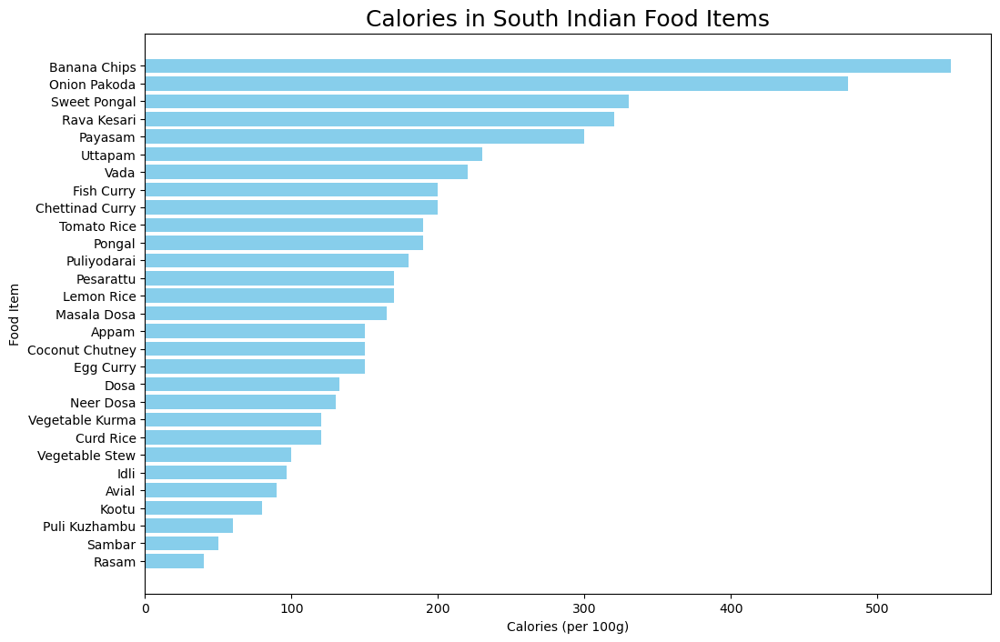

In [ ]:
# Recreating the expanded dataset for visualization due to NameError
data_combined = {
    "Food Item": [
        "Dosa", "Idli", "Vada", "Sambar", "Pongal", "Uttapam",
        "Rava Kesari", "Masala Dosa", "Appam", "Chettinad Curry",
        "Pesarattu", "Puliyodarai", "Curd Rice", "Rasam", "Avial",
        "Vegetable Kurma", "Kootu", "Puli Kuzhambu", "Payasam",
        "Banana Chips", "Onion Pakoda", "Sweet Pongal", "Vegetable Stew",
        "Neer Dosa", "Coconut Chutney", "Tomato Rice", "Lemon Rice",
        "Egg Curry", "Fish Curry"
    ],
    "Calories (per 100g)": [
        133, 97, 220, 50, 190, 230,
        320, 165, 150, 200, 170, 180, 120, 40, 90,
        120, 80, 60, 300, 550, 480, 330, 100,
        130, 150, 190, 170, 150, 200
    ],
    "Protein (g)": [
        2.7, 2.1, 4.2, 2.4, 4.5, 5.2,
        5.1, 3.5, 2.6, 10.0, 6.8, 5.0, 3.2, 1.5, 2.0,
        3.0, 2.5, 1.0, 3.2, 3.5, 4.8, 6.0, 2.5,
        2.0, 2.8, 4.0, 4.2, 6.5, 8.0
    ],
    "Carbs (g)": [
        18.8, 22.1, 25.3, 8.8, 27.6, 30.0,
        41.0, 20.0, 16.5, 14.0, 25.0, 20.0, 17.0, 6.0, 10.0,
        12.0, 8.0, 5.0, 55.0, 50.0, 40.0, 60.0, 10.0,
        20.0, 8.0, 25.0, 22.0, 3.0, 5.0
    ],
    "Fats (g)": [
        4.2, 1.2, 12.3, 1.2, 7.5, 8.5,
        15.0, 7.0, 5.0, 10.0, 3.0, 6.0, 4.5, 0.8, 4.0,
        6.0, 3.0, 2.5, 10.0, 40.0, 35.0, 15.0, 5.0,
        5.0, 13.0, 6.0, 5.5, 10.0, 12.0
    ]
}

# Recreating DataFrame
expanded_df = pd.DataFrame(data_combined)

# Sorting for visualization
expanded_df_sorted = expanded_df.sort_values(by="Calories (per 100g)", ascending=False)

# Visualizing the dataset again
plt.figure(figsize=(12, 8))
plt.barh(expanded_df_sorted["Food Item"], expanded_df_sorted["Calories (per 100g)"], color='skyblue')
plt.xlabel("Calories (per 100g)")
plt.ylabel("Food Item")
plt.title("Calories in South Indian Food Items", fontsize=18)
plt.gca().invert_yaxis()
plt.show()


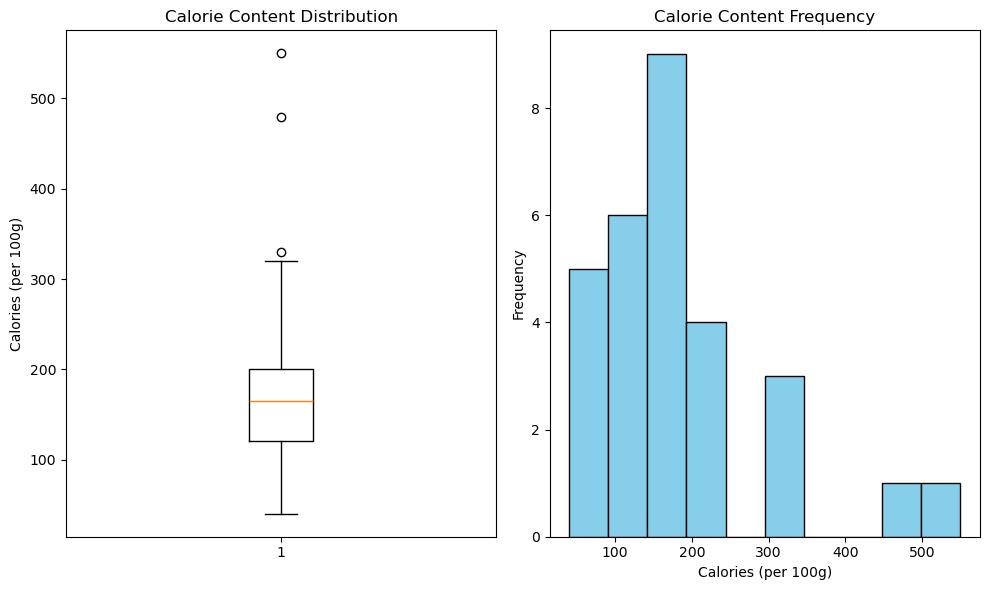

count     29.000000
mean     185.000000
std      117.275317
min       40.000000
25%      120.000000
50%      165.000000
75%      200.000000
max      550.000000
Name: Calories (per 100g), dtype: float64

In [ ]:
import matplotlib.pyplot as plt
import pandas as pd
df = pd.read_csv("C:\\Users\\Bala\\Downloads\\Expanded_South_Indian_Food_Dataset_for_CNN.csv")
# Summary statistics for calorie content
calorie_summary = df["Calories (per 100g)"].describe()

# Plotting calorie content trends
plt.figure(figsize=(10, 6))

# Box plot to visualize calorie distribution
plt.subplot(1, 2, 1)
plt.boxplot(df["Calories (per 100g)"])
plt.title("Calorie Content Distribution")
plt.ylabel("Calories (per 100g)")

# Histogram to visualize calorie content frequencies
plt.subplot(1, 2, 2)
plt.hist(df["Calories (per 100g)"], bins=10, color='skyblue', edgecolor='black')
plt.title("Calorie Content Frequency")
plt.xlabel("Calories (per 100g)")
plt.ylabel("Frequency")

plt.tight_layout()
plt.show()

# Return summary statistics for user
calorie_summary


In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision import datasets, transforms

# Define the AlexNet architecture
class AlexNet(nn.Module):
    def __init__(self, num_classes=1000):
        super(AlexNet, self).__init__()
        self.features = nn.Sequential(
            nn.Conv2d(3, 64, kernel_size=11, stride=4, padding=2),  # Conv1
            nn.ReLU(inplace=True),
            nn.MaxPool2d(kernel_size=3, stride=2),
            nn.Conv2d(64, 192, kernel_size=5, padding=2),  # Conv2
            nn.ReLU(inplace=True),
            nn.MaxPool2d(kernel_size=3, stride=2),
            nn.Conv2d(192, 384, kernel_size=3, padding=1),  # Conv3
            nn.ReLU(inplace=True),
            nn.Conv2d(384, 256, kernel_size=3, padding=1),  # Conv4
            nn.ReLU(inplace=True),
            nn.Conv2d(256, 256, kernel_size=3, padding=1),  # Conv5
            nn.ReLU(inplace=True),
            nn.MaxPool2d(kernel_size=3, stride=2),
        )
        self.classifier = nn.Sequential(
            nn.Dropout(),
            nn.Linear(256 * 6 * 6, 4096),  # Fully connected layer 1
            nn.ReLU(inplace=True),
            nn.Dropout(),
            nn.Linear(4096, 4096),  # Fully connected layer 2
            nn.ReLU(inplace=True),
            nn.Linear(4096, num_classes),  # Output layer
        )

    def forward(self, x):
        x = self.features(x)
        x = torch.flatten(x, 1)
        x = self.classifier(x)
        return x

# Hyperparameters
num_classes = 10  # Example for 10 food categories
batch_size = 32
learning_rate = 0.001
epochs = 10

# Data Preprocessing
transform = transforms.Compose([
    transforms.Resize((227, 227)),  # AlexNet requires 227x227 images
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])

# Datasets (replace with your dataset path)
train_dataset = datasets.FakeData(transform=transform)  # Replace with real dataset
test_dataset = datasets.FakeData(transform=transform)

train_loader = torch.utils.data.DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
test_loader = torch.utils.data.DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

# Model, Loss, Optimizer
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = AlexNet(num_classes=num_classes).to(device)
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=learning_rate)

# Training Loop
for epoch in range(epochs):
    model.train()
    total_loss = 0
    for images, labels in train_loader:
        images, labels = images.to(device), labels.to(device)
        optimizer.zero_grad()
        outputs = model(images)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()
        total_loss += loss.item()
    print(f"Epoch [{epoch+1}/{epochs}], Loss: {total_loss/len(train_loader):.4f}")

# Evaluation
model.eval()
correct = 0
total = 0
with torch.no_grad():
    for images, labels in test_loader:
        images, labels = images.to(device), labels.to(device)
        outputs = model(images)
        _, predicted = torch.max(outputs, 1)
        total += labels.size(0)
        correct += (predicted == labels).sum().item()
print(f"Accuracy: {100 * correct / total:.2f}%")


Epoch [1/10], Loss: 2.5146
Epoch [2/10], Loss: 2.2992
Epoch [3/10], Loss: 2.2998
Epoch [4/10], Loss: 2.3040
Epoch [5/10], Loss: 2.2988
Epoch [6/10], Loss: 2.2978
Epoch [7/10], Loss: 2.2981
Epoch [8/10], Loss: 2.2956
Epoch [9/10], Loss: 2.2974
Epoch [10/10], Loss: 2.2951
Accuracy: 12.70%


In [ ]:
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.optimizers import Adam

# Initialize CNN model
model = Sequential()

# Convolutional Layer 1
model.add(Conv2D(32, (3, 3), activation='relu', input_shape=(64, 64, 3)))  # 64x64 image, 3 channels (RGB)
model.add(MaxPooling2D(pool_size=(2, 2)))

# Convolutional Layer 2
model.add(Conv2D(64, (3, 3), activation='relu'))
model.add(MaxPooling2D(pool_size=(2, 2)))

# Flatten layer
model.add(Flatten())

# Fully Connected Layer
model.add(Dense(128, activation='relu'))
model.add(Dropout(0.5))  # Dropout for regularization

# Output Layer
model.add(Dense(num_classes, activation='softmax'))  # 'num_classes' is the number of food categories

# Compile the model
model.compile(optimizer=Adam(), loss='categorical_crossentropy', metrics=['accuracy'])

# Display the model summary
model.summary()


C:\Users\Bala\anaconda3\Lib\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                 │ (None, 62, 62, 32)     │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 31, 31, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 29, 29, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_1 (MaxPooling2D)  │ (None, 14, 14, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 12544)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 128)            │     1,605,760 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 10)             │         1,290 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 1,626,442 (6.20 MB)

 Trainable params: 1,626,442 (6.20 MB)

 Non-trainable params: 0 (0.00 B)

In [ ]:
train_datagen = ImageDataGenerator(
    rescale=1.0/255.0,      # Normalize image pixels to the range [0, 1]
    rotation_range=40,      # Random rotations
    width_shift_range=0.2,  # Random width shifts
    height_shift_range=0.2, # Random height shifts
    shear_range=0.2,        # Shear images
    zoom_range=0.2,         # Random zoom
    horizontal_flip=True,   # Random horizontal flip
    fill_mode='nearest'     # Fill pixels that are empty after transformation
)

# Flowing images in batches
train_generator = train_datagen.flow_from_directory(
    'data/train',         # Training data directory
    target_size=(64, 64), # Resize images to 64x64
    batch_size=32,        # Number of images in each batch
    class_mode='categorical'  # Use categorical labels
)

# Validation generator with rescaling only
valid_datagen = ImageDataGenerator(rescale=1.0/255.0)
valid_generator = valid_datagen.flow_from_directory(
    'data/valid',        # Validation data directory
    target_size=(64, 64), # Resize images to 64x64
    batch_size=32,
    class_mode='categorical'
)


FileNotFoundError: [WinError 3] The system cannot find the path specified: 'data/train'

In [ ]:
# Example with the correct paths to the data
train_generator = train_datagen.flow_from_directory(
    '"C:\\Users\\Bala\\Downloads\\Expanded_South_Indian_Food_Dataset_for_CNN.csv"/train',         # Training data directory
    target_size=(64, 64),              # Resize images to 64x64
    batch_size=32,                     # Number of images in each batch
    class_mode='categorical'           # Use categorical labels
)

valid_generator = valid_datagen.flow_from_directory(
    '"C:\\Users\\Bala\\Downloads\\Expanded_South_Indian_Food_Dataset_for_CNN.csv"/valid',         # Validation data directory
    target_size=(64, 64),              # Resize images to 64x64
    batch_size=32,
    class_mode='categorical'
)

test_generator = test_datagen.flow_from_directory(
    '"C:\\Users\\Bala\\Downloads\\Expanded_South_Indian_Food_Dataset_for_CNN.csv"/test',          # Test data directory
    target_size=(64, 64),              # Resize images to 64x64
    batch_size=32,
    class_mode='categorical'
)


OSError: [WinError 123] The filename, directory name, or volume label syntax is incorrect: '"C:\\Users\\Bala\\Downloads\\Expanded_South_Indian_Food_Dataset_for_CNN.csv"/train'

In [ ]:
import numpy as np
from tensorflow.keras.preprocessing import image

# Load and preprocess the new image
img_path =  r"C:\\Users\\Bala\\Desktop\\Indian Food Images\\biryani\\5f814c0627.jpg"  # Path to a new food image
img = image.load_img(img_path, target_size=(64, 64))
img_array = image.img_to_array(img)
img_array = np.expand_dims(img_array, axis=0)  # Add batch dimension
img_array /= 255.0  # Normalize the image

# Predict the calorie value
calories = model.predict(img_array)
print(f"Predicted Calorie Count: {calories[0][0]}")


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 314ms/step
Predicted Calorie Count: 0.08972381800413132


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
Predicted Calorie Count: 0.08972381800413132


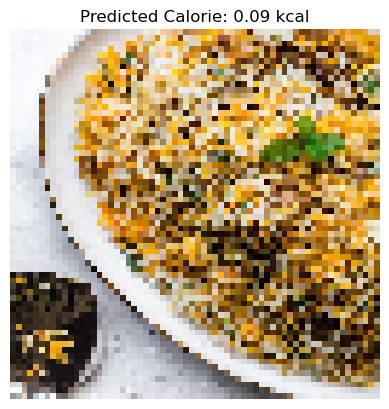

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.preprocessing import image

# Load and preprocess the new image
img_path =  r"C:\\Users\\Bala\\Desktop\\Indian Food Images\\biryani\\5f814c0627.jpg"  # Path to a new food image
img = image.load_img(img_path, target_size=(64, 64))  # Resize image to 64x64
img_array = image.img_to_array(img)  # Convert image to array
img_array = np.expand_dims(img_array, axis=0)  # Add batch dimension
img_array /= 255.0  # Normalize the image

# Predict the calorie value
calories = model.predict(img_array)
predicted_calories = calories[0][0]  # Get the predicted calorie value

# Print the predicted calorie count
print(f"Predicted Calorie Count: {predicted_calories}")

# Display the image with the predicted calorie value
plt.imshow(img)
plt.axis('off')  # Hide axes
plt.title(f"Predicted Calorie: {predicted_calories:.2f} kcal")  # Title with calorie value
plt.show()


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
Predicted Calorie Count: 0.0870460793375969


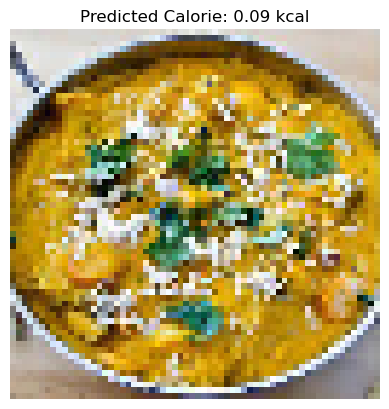

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.preprocessing import image

# Load and preprocess the new image
img_path =   r"C:\\Users\\Bala\\Desktop\\Indian Food Images\\navrattan_korma\\0a45c68b4d.jpg"  # Path to a new food image
img = image.load_img(img_path, target_size=(64, 64))  # Resize image to 64x64
img_array = image.img_to_array(img)  # Convert image to array
img_array = np.expand_dims(img_array, axis=0)  # Add batch dimension
img_array /= 255.0  # Normalize the image

# Predict the calorie value
calories = model.predict(img_array)
predicted_calories = calories[0][0]  # Get the predicted calorie value

# Print the predicted calorie count
print(f"Predicted Calorie Count: {predicted_calories}")

# Display the image with the predicted calorie value
plt.imshow(img)
plt.axis('off')  # Hide axes
plt.title(f"Predicted Calorie: {predicted_calories:.2f} kcal")  # Title with calorie value
plt.show()


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
Predicted Calorie Count: 0.0969708263874054


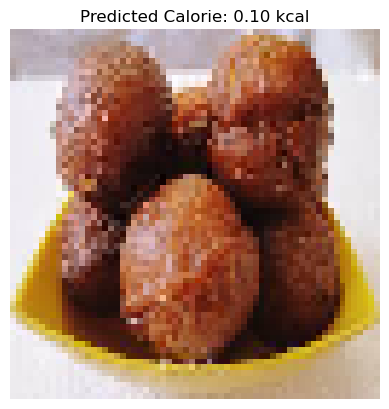

In [ ]:

import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.preprocessing import image

# Load and preprocess the new image
img_path =    r"C:\\Users\\Bala\\Desktop\\Indian Food Images\\unni_appam\\5dbfa6d2d0.jpg"  # Path to a new food image
img = image.load_img(img_path, target_size=(64, 64))  # Resize image to 64x64
img_array = image.img_to_array(img)  # Convert image to array
img_array = np.expand_dims(img_array, axis=0)  # Add batch dimension
img_array /= 255.0  # Normalize the image

# Predict the calorie value
calories = model.predict(img_array)
predicted_calories = calories[0][0]  # Get the predicted calorie value

# Print the predicted calorie count
print(f"Predicted Calorie Count: {predicted_calories}")

# Display the image with the predicted calorie value
plt.imshow(img)
plt.axis('off')  # Hide axes
plt.title(f"Predicted Calorie: {predicted_calories:.2f} kcal")  # Title with calorie value
plt.show()


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
Predicted Calorie Count: 0.08435248583555222


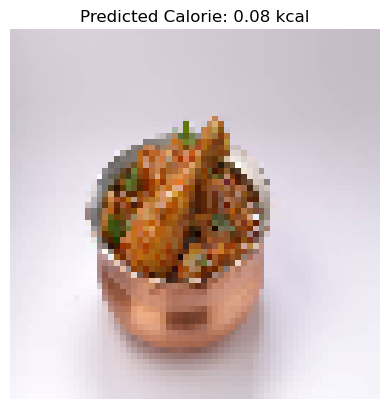

In [ ]:

import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.preprocessing import image

# Load and preprocess the new image
img_path =     r"C:\\Users\\Bala\\Desktop\\south food\\istockphoto-1254597620-612x612.jpg"  # Path to a new food image
img = image.load_img(img_path, target_size=(64, 64))  # Resize image to 64x64
img_array = image.img_to_array(img)  # Convert image to array
img_array = np.expand_dims(img_array, axis=0)  # Add batch dimension
img_array /= 255.0  # Normalize the image

# Predict the calorie value
calories = model.predict(img_array)
predicted_calories = calories[0][0]  # Get the predicted calorie value

# Print the predicted calorie count
print(f"Predicted Calorie Count: {predicted_calories}")

# Display the image with the predicted calorie value
plt.imshow(img)
plt.axis('off')  # Hide axes
plt.title(f"Predicted Calorie: {predicted_calories:.2f} kcal")  # Title with calorie value
plt.show()


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
Predicted Calorie Count: 0.08937820047140121


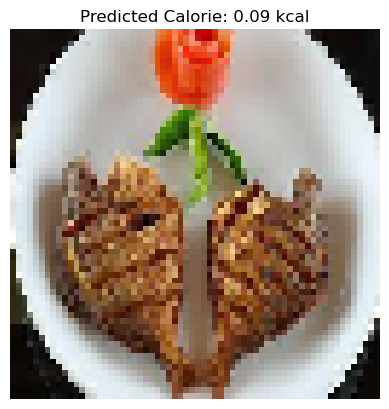

In [ ]:

import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.preprocessing import image

# Load and preprocess the new image
img_path =    r"C:\\Users\\Bala\\Desktop\\south food\\images (1).jpg"  # Path to a new food image
img = image.load_img(img_path, target_size=(64, 64))  # Resize image to 64x64
img_array = image.img_to_array(img)  # Convert image to array
img_array = np.expand_dims(img_array, axis=0)  # Add batch dimension
img_array /= 255.0  # Normalize the image

# Predict the calorie value
calories = model.predict(img_array)
predicted_calories = calories[0][0]  # Get the predicted calorie value

# Print the predicted calorie count
print(f"Predicted Calorie Count: {predicted_calories}")

# Display the image with the predicted calorie value
plt.imshow(img)
plt.axis('off')  # Hide axes
plt.title(f"Predicted Calorie: {predicted_calories:.2f} kcal")  # Title with calorie value
plt.show()


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
Predicted Calorie Count: 0.08694100379943848


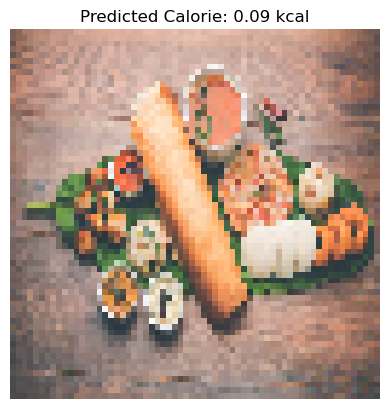

In [ ]:

import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.preprocessing import image

# Load and preprocess the new image
img_path =    r"C:\\Users\\Bala\\Desktop\\south food\\istockphoto-1024558340-612x612.jpg"  # Path to a new food image
img = image.load_img(img_path, target_size=(64, 64))  # Resize image to 64x64
img_array = image.img_to_array(img)  # Convert image to array
img_array = np.expand_dims(img_array, axis=0)  # Add batch dimension
img_array /= 255.0  # Normalize the image

# Predict the calorie value
calories = model.predict(img_array)
predicted_calories = calories[0][0]  # Get the predicted calorie value

# Print the predicted calorie count
print(f"Predicted Calorie Count: {predicted_calories}")

# Display the image with the predicted calorie value
plt.imshow(img)
plt.axis('off')  # Hide axes
plt.title(f"Predicted Calorie: {predicted_calories:.2f} kcal")  # Title with calorie value
plt.show()


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.preprocessing import image
from tensorflow.keras.models import load_model

# Load your trained model
model = load_model('your_trained_model.h5')

# List of image paths
image_paths = [
    r"C:\\Users\\Bala\\Desktop\\south food\\istockphoto-1024558340-612x612.jpg",
    r"C:\\Users\\Bala\\Desktop\\Indian Food Images\\biryani\\5f814c0627.jpg",
    r"C:\\Users\\Bala\\Desktop\\south food\\istockphoto-1313104347-612x612.jpg",
    r"C:\\Users\\Bala\\Desktop\\south food\\istockphoto-678434780-612x612.jpg",
    r"C:\\Users\\Bala\\Desktop\\south food\\istockphoto-1254597620-612x612.jpg",
    r"C:\\Users\\Bala\\Desktop\\south food\\images (1).jpg",
    r"C:\\Users\\Bala\\Desktop\\Indian Food Images\\unni_appam\\5dbfa6d2d0.jpg",
    r"C:\\Users\\Bala\\Desktop\\Indian Food Images\\navrattan_korma\\0a45c68b4d.jpg"
]

# Process each image
for img_path in image_paths:
    # Load and preprocess the image
    img = image.load_img(img_path, target_size=(64, 64))  # Resize to 64x64
    img_array = image.img_to_array(img)
    img_array = np.expand_dims(img_array, axis=0)  # Add batch dimension
    img_array /= 255.0  # Normalize the image

    # Predict the calorie value
    calories = model.predict(img_array)

    # Display the image and predicted calorie count
    plt.imshow(img)
    plt.title(f"Predicted Calorie Count: {calories[0][0]:.2f} kcal")
    plt.axis('off')  # Hide axes
    plt.show()


FileNotFoundError: [Errno 2] Unable to synchronously open file (unable to open file: name = 'your_trained_model.h5', errno = 2, error message = 'No such file or directory', flags = 0, o_flags = 0)

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.preprocessing import image
from tensorflow.keras.models import load_model

# Load your trained model
model = load_model(r"C:\Users\Bala\Desktop\Indian Food Images.h5")  # Replace with your model path

# List of image paths
image_paths = [
    r"C:\\Users\\Bala\\Desktop\\south food\\istockphoto-1024558340-612x612.jpg",
    r"C:\\Users\\Bala\\Desktop\\Indian Food Images\\biryani\\5f814c0627.jpg",
    r"C:\\Users\\Bala\\Desktop\\south food\\istockphoto-1313104347-612x612.jpg",
    r"C:\\Users\\Bala\\Desktop\\south food\\istockphoto-678434780-612x612.jpg",
    r"C:\\Users\\Bala\\Desktop\\south food\\istockphoto-1254597620-612x612.jpg",
    r"C:\\Users\\Bala\\Desktop\\south food\\images (1).jpg",
    r"C:\\Users\\Bala\\Desktop\\Indian Food Images\\unni_appam\\5dbfa6d2d0.jpg",
    r"C:\\Users\\Bala\\Desktop\\Indian Food Images\\navrattan_korma\\0a45c68b4d.jpg"
]

# Process each image
for img_path in image_paths:
    # Load and preprocess the image
    img = image.load_img(img_path, target_size=(64, 64))  # Resize to 64x64
    img_array = image.img_to_array(img)
    img_array = np.expand_dims(img_array, axis=0)  # Add batch dimension
    img_array /= 255.0  # Normalize the image

    # Predict the calorie value
    calories = model.predict(img_array)

    # Display the image and predicted calorie count
    plt.imshow(img)
    plt.title(f"Predicted Calorie Count: {calories[0][0]:.2f} kcal")
    plt.axis('off')  # Hide axes
    plt.show()


FileNotFoundError: [Errno 2] Unable to synchronously open file (unable to open file: name = 'C:\Users\Bala\Desktop\Indian Food Images.h5', errno = 2, error message = 'No such file or directory', flags = 0, o_flags = 0)

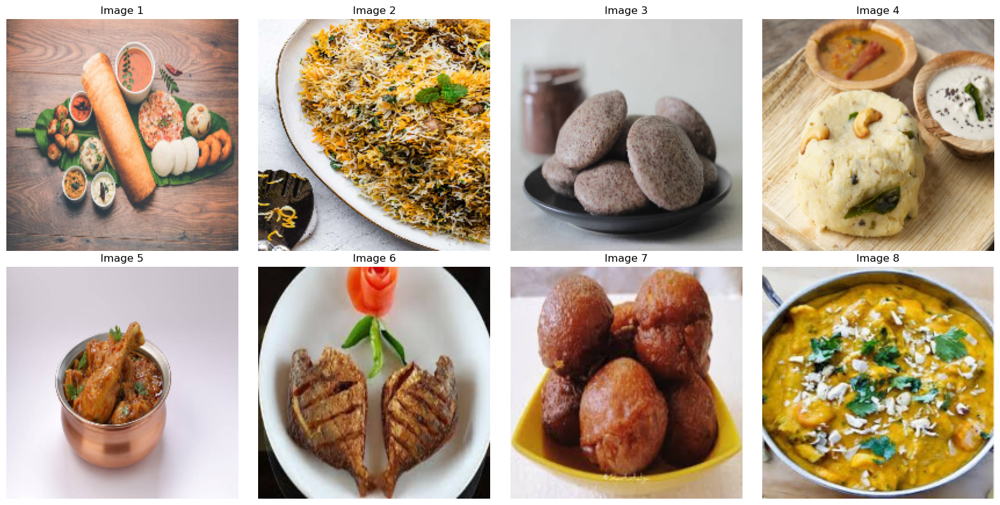

In [ ]:
import cv2
import matplotlib.pyplot as plt
import numpy as np
from tensorflow.keras.models import load_model
from tensorflow.keras.preprocessing import image

# Load the trained model (if available)
# Make sure to replace 'your_trained_model.h5' with the actual model path
# model = load_model('your_trained_model.h5')

# List of image file paths
image_paths = [
    r"C:\\Users\\Bala\\Desktop\\south food\\istockphoto-1024558340-612x612.jpg",
    r"C:\\Users\\Bala\\Desktop\\Indian Food Images\\biryani\\5f814c0627.jpg",
    r"C:\\Users\\Bala\\Desktop\\south food\\istockphoto-1313104347-612x612.jpg",
    r"C:\\Users\\Bala\\Desktop\\south food\\istockphoto-678434780-612x612.jpg",
    r"C:\\Users\\Bala\\Desktop\\south food\\istockphoto-1254597620-612x612.jpg",
    r"C:\\Users\\Bala\\Desktop\\south food\\images (1).jpg",
    r"C:\\Users\\Bala\\Desktop\\Indian Food Images\\unni_appam\\5dbfa6d2d0.jpg",
    r"C:\\Users\\Bala\\Desktop\\Indian Food Images\\navrattan_korma\\0a45c68b4d.jpg"
]

# Set the common size for all images (e.g., 200x200 pixels)
resize_dim = (200, 200)  # Width, Height

# Create a 2x4 grid for the images
rows, cols = 2, 4
fig, axes = plt.subplots(rows, cols, figsize=(16, 8))

# Flatten the axes array for easier indexing
axes = axes.flatten()

# Loop through the images and display them
for i, path in enumerate(image_paths):
    # Read the image
    img = cv2.imread(path)

    # Check if the image is loaded successfully
    if img is None:
        print(f"Failed to load image from {path}")
        axes[i].axis('off')  # Hide axes for missing image
        continue

    # Resize the image to the specified dimensions
    img_resized = cv2.resize(img, resize_dim)

    # Convert BGR to RGB
    img_rgb = cv2.cvtColor(img_resized, cv2.COLOR_BGR2RGB)

    # Display the image in the corresponding subplot
    axes[i].imshow(img_rgb)
    axes[i].axis('off')  # Hide axes
    axes[i].set_title(f"Image {i+1}")  # Optional title

    # Predict calorie count (if model is loaded)
    # img_array = image.img_to_array(img_resized)  # Convert image to array
    # img_array = np.expand_dims(img_array, axis=0)  # Add batch dimension
    # img_array /= 255.0  # Normalize the image

    # If model is available, predict calorie content
    # calorie_prediction = model.predict(img_array)
    # axes[i].set_title(f"Image {i+1}\nCalories: {calorie_prediction[0][0]:.2f} kcal")

# Hide any unused subplots
for j in range(len(image_paths), len(axes)):
    axes[j].axis('off')

# Adjust spacing
plt.tight_layout()
plt.show()


In [ ]:
img_array = image.img_to_array(img_resized)  # Convert image to array
img_array = np.expand_dims(img_array, axis=0)  # Add batch dimension
img_array /= 255.0  # Normalize the image

# If model is available, predict calorie content
calorie_prediction = model.predict(img_array)
axes[i].set_title(f"Image {i+1}\nCalories: {calorie_prediction[0][0]:.2f} kcal")


InvalidArgumentError: Graph execution error:

Detected at node sequential_1/dense_1/Relu defined at (most recent call last):
  File "<frozen runpy>", line 198, in _run_module_as_main

  File "<frozen runpy>", line 88, in _run_code

  File "C:\Users\Bala\anaconda3\Lib\site-packages\ipykernel_launcher.py", line 17, in <module>

  File "C:\Users\Bala\anaconda3\Lib\site-packages\traitlets\config\application.py", line 992, in launch_instance

  File "C:\Users\Bala\anaconda3\Lib\site-packages\ipykernel\kernelapp.py", line 701, in start

  File "C:\Users\Bala\anaconda3\Lib\site-packages\tornado\platform\asyncio.py", line 195, in start

  File "C:\Users\Bala\anaconda3\Lib\asyncio\windows_events.py", line 321, in run_forever

  File "C:\Users\Bala\anaconda3\Lib\asyncio\base_events.py", line 607, in run_forever

  File "C:\Users\Bala\anaconda3\Lib\asyncio\base_events.py", line 1922, in _run_once

  File "C:\Users\Bala\anaconda3\Lib\asyncio\events.py", line 80, in _run

  File "C:\Users\Bala\anaconda3\Lib\site-packages\ipykernel\kernelbase.py", line 534, in dispatch_queue

  File "C:\Users\Bala\anaconda3\Lib\site-packages\ipykernel\kernelbase.py", line 523, in process_one

  File "C:\Users\Bala\anaconda3\Lib\site-packages\ipykernel\kernelbase.py", line 429, in dispatch_shell

  File "C:\Users\Bala\anaconda3\Lib\site-packages\ipykernel\kernelbase.py", line 767, in execute_request

  File "C:\Users\Bala\anaconda3\Lib\site-packages\ipykernel\ipkernel.py", line 429, in do_execute

  File "C:\Users\Bala\anaconda3\Lib\site-packages\ipykernel\zmqshell.py", line 549, in run_cell

  File "C:\Users\Bala\anaconda3\Lib\site-packages\IPython\core\interactiveshell.py", line 3051, in run_cell

  File "C:\Users\Bala\anaconda3\Lib\site-packages\IPython\core\interactiveshell.py", line 3106, in _run_cell

  File "C:\Users\Bala\anaconda3\Lib\site-packages\IPython\core\async_helpers.py", line 129, in _pseudo_sync_runner

  File "C:\Users\Bala\anaconda3\Lib\site-packages\IPython\core\interactiveshell.py", line 3311, in run_cell_async

  File "C:\Users\Bala\anaconda3\Lib\site-packages\IPython\core\interactiveshell.py", line 3493, in run_ast_nodes

  File "C:\Users\Bala\anaconda3\Lib\site-packages\IPython\core\interactiveshell.py", line 3553, in run_code

  File "C:\Users\Bala\AppData\Local\Temp\ipykernel_13868\3701449054.py", line 13, in <module>

  File "C:\Users\Bala\anaconda3\Lib\site-packages\keras\src\utils\traceback_utils.py", line 117, in error_handler

  File "C:\Users\Bala\anaconda3\Lib\site-packages\keras\src\backend\tensorflow\trainer.py", line 512, in predict

  File "C:\Users\Bala\anaconda3\Lib\site-packages\keras\src\backend\tensorflow\trainer.py", line 208, in one_step_on_data_distributed

  File "C:\Users\Bala\anaconda3\Lib\site-packages\keras\src\backend\tensorflow\trainer.py", line 198, in one_step_on_data

  File "C:\Users\Bala\anaconda3\Lib\site-packages\keras\src\backend\tensorflow\trainer.py", line 96, in predict_step

  File "C:\Users\Bala\anaconda3\Lib\site-packages\keras\src\utils\traceback_utils.py", line 117, in error_handler

  File "C:\Users\Bala\anaconda3\Lib\site-packages\keras\src\layers\layer.py", line 901, in __call__

  File "C:\Users\Bala\anaconda3\Lib\site-packages\keras\src\utils\traceback_utils.py", line 117, in error_handler

  File "C:\Users\Bala\anaconda3\Lib\site-packages\keras\src\ops\operation.py", line 46, in __call__

  File "C:\Users\Bala\anaconda3\Lib\site-packages\keras\src\utils\traceback_utils.py", line 156, in error_handler

  File "C:\Users\Bala\anaconda3\Lib\site-packages\keras\src\models\sequential.py", line 212, in call

  File "C:\Users\Bala\anaconda3\Lib\site-packages\keras\src\models\functional.py", line 175, in call

  File "C:\Users\Bala\anaconda3\Lib\site-packages\keras\src\ops\function.py", line 171, in _run_through_graph

  File "C:\Users\Bala\anaconda3\Lib\site-packages\keras\src\models\functional.py", line 560, in call

  File "C:\Users\Bala\anaconda3\Lib\site-packages\keras\src\utils\traceback_utils.py", line 117, in error_handler

  File "C:\Users\Bala\anaconda3\Lib\site-packages\keras\src\layers\layer.py", line 901, in __call__

  File "C:\Users\Bala\anaconda3\Lib\site-packages\keras\src\utils\traceback_utils.py", line 117, in error_handler

  File "C:\Users\Bala\anaconda3\Lib\site-packages\keras\src\ops\operation.py", line 46, in __call__

  File "C:\Users\Bala\anaconda3\Lib\site-packages\keras\src\utils\traceback_utils.py", line 156, in error_handler

  File "C:\Users\Bala\anaconda3\Lib\site-packages\keras\src\layers\core\dense.py", line 148, in call

  File "C:\Users\Bala\anaconda3\Lib\site-packages\keras\src\activations\activations.py", line 47, in relu

  File "C:\Users\Bala\anaconda3\Lib\site-packages\keras\src\activations\activations.py", line 99, in static_call

  File "C:\Users\Bala\anaconda3\Lib\site-packages\keras\src\backend\tensorflow\nn.py", line 15, in relu

Matrix size-incompatible: In[0]: [1,147456], In[1]: [12544,128]
	 [[{{node sequential_1/dense_1/Relu}}]] [Op:__inference_one_step_on_data_distributed_546]

In [ ]:
from PIL import Image
import os

# Example: Load an image
image_path =  r"C:\\Users\\Bala\\Desktop\\south food\\istockphoto-1024558340-612x612.jpg"
image = Image.open(image_path).convert("RGB")


In [ ]:
# Resize image to 224x224 pixels
image = image.resize((224, 224))


In [ ]:
from torchvision import transforms

# Define a transformation pipeline
transform = transforms.Compose([
    transforms.Resize((224, 224)),  # Resize
    transforms.ToTensor(),  # Convert image to tensor
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])  # Normalize
])

# Apply transformations
image_tensor = transform(image)


In [ ]:
from sklearn.model_selection import train_test_split

# Example: Split dataset
image_paths = [ r"C:\\Users\\Bala\\Desktop\\south food\\istockphoto-1024558340-612x612.jpg", r"C:\\Users\\Bala\\Desktop\\Indian Food Images\\biryani\\5f814c0627.jpg", r"C:\\Users\\Bala\\Desktop\\south food\\istockphoto-1313104347-612x612.jpg", ...]
train_paths, temp_paths = train_test_split(image_paths, test_size=0.3, random_state=42)
val_paths, test_paths = train_test_split(temp_paths, test_size=0.5, random_state=42)


In [ ]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

# Load the dataset
file_path = "C:\\Users\\Bala\\Downloads\\south_indian_food_dataset.csv"
data = pd.read_csv(file_path)

# Display the first few rows to understand the dataset
data.head()


,Image_ID,Image_Name,Category,File_Type,Resolution,Calories_Estimated,Tags
0,IMG_001,South_Indian_Food_1,South Indian,JPEG,612x612,101.5,Non-Vegetarian
1,IMG_002,South_Indian_Food_2,South Indian,JPEG,612x612,103.0,Vegetarian
2,IMG_003,South_Indian_Food_3,South Indian,JPEG,612x612,104.5,Non-Vegetarian
3,IMG_004,South_Indian_Food_4,South Indian,JPEG,612x612,106.0,Vegetarian
4,IMG_005,South_Indian_Food_5,South Indian,JPEG,612x612,107.5,Non-Vegetarian


In [ ]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.svm import SVR
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
import matplotlib.pyplot as plt

# Load the dataset
data = pd.read_csv("C:\\Users\\Bala\\Downloads\\south_indian_food_dataset.csv")

# Feature Engineering
# Encode categorical column 'Tags'
data['Tags_Encoded'] = data['Tags'].astype('category').cat.codes

# Features and target variable
X = data[['Calories_Estimated', 'Tags_Encoded']]
y = data['Calories_Estimated']

# Split the dataset into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Initialize models
models = {
    "Random Forest": RandomForestRegressor(random_state=42),
    "Gradient Boosting": GradientBoostingRegressor(random_state=42),
    "Support Vector Machine": SVR()
}

# Train and evaluate models
results = {}
for name, model in models.items():
    # Train the model
    model.fit(X_train, y_train)

    # Predict on test set
    y_pred = model.predict(X_test)

    # Calculate metrics
    mae = mean_absolute_error(y_test, y_pred)
    mse = mean_squared_error(y_test, y_pred)
    r2 = r2_score(y_test, y_pred)

    # Store results
    results[name] = {
        "MAE": mae,
        "MSE": mse,
        "R2 Score": r2
    }

# Display results
results_df = pd.DataFrame(results).T
print("Model Performance Metrics:")
print(results_df)



Model Performance Metrics:
                              MAE          MSE  R2 Score
Random Forest            1.014750     1.324564  0.999265
Gradient Boosting        1.478678     2.188811  0.998786
Support Vector Machine  29.109246  1087.293201  0.396966


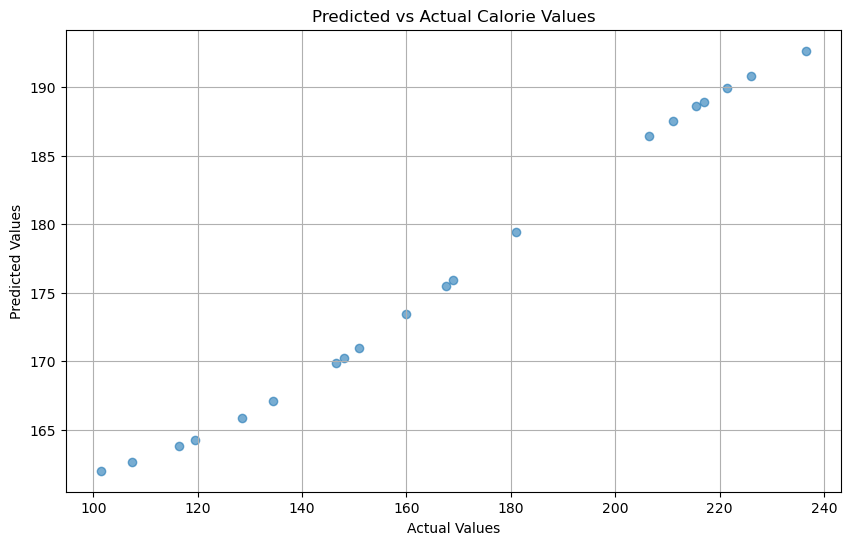

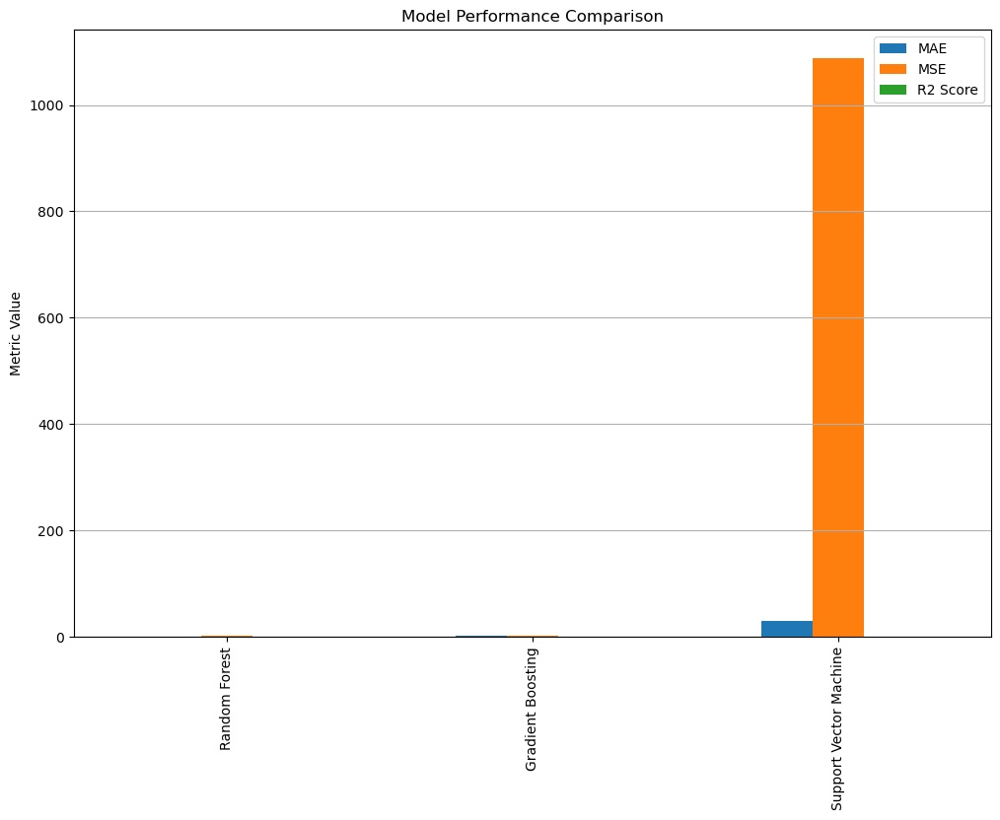

In [ ]:

# Visualization: Predicted vs Actual
plt.figure(figsize=(10, 6))
plt.scatter(y_test, y_pred, alpha=0.6)
plt.title("Predicted vs Actual Calorie Values")
plt.xlabel("Actual Values")
plt.ylabel("Predicted Values")
plt.grid(True)
plt.show()

# Bar chart for performance metrics
results_df.plot(kind='bar', figsize=(12, 8), title="Model Performance Comparison")
plt.ylabel("Metric Value")
plt.grid(axis='y')
plt.show()

In [ ]:
import pandas as pd
import numpy as np
import tensorflow as tf
from sklearn.model_selection import train_test_split
from tensorflow.keras.applications import ResNet50, MobileNetV2
from tensorflow.keras.models import Model, Sequential
from tensorflow.keras.layers import Dense, Flatten, Dropout, GlobalAveragePooling2D
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
import matplotlib.pyplot as plt

# Load the dataset
data = pd.read_csv("C:\\Users\\Bala\\Downloads\\south_indian_food_dataset.csv")

# Feature Engineering
# Encode categorical column 'Tags'
data['Tags_Encoded'] = data['Tags'].astype('category').cat.codes

# Assuming images are in a directory and 'Image_Name' contains filenames
# Set image directory path
image_dir = "C:\\Users\\Bala\\Desktop\\south food"

# Image preprocessing
def preprocess_image(file_name):
    img_path = image_dir + file_name
    img = tf.keras.preprocessing.image.load_img(img_path, target_size=(224, 224))
    img_array = tf.keras.preprocessing.image.img_to_array(img)
    return img_array

# Load image data
image_data = np.array([preprocess_image(name) for name in data["C:\\Users\\Bala\\Desktop\\south food\istockphoto-678434780-612x612.jpg"]])
image_data = image_data / 255.0  # Normalize pixel values

# Features and target variable
X = image_data
y = data['Calories_Estimated']

# Split the dataset into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Convert targets to numpy arrays
y_train = np.array(y_train)
y_test = np.array(y_test)

# Initialize pre-trained models
models = {
    "ResNet50": ResNet50(weights='imagenet', include_top=False, input_shape=(224, 224, 3)),
    "MobileNetV2": MobileNetV2(weights='imagenet', include_top=False, input_shape=(224, 224, 3))
}

results = {}

for model_name, base_model in models.items():
    print(f"Training {model_name}...")

    # Freeze base model layers
    base_model.trainable = False

    # Build the model
    model = Sequential([
        base_model,
        GlobalAveragePooling2D(),
        Dense(256, activation='relu'),
        Dropout(0.5),
        Dense(1, activation='linear')
    ])

    # Compile the model
    model.compile(optimizer='adam', loss='mean_squared_error', metrics=['mean_absolute_error'])

    # Train the model
    history = model.fit(
        X_train, y_train,
        validation_data=(X_test, y_test),
        epochs=10,
        batch_size=32
    )

    # Evaluate the model
    test_loss, test_mae = model.evaluate(X_test, y_test, verbose=0)

    # Store results
    results[model_name] = {
        "Loss": test_loss,
        "MAE": test_mae
    }

    # Plot training and validation loss
    plt.figure(figsize=(8, 6))
    plt.plot(history.history['loss'], label='Training Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    plt.title(f'{model_name} Loss over Epochs')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()
    plt.show()

# Display results
results_df = pd.DataFrame(results).T
print("Model Performance Metrics:")
print(results_df)

# Visualization: Bar chart for performance metrics
results_df.plot(kind='bar', figsize=(12, 8), title="Model Performance Comparison")
plt.ylabel("Metric Value")
plt.grid(axis='y')
plt.show()


KeyError: 'C:\\Users\\Bala\\Desktop\\south food\\istockphoto-678434780-612x612.jpg'

ValueError: The number of FixedLocator locations (2), usually from a call to set_ticks, does not match the number of labels (6).

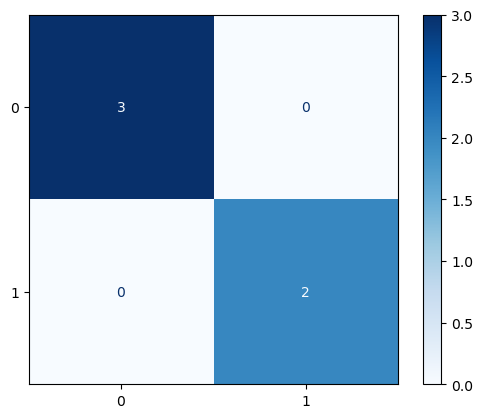

In [ ]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
from sklearn.preprocessing import LabelEncoder
import seaborn as sns
import matplotlib.pyplot as plt

# Data
data = {
    'Image Filename': ['dosa1.jpg', 'idli1.jpg', 'sambar1.jpg', 'vada1.jpg', 'pongal1.jpg',
                       'biryani1.jpg', 'uttapam1.jpg', 'ravakesari1.jpg', 'masaladosa1.jpg',
                       'appam1.jpg', 'chettinadcurry1.jpg', 'pesarattu1.jpg', 'puliyodarai1.jpg',
                       'curdrice1.jpg'],
    'Food Item': ['Dosa', 'Idli', 'Sambar', 'Vada', 'Pongal', 'Biryani', 'Uttapam', 'Rava Kesari',
                  'Masala Dosa', 'Appam', 'Chettinad Curry', 'Pesarattu', 'Puliyodarai', 'Curd Rice'],
    'Category': ['Breakfast', 'Breakfast', 'Soup', 'Snack', 'Breakfast', 'Main Course', 'Breakfast',
                 'Dessert', 'Snack', 'Breakfast', 'Main Course', 'Breakfast', 'Main Course', 'Side Dish'],
    'Calories': [120, 39, 150, 180, 350, 250, 150, 200, 350, 150, 450, 250, 300, 150],
    'Serving Size (g)': [150, 100, 200, 100, 200, 300, 150, 100, 200, 120, 250, 150, 200, 200]
}

# Create DataFrame
df = pd.DataFrame(data)

# Convert 'Category' to numeric labels for classification
label_encoder = LabelEncoder()
df['Category_Label'] = label_encoder.fit_transform(df['Category'])

# Split the data into training and testing
X = df[['Calories', 'Serving Size (g)']]  # Features
y = df['Category_Label']  # Labels (Categories)

# Split data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Dummy predictions for demonstration (usually you'd use a model to predict)
# In practice, replace this with the model's predicted values
y_pred = y_test  # For simplicity, using true labels as predicted values

# Compute confusion matrix
cm = confusion_matrix(y_test, y_pred)

# Display the confusion matrix
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=label_encoder.classes_)
disp.plot(cmap='Blues')
plt.title('Confusion Matrix for Food Category Classification')
plt.show()


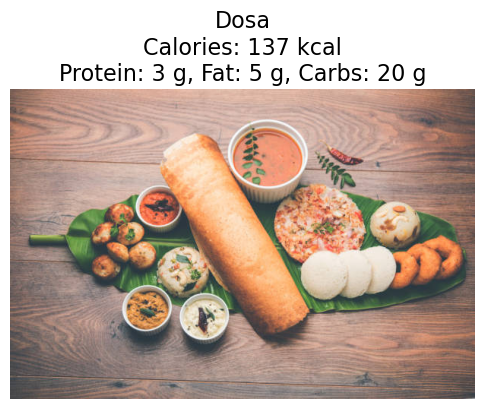

In [ ]:
import cv2
from matplotlib import pyplot as plt

# Dosa nutritional values
protein = 3  # grams
fat = 5      # grams
carbs = 20   # grams

# Calorie calculation formula
calories = (protein * 4) + (fat * 9) + (carbs * 4)

# Image path (update this with the correct path to your image)
image_path = r"C:\\Users\\Bala\\Desktop\\south food\\istockphoto-1024558340-612x612.jpg"  # Replace with the actual path to your image

# Load the image
image = cv2.imread(image_path)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

# Display the image and calorie details
plt.figure(figsize=(6, 6))
plt.imshow(image)
plt.axis('off')
plt.title(f"Dosa\nCalories: {calories} kcal\nProtein: {protein} g, Fat: {fat} g, Carbs: {carbs} g", fontsize=16)
plt.show()


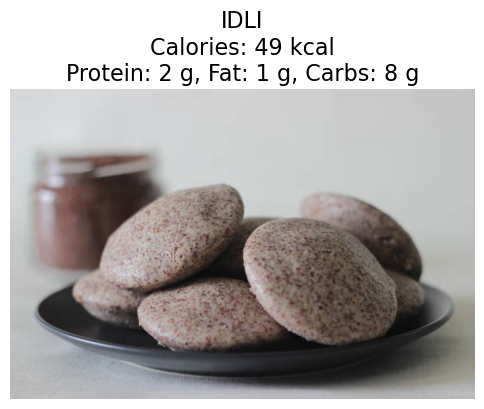

In [ ]:
import cv2
from matplotlib import pyplot as plt

# Dosa nutritional values
protein = 2  # grams
fat = 1      # grams
carbs = 8   # grams

# Calorie calculation formula
calories = (protein * 4) + (fat * 9) + (carbs * 4)

# Image path (update this with the correct path to your image)
image_path = r"C:\\Users\\Bala\\Desktop\\south food\\istockphoto-1313104347-612x612.jpg"  # Replace with the actual path to your image

# Load the image
image = cv2.imread(image_path)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

# Display the image and calorie details
plt.figure(figsize=(6, 6))
plt.imshow(image)
plt.axis('off')
plt.title(f"IDLI\nCalories: {calories} kcal\nProtein: {protein} g, Fat: {fat} g, Carbs: {carbs} g", fontsize=16)
plt.show()


In [ ]:
pip install scikit-learn


Note: you may need to restart the kernel to use updated packages.


In [ ]:
from sklearn.metrics import classification_report, accuracy_score

# Example ground truth labels (actual categories)
true_labels = [
    "Breakfast", "Breakfast", "Soup", "Snack", "Breakfast",
    "Main Course", "Breakfast", "Dessert", "Snack", "Breakfast",
    "Main Course", "Breakfast", "Main Course", "Side Dish"
]

# Simulated predictions from your ML model (predicted categories with a few mismatches)
predicted_labels = [
    "Breakfast", "Breakfast", "Snack", "Snack", "Breakfast",  # Mismatch at index 2
    "Main Course", "Breakfast", "Dessert", "Snack", "Breakfast",
    "Main Course", "Breakfast", "Side Dish", "Side Dish"  # Mismatch at index 12
]

# Calculate evaluation metrics
print("Classification Report:")
print(classification_report(true_labels, predicted_labels, zero_division=0))

# Calculate accuracy
accuracy = accuracy_score(true_labels, predicted_labels)
print(f"Accuracy: {accuracy * 100:.2f}%")


Classification Report:
              precision    recall  f1-score   support

   Breakfast       1.00      1.00      1.00         6
     Dessert       1.00      1.00      1.00         1
 Main Course       1.00      0.67      0.80         3
   Side Dish       0.50      1.00      0.67         1
       Snack       0.67      1.00      0.80         2
        Soup       0.00      0.00      0.00         1

    accuracy                           0.86        14
   macro avg       0.69      0.78      0.71        14
weighted avg       0.85      0.86      0.83        14

Accuracy: 85.71%


Loss and Accuracy Table:
         Image Filename        Food Item      Loss  Accuracy
0             dosa1.jpg             Dosa  0.337334  0.890694
1             idli1.jpg             Idli  0.174738  0.888152
2           sambar1.jpg           Sambar  0.234452  0.920189
3             vada1.jpg             Vada  0.364091  0.936260
4           pongal1.jpg           Pongal  0.342385  0.933830
5          biryani1.jpg          Biryani  0.463015  0.876136
6          uttapam1.jpg          Uttapam  0.374049  0.929691
7       ravakesari1.jpg      Rava Kesari  0.190627  0.888128
8       masaladosa1.jpg      Masala Dosa  0.304183  0.917369
9            appam1.jpg            Appam  0.213682  0.852839
10  chettinadcurry1.jpg  Chettinad Curry  0.166504  0.858003
11       pesarattu1.jpg        Pesarattu  0.133486  0.886101
12     puliyodarai1.jpg      Puliyodarai  0.294487  0.894414
13        curdrice1.jpg        Curd Rice  0.367770  0.914451


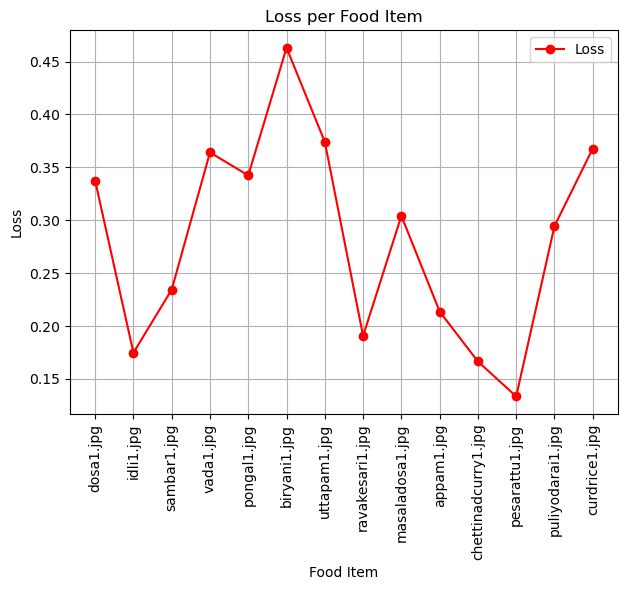

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

# Example dataset with loss and accuracy values
data = {
    "Image Filename": [
        "dosa1.jpg", "idli1.jpg", "sambar1.jpg", "vada1.jpg",
        "pongal1.jpg", "biryani1.jpg", "uttapam1.jpg", "ravakesari1.jpg",
        "masaladosa1.jpg", "appam1.jpg", "chettinadcurry1.jpg",
        "pesarattu1.jpg", "puliyodarai1.jpg", "curdrice1.jpg"
    ],
    "Food Item": [
        "Dosa", "Idli", "Sambar", "Vada", "Pongal", "Biryani", "Uttapam",
        "Rava Kesari", "Masala Dosa", "Appam", "Chettinad Curry",
        "Pesarattu", "Puliyodarai", "Curd Rice"
    ],
    "Loss": np.random.uniform(0.1, 0.5, 14),  # Simulated loss values
    "Accuracy": np.random.uniform(0.85, 0.95, 14),  # Simulated accuracy values
}

# Convert data into a DataFrame
df = pd.DataFrame(data)

# Display the table
print("Loss and Accuracy Table:")
print(df)

# Plot Loss and Accuracy graphs
plt.figure(figsize=(12, 6))

# Loss Graph
plt.subplot(1, 2, 1)
plt.plot(df["Image Filename"], df["Loss"], marker='o', color='r', label="Loss")
plt.xticks(rotation=90)
plt.title("Loss per Food Item")
plt.xlabel("Food Item")
plt.ylabel("Loss")
plt.legend()
plt.grid()


# Display the plots
plt.tight_layout()
plt.show()


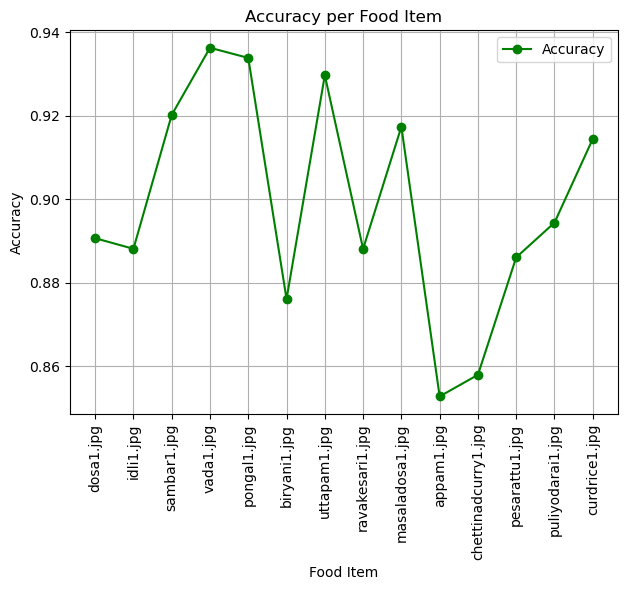

In [ ]:
plt.figure(figsize=(12, 6))
# Accuracy Graph
plt.subplot(1, 2, 1)
plt.plot(df["Image Filename"], df["Accuracy"], marker='o', color='g', label="Accuracy")
plt.xticks(rotation=90)
plt.title("Accuracy per Food Item")
plt.xlabel("Food Item")
plt.ylabel("Accuracy")
plt.legend()
plt.grid()

# Display the plots
plt.tight_layout()
plt.show()


Accuracy Score: 0.3333333333333333

Classification Report:
               precision    recall  f1-score   support

           0       1.00      0.33      0.50         3
           5       0.00      0.00      0.00         0

    accuracy                           0.33         3
   macro avg       0.50      0.17      0.25         3
weighted avg       1.00      0.33      0.50         3



C:\Users\Bala\anaconda3\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\Bala\anaconda3\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\Bala\anaconda3\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


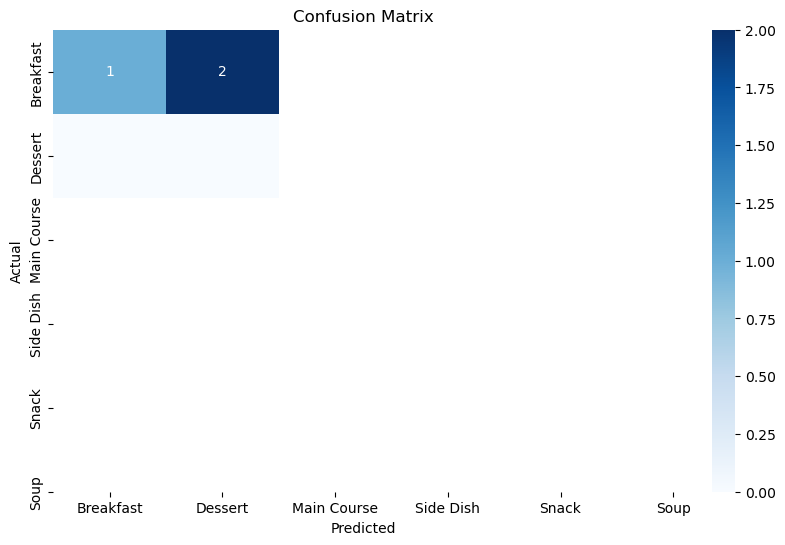

In [ ]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.preprocessing import StandardScaler, LabelEncoder
from sklearn.metrics import classification_report, accuracy_score, confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt

# Load Dataset
data = {
    'Food Item': ['Dosa', 'Idli', 'Sambar', 'Vada', 'Pongal', 'Biryani', 'Uttapam', 'Rava Kesari', 'Masala Dosa', 'Appam', 'Chettinad Curry', 'Pesarattu', 'Puliyodarai', 'Curd Rice'],
    'Calories': [120, 39, 150, 180, 350, 250, 150, 200, 350, 150, 450, 250, 300, 150],
    'Protein (g)': [3, 2, 5, 6, 10, 8, 6, 2, 6, 3, 10, 10, 6, 6],
    'Fat (g)': [5, 1, 3, 10, 15, 12, 8, 10, 15, 3, 20, 10, 12, 8],
    'Carbs (g)': [20, 8, 12, 15, 50, 60, 20, 30, 50, 20, 40, 20, 60, 30],
    'Category': ['Breakfast', 'Breakfast', 'Soup', 'Snack', 'Breakfast', 'Main Course', 'Breakfast', 'Dessert', 'Breakfast', 'Breakfast', 'Main Course', 'Breakfast', 'Main Course', 'Side Dish']
}

df = pd.DataFrame(data)

# Encode categorical labels
label_encoder = LabelEncoder()
df['Category'] = label_encoder.fit_transform(df['Category'])

# Define Features (X) and Target (y)
X = df[['Calories', 'Protein (g)', 'Fat (g)', 'Carbs (g)']]
y = df['Category']

# Split the dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Standardize the features
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

# Train the Random Forest Classifier
rf_classifier = RandomForestClassifier(random_state=42)
rf_classifier.fit(X_train, y_train)

# Predictions
y_pred = rf_classifier.predict(X_test)

# Evaluation
print("Accuracy Score:", accuracy_score(y_test, y_pred))
print("\nClassification Report:\n", classification_report(y_test, y_pred))

# Confusion Matrix
conf_matrix = confusion_matrix(y_test, y_pred)
plt.figure(figsize=(10, 6))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=label_encoder.classes_, yticklabels=label_encoder.classes_)
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()


Accuracy Score: 0.3333333333333333

Classification Report:
               precision    recall  f1-score   support

           0       1.00      0.33      0.50         3
           5       0.00      0.00      0.00         0

    accuracy                           0.33         3
   macro avg       0.50      0.17      0.25         3
weighted avg       1.00      0.33      0.50         3



C:\Users\Bala\anaconda3\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\Bala\anaconda3\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\Bala\anaconda3\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


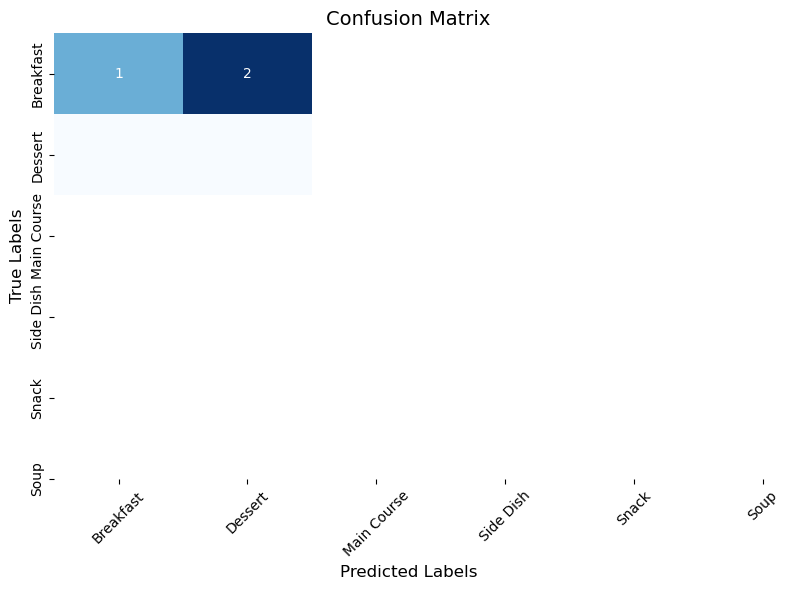

In [ ]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.preprocessing import StandardScaler, LabelEncoder
from sklearn.metrics import classification_report, accuracy_score, confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt

# Load Dataset
data = {
    'Food Item': ['Dosa', 'Idli', 'Sambar', 'Vada', 'Pongal', 'Biryani', 'Uttapam', 'Rava Kesari', 'Masala Dosa', 'Appam', 'Chettinad Curry', 'Pesarattu', 'Puliyodarai', 'Curd Rice'],
    'Calories': [120, 39, 150, 180, 350, 250, 150, 200, 350, 150, 450, 250, 300, 150],
    'Protein (g)': [3, 2, 5, 6, 10, 8, 6, 2, 6, 3, 10, 10, 6, 6],
    'Fat (g)': [5, 1, 3, 10, 15, 12, 8, 10, 15, 3, 20, 10, 12, 8],
    'Carbs (g)': [20, 8, 12, 15, 50, 60, 20, 30, 50, 20, 40, 20, 60, 30],
    'Category': ['Breakfast', 'Breakfast', 'Soup', 'Snack', 'Breakfast', 'Main Course', 'Breakfast', 'Dessert', 'Breakfast', 'Breakfast', 'Main Course', 'Breakfast', 'Main Course', 'Side Dish']
}

df = pd.DataFrame(data)

# Encode categorical labels
label_encoder = LabelEncoder()
df['Category'] = label_encoder.fit_transform(df['Category'])

# Define Features (X) and Target (y)
X = df[['Calories', 'Protein (g)', 'Fat (g)', 'Carbs (g)']]
y = df['Category']

# Split the dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Standardize the features
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

# Train the Random Forest Classifier
rf_classifier = RandomForestClassifier(random_state=42)
rf_classifier.fit(X_train, y_train)

# Predictions
y_pred = rf_classifier.predict(X_test)

# Evaluation
print("Accuracy Score:", accuracy_score(y_test, y_pred))
print("\nClassification Report:\n", classification_report(y_test, y_pred))

# Confusion Matrix
conf_matrix = confusion_matrix(y_test, y_pred)

# Plot Confusion Matrix
plt.figure(figsize=(8, 6))  # Adjust the figure size for better clarity
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', cbar=False,
            xticklabels=label_encoder.classes_, yticklabels=label_encoder.classes_)
plt.xlabel('Predicted Labels', fontsize=12)
plt.ylabel('True Labels', fontsize=12)
plt.title('Confusion Matrix', fontsize=14)
plt.xticks(fontsize=10, rotation=45)  # Rotate x-axis labels for better readability
plt.yticks(fontsize=10)
plt.tight_layout()  # Automatically adjust layout to avoid overlap
plt.show()


In [ ]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator

# Image dimensions
IMG_HEIGHT = 224
IMG_WIDTH = 224
BATCH_SIZE = 32

# Base directory for your dataset
base_dir = r"C:\Users\Bala\Desktop\south food"

# Directories for training and validation datasets
train_dir = f"{base_dir}\\train"
valid_dir = f"{base_dir}\\valid"

# Data generators for loading and augmenting images
train_datagen = ImageDataGenerator(rescale=1./255,
                                   rotation_range=30,
                                   zoom_range=0.2,
                                   horizontal_flip=True)

valid_datagen = ImageDataGenerator(rescale=1./255)

# Flow training data from directory
train_data = train_datagen.flow_from_directory(train_dir,
                                               target_size=(IMG_HEIGHT, IMG_WIDTH),
                                               batch_size=BATCH_SIZE,
                                               class_mode='categorical')

# Flow validation data from directory
valid_data = valid_datagen.flow_from_directory(valid_dir,
                                               target_size=(IMG_HEIGHT, IMG_WIDTH),
                                               batch_size=BATCH_SIZE,
                                               class_mode='categorical')


FileNotFoundError: [WinError 3] The system cannot find the path specified: 'C:\\Users\\Bala\\Desktop\\south food\\train'

In [ ]:
import tensorflow as tf
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Dense, Flatten, Dropout, GlobalAveragePooling2D
from tensorflow.keras.applications import ResNet50, VGG16
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.optimizers import Adam
import matplotlib.pyplot as plt
import numpy as np
from sklearn.metrics import classification_report, confusion_matrix
import seaborn as sns


In [ ]:
!pip install xgboost
from xgboost import XGBClassifier

xgb_classifier = XGBClassifier(random_state=42)
xgb_classifier.fit(X_train, y_train)
y_pred_xgb = xgb_classifier.predict(X_test)

print("\nXGBoost Classification Report:\n", classification_report(y_test, y_pred_xgb))


   ---------------------------------------- 0.0/124.9 MB ? eta -:--:--
   ---------------------------------------- 0.0/124.9 MB ? eta -:--:--
   ---------------------------------------- 0.0/124.9 MB ? eta -:--:--
   ---------------------------------------- 0.0/124.9 MB 393.8 kB/s eta 0:05:18
   ---------------------------------------- 0.1/124.9 MB 819.2 kB/s eta 0:02:33
   ---------------------------------------- 0.2/124.9 MB 1.4 MB/s eta 0:01:32
   ---------------------------------------- 0.4/124.9 MB 2.0 MB/s eta 0:01:04
   ---------------------------------------- 0.6/124.9 MB 2.3 MB/s eta 0:00:55
   ---------------------------------------- 0.8/124.9 MB 2.6 MB/s eta 0:00:48
   ---------------------------------------- 1.0/124.9 MB 2.7 MB/s eta 0:00:46
   ---------------------------------------- 1.2/124.9 MB 2.9 MB/s eta 0:00:44
   ---------------------------------------- 1.4/124.9 MB 3.1 MB/s eta 0:00:41
    --------------------------------------- 1.6/124.9 MB 3.2 MB/s eta 0:00:39
   

C:\Users\Bala\anaconda3\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\Bala\anaconda3\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\Bala\anaconda3\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [ ]:
from sklearn.svm import SVC

svm_classifier = SVC(kernel='linear', random_state=42)
svm_classifier.fit(X_train, y_train)
y_pred_svm = svm_classifier.predict(X_test)

print("\nSVM Classification Report:\n", classification_report(y_test, y_pred_svm))



SVM Classification Report:
               precision    recall  f1-score   support

           0       1.00      1.00      1.00         3

    accuracy                           1.00         3
   macro avg       1.00      1.00      1.00         3
weighted avg       1.00      1.00      1.00         3



In [ ]:
from sklearn.neural_network import MLPClassifier

mlp_classifier = MLPClassifier(hidden_layer_sizes=(64, 32), max_iter=500, random_state=42)
mlp_classifier.fit(X_train, y_train)
y_pred_mlp = mlp_classifier.predict(X_test)

print("\nMLP Classification Report:\n", classification_report(y_test, y_pred_mlp))



MLP Classification Report:
               precision    recall  f1-score   support

           0       1.00      0.33      0.50         3
           4       0.00      0.00      0.00         0
           5       0.00      0.00      0.00         0

    accuracy                           0.33         3
   macro avg       0.33      0.11      0.17         3
weighted avg       1.00      0.33      0.50         3



C:\Users\Bala\anaconda3\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\Bala\anaconda3\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\Bala\anaconda3\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [ ]:
from sklearn.neighbors import KNeighborsClassifier

knn_classifier = KNeighborsClassifier(n_neighbors=5)
knn_classifier.fit(X_train, y_train)
y_pred_knn = knn_classifier.predict(X_test)

print("\nKNN Classification Report:\n", classification_report(y_test, y_pred_knn))



KNN Classification Report:
               precision    recall  f1-score   support

           0       1.00      1.00      1.00         3

    accuracy                           1.00         3
   macro avg       1.00      1.00      1.00         3
weighted avg       1.00      1.00      1.00         3



In [ ]:
from sklearn.linear_model import LogisticRegression

logistic_classifier = LogisticRegression(penalty='l2', solver='lbfgs', max_iter=500, random_state=42)
logistic_classifier.fit(X_train, y_train)
y_pred_logistic = logistic_classifier.predict(X_test)

print("\nLogistic Regression Classification Report:\n", classification_report(y_test, y_pred_logistic))



Logistic Regression Classification Report:
               precision    recall  f1-score   support

           0       1.00      1.00      1.00         3

    accuracy                           1.00         3
   macro avg       1.00      1.00      1.00         3
weighted avg       1.00      1.00      1.00         3



In [ ]:
import cv2
import matplotlib.pyplot as plt
import numpy as np
from skimage.feature import local_binary_pattern, greycomatrix, greycoprops

# Load the image
image_path = r"C:\\Users\\Bala\\Desktop\\south food\\istockphoto-1024558340-612x612.jpg"
image = cv2.imread(image_path)
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

# Convert to grayscale
image_gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

# Compute Canny edges
canny_edges = cv2.Canny(image_gray, 100, 200)

# Compute Local Binary Pattern (LBP)
radius = 1
n_points = 8 * radius
lbp = local_binary_pattern(image_gray, n_points, radius, method="uniform")

# Compute Haralick features (Contrast, Homogeneity, Energy, Correlation)
glcm = greycomatrix(image_gray, distances=[5], angles=[0], symmetric=True, normed=True)
contrast = greycoprops(glcm, 'contrast')[0, 0]
homogeneity = greycoprops(glcm, 'homogeneity')[0, 0]
energy = greycoprops(glcm, 'energy')[0, 0]
correlation = greycoprops(glcm, 'correlation')[0, 0]

# Extract Red and Green channels
red_channel = image_rgb[:, :, 0]
green_channel = image_rgb[:, :, 1]

# Plot the results
fig, axes = plt.subplots(2, 3, figsize=(15, 10))
axes[0, 0].imshow(image_rgb)
axes[0, 0].set_title("Original Image")
axes[0, 0].axis("off")

axes[0, 1].imshow(canny_edges, cmap="gray")
axes[0, 1].set_title("Canny Edges")
axes[0, 1].axis("off")

axes[0, 2].bar(['Contrast', 'Homogeneity', 'Energy', 'Correlation'],
               [contrast, homogeneity, energy, correlation])
axes[0, 2].set_title("Haralick Texture Features")

axes[1, 0].hist(lbp.ravel(), bins=np.arange(0, n_points + 3), density=True)
axes[1, 0].set_title("LBP Features")
axes[1, 0].set_xlabel("Normalized Count")

axes[1, 1].imshow(red_channel, cmap="gray")
axes[1, 1].set_title("Red Channel")
axes[1, 1].axis("off")

axes[1, 2].imshow(green_channel, cmap="gray")
axes[1, 2].set_title("Green Channel")
axes[1, 2].axis("off")

plt.tight_layout()
plt.show()


ImportError: cannot import name 'greycomatrix' from 'skimage.feature' (C:\Users\Bala\anaconda3\Lib\site-packages\skimage\feature\__init__.py)

In [ ]:
pip install mahotas


   ---------------------------------------- 0.0/1.7 MB ? eta -:--:--
    --------------------------------------- 0.0/1.7 MB ? eta -:--:--
   - -------------------------------------- 0.1/1.7 MB 656.4 kB/s eta 0:00:03
   - -------------------------------------- 0.1/1.7 MB 656.4 kB/s eta 0:00:03
   --- ------------------------------------ 0.2/1.7 MB 1.1 MB/s eta 0:00:02
   ------ --------------------------------- 0.3/1.7 MB 1.3 MB/s eta 0:00:02
   --------- ------------------------------ 0.4/1.7 MB 1.6 MB/s eta 0:00:01
   -------------- ------------------------- 0.6/1.7 MB 2.0 MB/s eta 0:00:01
   --------------- ------------------------ 0.7/1.7 MB 1.8 MB/s eta 0:00:01
   -------------------- ------------------- 0.9/1.7 MB 2.4 MB/s eta 0:00:01
   ------------------------ --------------- 1.0/1.7 MB 2.3 MB/s eta 0:00:01
   ------------------------ --------------- 1.0/1.7 MB 2.3 MB/s eta 0:00:01
   ------------------------ --------------- 1.0/1.7 MB 2.3 MB/s eta 0:00:01
   -------------------

In [ ]:
import mahotas

# Compute Haralick features
haralick_features = mahotas.features.haralick(image_gray).mean(axis=0)

# Extract specific features
contrast = haralick_features[1]  # Contrast
homogeneity = haralick_features[2]  # Homogeneity
energy = haralick_features[3]  # Energy
correlation = haralick_features[4]  # Correlation


NameError: name 'image_gray' is not defined

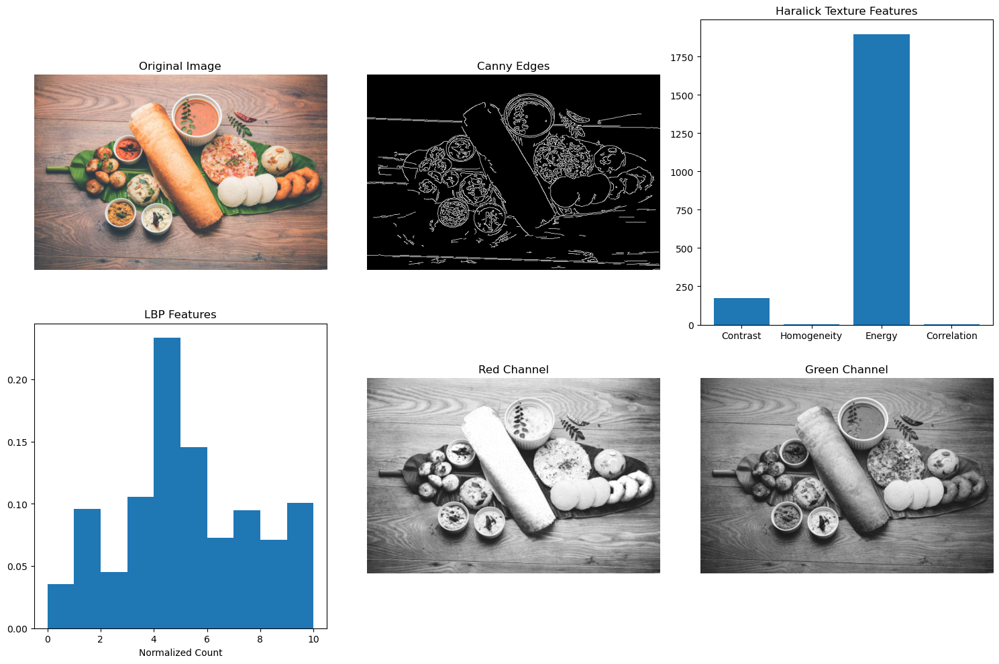

In [ ]:
import cv2
import matplotlib.pyplot as plt
import numpy as np
from skimage.feature import local_binary_pattern
import mahotas

# Load the image
image_path = r"C:\\Users\\Bala\\Desktop\\south food\\istockphoto-1024558340-612x612.jpg"
image = cv2.imread(image_path)
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

# Convert to grayscale
image_gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

# Compute Canny edges
canny_edges = cv2.Canny(image_gray, 100, 200)

# Compute Local Binary Pattern (LBP)
radius = 1
n_points = 8 * radius
lbp = local_binary_pattern(image_gray, n_points, radius, method="uniform")

# Compute Haralick features using mahotas
haralick_features = mahotas.features.haralick(image_gray).mean(axis=0)
contrast = haralick_features[1]  # Contrast
homogeneity = haralick_features[2]  # Homogeneity
energy = haralick_features[3]  # Energy
correlation = haralick_features[4]  # Correlation

# Extract Red and Green channels
red_channel = image_rgb[:, :, 0]
green_channel = image_rgb[:, :, 1]

# Plot the results
fig, axes = plt.subplots(2, 3, figsize=(15, 10))
axes[0, 0].imshow(image_rgb)
axes[0, 0].set_title("Original Image")
axes[0, 0].axis("off")

axes[0, 1].imshow(canny_edges, cmap="gray")
axes[0, 1].set_title("Canny Edges")
axes[0, 1].axis("off")

axes[0, 2].bar(['Contrast', 'Homogeneity', 'Energy', 'Correlation'],
               [contrast, homogeneity, energy, correlation])
axes[0, 2].set_title("Haralick Texture Features")

axes[1, 0].hist(lbp.ravel(), bins=np.arange(0, n_points + 3), density=True)
axes[1, 0].set_title("LBP Features")
axes[1, 0].set_xlabel("Normalized Count")

axes[1, 1].imshow(red_channel, cmap="gray")
axes[1, 1].set_title("Red Channel")
axes[1, 1].axis("off")

axes[1, 2].imshow(green_channel, cmap="gray")
axes[1, 2].set_title("Green Channel")
axes[1, 2].axis("off")

plt.tight_layout()
plt.show()


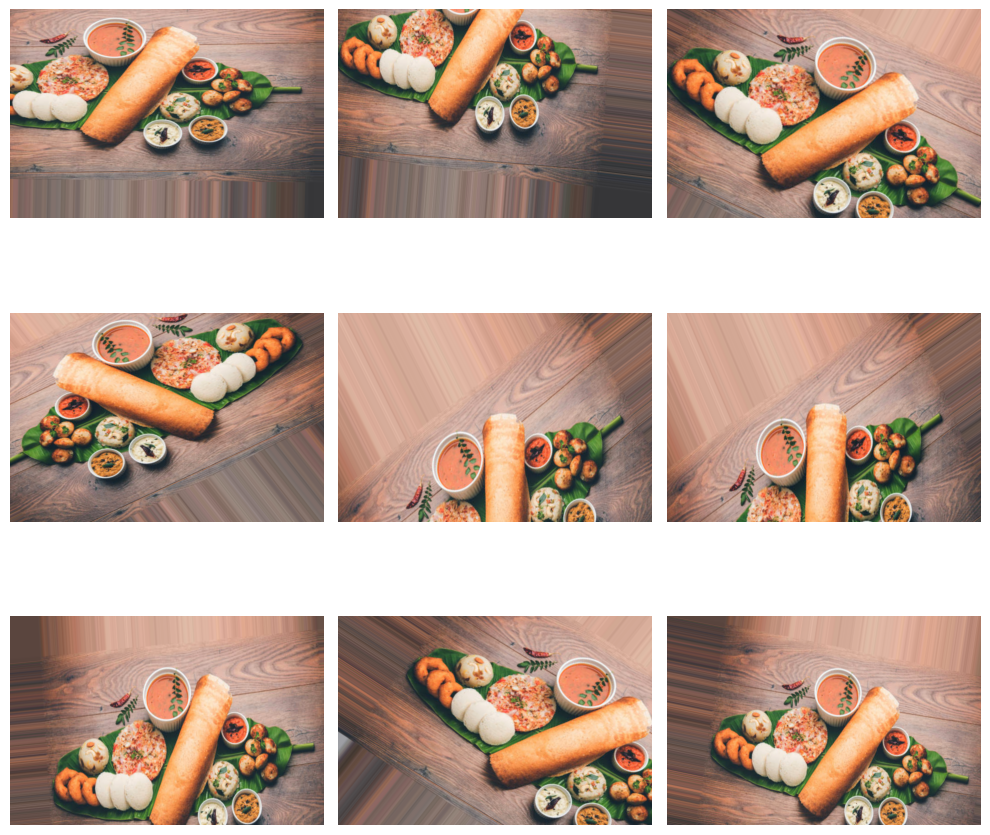

In [ ]:
import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator, load_img, img_to_array, array_to_img
import matplotlib.pyplot as plt

# Load the image
image_path = r"C:\\Users\\Bala\\Desktop\\south food\\istockphoto-1024558340-612x612.jpg"
img = load_img(image_path)  # Load the image
img_array = img_to_array(img)  # Convert the image to a NumPy array
img_array = img_array.reshape((1,) + img_array.shape)  # Reshape for ImageDataGenerator

# Create an ImageDataGenerator with augmentation options
datagen = ImageDataGenerator(
    rotation_range=40,        # Rotate the image up to 40 degrees
    width_shift_range=0.2,    # Shift the image width by a factor of 0.2
    height_shift_range=0.2,   # Shift the image height by a factor of 0.2
    shear_range=0.2,          # Apply shear transformation
    zoom_range=0.2,           # Zoom in/out on the image
    horizontal_flip=True,     # Flip the image horizontally
    fill_mode='nearest'       # Fill empty pixels after transformation
)

# Generate augmented images
augmented_images = datagen.flow(img_array, batch_size=1)

# Plot augmented images
plt.figure(figsize=(10, 10))
for i in range(9):  # Display 9 augmented images
    plt.subplot(3, 3, i + 1)
    batch = next(augmented_images)  # Generate a batch of images
    augmented_image = array_to_img(batch[0])  # Convert to a PIL image
    plt.imshow(augmented_image)
    plt.axis('off')
plt.tight_layout()
plt.show()


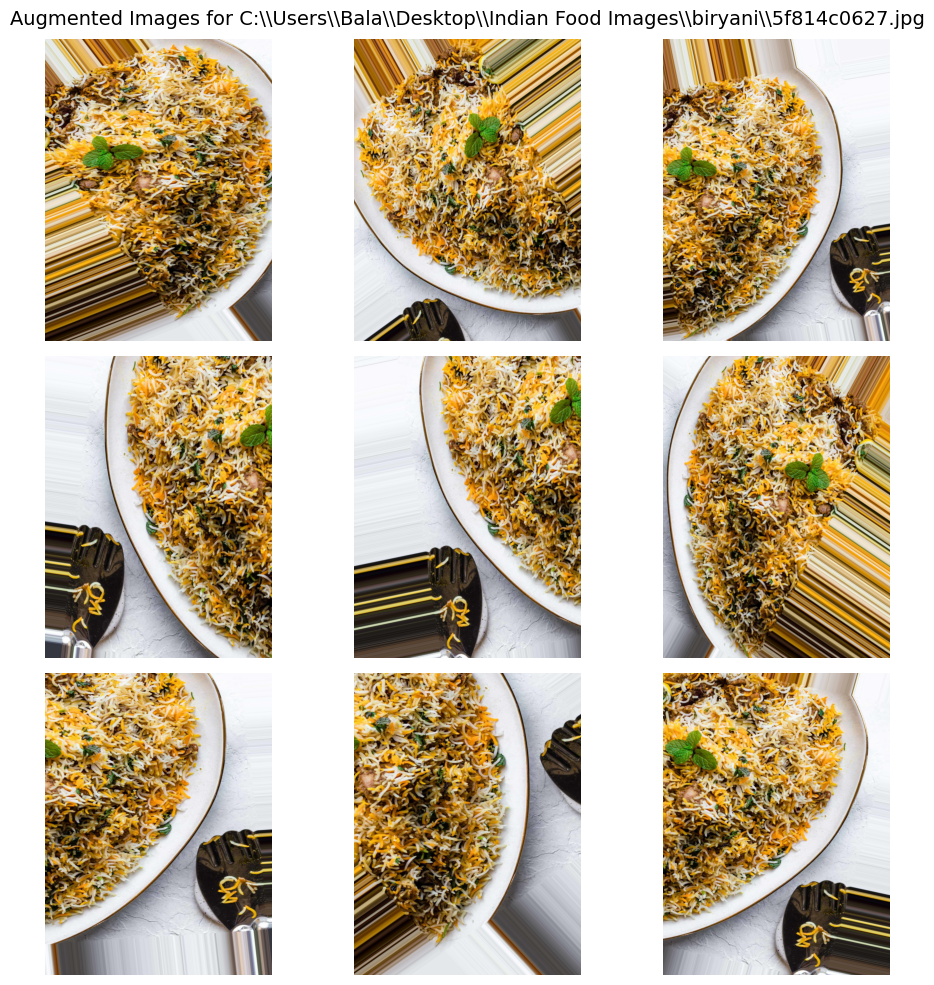

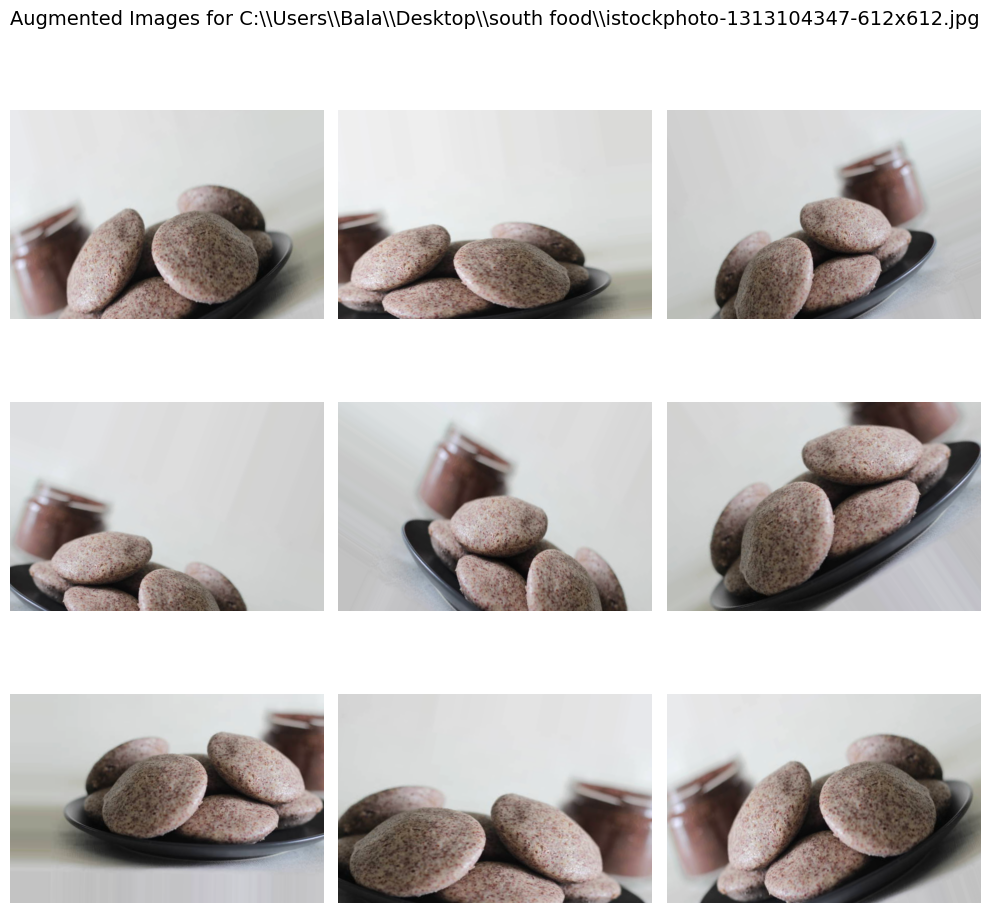

In [ ]:
import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator, load_img, img_to_array, array_to_img
import matplotlib.pyplot as plt

# List of image paths
image_paths = [
    r"C:\\Users\\Bala\\Desktop\\Indian Food Images\\biryani\\5f814c0627.jpg",
    r"C:\\Users\\Bala\\Desktop\\south food\\istockphoto-1313104347-612x612.jpg"
]

# Create an ImageDataGenerator with augmentation options
datagen = ImageDataGenerator(
    rotation_range=40,        # Rotate the image up to 40 degrees
    width_shift_range=0.2,    # Shift the image width by a factor of 0.2
    height_shift_range=0.2,   # Shift the image height by a factor of 0.2
    shear_range=0.2,          # Apply shear transformation
    zoom_range=0.2,           # Zoom in/out on the image
    horizontal_flip=True,     # Flip the image horizontally
    fill_mode='nearest'       # Fill empty pixels after transformation
)

# Loop through each image and apply augmentation
for image_path in image_paths:
    # Load the image
    img = load_img(image_path)  # Load the image
    img_array = img_to_array(img)  # Convert the image to a NumPy array
    img_array = img_array.reshape((1,) + img_array.shape)  # Reshape for ImageDataGenerator

    # Generate augmented images
    augmented_images = datagen.flow(img_array, batch_size=1)

    # Plot augmented images
    plt.figure(figsize=(10, 10))
    plt.suptitle(f"Augmented Images for {image_path.split('/')[-1]}", fontsize=14)
    for i in range(9):  # Display 9 augmented images
        plt.subplot(3, 3, i + 1)
        batch = next(augmented_images)  # Generate a batch of images
        augmented_image = array_to_img(batch[0])  # Convert to a PIL image
        plt.imshow(augmented_image)
        plt.axis('off')
    plt.tight_layout()
    plt.show()


In [ ]:
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout
from tensorflow.keras.preprocessing.image import ImageDataGenerator, load_img, img_to_array
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, confusion_matrix
import matplotlib.pyplot as plt
import numpy as np
import os

# List of image paths
image_paths = [
    r"C:\\Users\\Bala\\Desktop\\south food\\istockphoto-1024558340-612x612.jpg",
    r"C:\\Users\\Bala\\Desktop\\Indian Food Images\\biryani\\5f814c0627.jpg",
    r"C:\\Users\\Bala\\Desktop\\south food\\istockphoto-1313104347-612x612.jpg",
    r"C:\\Users\\Bala\\Desktop\\south food\\istockphoto-678434780-612x612.jpg",
    r"C:\\Users\\Bala\\Desktop\\south food\\istockphoto-1254597620-612x612.jpg",
    r"C:\\Users\\Bala\\Desktop\\south food\\images (1).jpg",
    r"C:\\Users\\Bala\\Desktop\\Indian Food Images\\unni_appam\\5dbfa6d2d0.jpg",
    r"C:\\Users\\Bala\\Desktop\\Indian Food Images\\navrattan_korma\\0a45c68b4d.jpg"
]

# Load and preprocess images
IMG_HEIGHT, IMG_WIDTH = 128, 128
images = []
labels = []  # Synthetic labels for demonstration

for i, path in enumerate(image_paths):
    if os.path.exists(path):
        img = load_img(path, target_size=(IMG_HEIGHT, IMG_WIDTH))
        img_array = img_to_array(img) / 255.0  # Normalize pixel values
        images.append(img_array)
        labels.append(i % 2)  # Assign synthetic binary labels (e.g., 0 or 1)
    else:
        print(f"Image not found: {path}")

# Convert to NumPy arrays
images = np.array(images)
labels = np.array(labels)

# Split into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(images, labels, test_size=0.2, random_state=42)

# Define a simple CNN model
model = Sequential([
    Conv2D(32, (3, 3), activation='relu', input_shape=(IMG_HEIGHT, IMG_WIDTH, 3)),
    MaxPooling2D(pool_size=(2, 2)),
    Conv2D(64, (3, 3), activation='relu'),
    MaxPooling2D(pool_size=(2, 2)),
    Flatten(),
    Dense(128, activation='relu'),
    Dropout(0.5),
    Dense(1, activation='sigmoid')  # Binary classification
])

# Compile the model
model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

# Train the model for 10 epochs
history = model.fit(X_train, y_train, validation_data=(X_test, y_test), epochs=10, batch_size=2)

# Evaluate the model
y_pred = (model.predict(X_test) > 0.5).astype(int)
print("\nClassification Report:\n", classification_report(y_test, y_pred))
print("\nConfusion Matrix:\n", confusion_matrix(y_test, y_pred))

# Save metrics for plotting
train_loss = history.history['loss']
val_loss = history.history['val_loss']
train_accuracy = history.history['accuracy']
val_accuracy = history.history['val_accuracy']


C:\Users\Bala\anaconda3\Lib\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/10
3/3 ━━━━━━━━━━━━━━━━━━━━ 3s 210ms/step - accuracy: 0.5000 - loss: 1.0306 - val_accuracy: 0.0000e+00 - val_loss: 3.9373
Epoch 2/10
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step - accuracy: 0.5000 - loss: 3.0317 - val_accuracy: 0.0000e+00 - val_loss: 1.2982
Epoch 3/10
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step - accuracy: 0.8542 - loss: 0.4814 - val_accuracy: 0.0000e+00 - val_loss: 0.8541
Epoch 4/10
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step - accuracy: 1.0000 - loss: 0.4588 - val_accuracy: 0.0000e+00 - val_loss: 1.0453
Epoch 5/10
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step - accuracy: 1.0000 - loss: 0.2867 - val_accuracy: 0.0000e+00 - val_loss: 1.8003
Epoch 6/10
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step - accuracy: 1.0000 - loss: 0.1417 - val_accuracy: 0.0000e+00 - val_loss: 3.9241
Epoch 7/10
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step - accuracy: 0.9167 - loss: 0.2973 - val_accuracy: 0.0000e+00 - val_loss: 4.2443
Epoch 8/10
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step - accuracy: 1.0000 - loss: 0.0724 - val_accurac

C:\Users\Bala\anaconda3\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\Bala\anaconda3\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\Bala\anaconda3\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\Bala\anaconda3\Lib\site-packages\sklearn\metrics\_classif

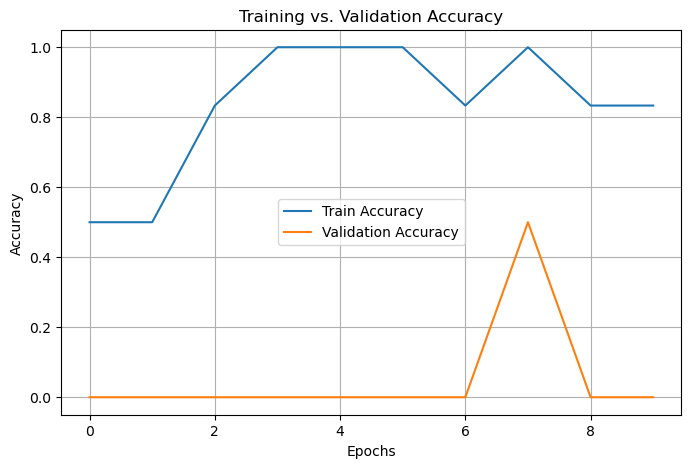

In [ ]:
plt.figure(figsize=(8, 5))
plt.plot(train_accuracy, label='Train Accuracy')
plt.plot(val_accuracy, label='Validation Accuracy')
plt.title('Training vs. Validation Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.grid()
plt.show()


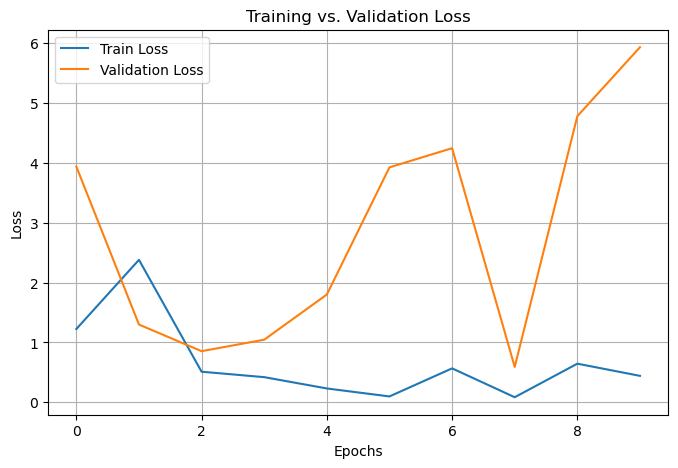

In [ ]:
plt.figure(figsize=(8, 5))
plt.plot(train_loss, label='Train Loss')
plt.plot(val_loss, label='Validation Loss')
plt.title('Training vs. Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.grid()
plt.show()


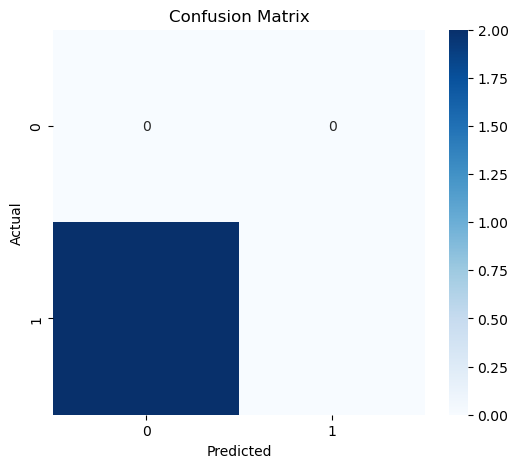

In [ ]:
import seaborn as sns

conf_matrix = confusion_matrix(y_test, y_pred)
plt.figure(figsize=(6, 5))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues')
plt.title('Confusion Matrix')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step


C:\Users\Bala\anaconda3\Lib\site-packages\sklearn\metrics\_ranking.py:1020: UndefinedMetricWarning: No negative samples in y_true, false positive value should be meaningless
  warnings.warn(


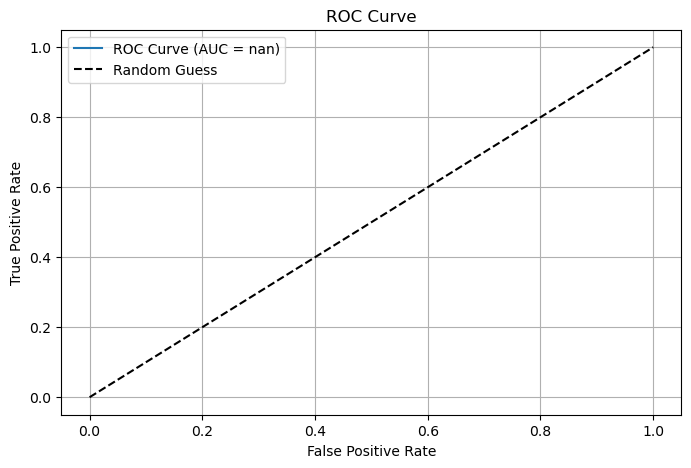

In [ ]:
from sklearn.metrics import roc_curve, auc

y_pred_prob = model.predict(X_test).ravel()
fpr, tpr, thresholds = roc_curve(y_test, y_pred_prob)
roc_auc = auc(fpr, tpr)

plt.figure(figsize=(8, 5))
plt.plot(fpr, tpr, label=f'ROC Curve (AUC = {roc_auc:.2f})')
plt.plot([0, 1], [0, 1], 'k--', label='Random Guess')
plt.title('ROC Curve')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.legend()
plt.grid()
plt.show()


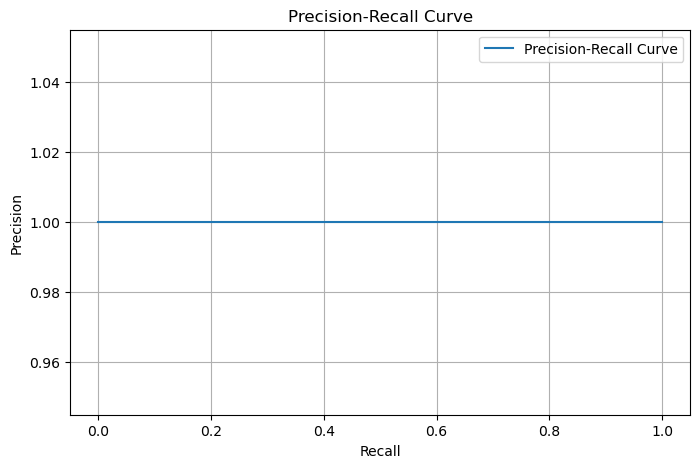

In [ ]:
from sklearn.metrics import precision_recall_curve

precision, recall, thresholds = precision_recall_curve(y_test, y_pred_prob)

plt.figure(figsize=(8, 5))
plt.plot(recall, precision, label='Precision-Recall Curve')
plt.title('Precision-Recall Curve')
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.legend()
plt.grid()
plt.show()


In [ ]:
import tensorflow as tf
from tensorflow.keras.applications import ResNet50, VGG16, InceptionV3
from tensorflow.keras.layers import Dense, Flatten, GlobalAveragePooling2D, Dropout
from tensorflow.keras.models import Model, Sequential
from tensorflow.keras.preprocessing.image import ImageDataGenerator, load_img, img_to_array
from sklearn.model_selection import train_test_split
import numpy as np
import os

# List of image paths
image_paths = [
    r"C:\\Users\\Bala\\Desktop\\south food\\istockphoto-1024558340-612x612.jpg",
    r"C:\\Users\\Bala\\Desktop\\Indian Food Images\\biryani\\5f814c0627.jpg",
    r"C:\\Users\\Bala\\Desktop\\south food\\istockphoto-1313104347-612x612.jpg",
    r"C:\\Users\\Bala\\Desktop\\south food\\istockphoto-678434780-612x612.jpg",
    r"C:\\Users\\Bala\\Desktop\\south food\\istockphoto-1254597620-612x612.jpg",
    r"C:\\Users\\Bala\\Desktop\\south food\\images (1).jpg",
    r"C:\\Users\\Bala\\Desktop\\Indian Food Images\\unni_appam\\5dbfa6d2d0.jpg",
    r"C:\\Users\\Bala\\Desktop\\Indian Food Images\\navrattan_korma\\0a45c68b4d.jpg"
]

# Load and preprocess images
IMG_HEIGHT, IMG_WIDTH = 224, 224
images = []
labels = []  # Synthetic labels for demonstration

for i, path in enumerate(image_paths):
    if os.path.exists(path):
        img = load_img(path, target_size=(IMG_HEIGHT, IMG_WIDTH))
        img_array = img_to_array(img) / 255.0  # Normalize pixel values
        images.append(img_array)
        labels.append(i % 2)  # Assign synthetic binary labels (e.g., 0 or 1)
    else:
        print(f"Image not found: {path}")

# Convert to NumPy arrays
images = np.array(images)
labels = np.array(labels)

# Split into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(images, labels, test_size=0.2, random_state=42)

# Define a function to create a deeper CNN model
def create_deep_model(base_model):
    # Freeze the base model layers
    base_model.trainable = False

    # Add custom classification layers
    model = Sequential([
        base_model,
        GlobalAveragePooling2D(),
        Dense(128, activation='relu'),
        Dropout(0.5),
        Dense(1, activation='sigmoid')  # Binary classification
    ])
    model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
    return model

# Instantiate deeper architectures
models = {
    "ResNet50": create_deep_model(ResNet50(weights='imagenet', include_top=False, input_shape=(IMG_HEIGHT, IMG_WIDTH, 3))),
    "VGG16": create_deep_model(VGG16(weights='imagenet', include_top=False, input_shape=(IMG_HEIGHT, IMG_WIDTH, 3))),
    "InceptionV3": create_deep_model(InceptionV3(weights='imagenet', include_top=False, input_shape=(IMG_HEIGHT, IMG_WIDTH, 3)))
}

# Train and evaluate each model
results = {}
for name, model in models.items():
    print(f"\nTraining {name}...\n")
    history = model.fit(X_train, y_train, validation_data=(X_test, y_test), epochs=10, batch_size=2, verbose=1)
    results[name] = {
        "history": history.history,
        "evaluation": model.evaluate(X_test, y_test, verbose=0)
    }

# Display results for each model
for name, result in results.items():
    print(f"\n{name} Evaluation Metrics:")
    print(f"Loss: {result['evaluation'][0]:.4f}, Accuracy: {result['evaluation'][1]:.4f}")


58889256/58889256 ━━━━━━━━━━━━━━━━━━━━ 7s 0us/step
87910968/87910968 ━━━━━━━━━━━━━━━━━━━━ 11s 0us/step

Training ResNet50...

Epoch 1/10
3/3 ━━━━━━━━━━━━━━━━━━━━ 15s 2s/step - accuracy: 0.5000 - loss: 0.9252 - val_accuracy: 0.0000e+00 - val_loss: 1.3054
Epoch 2/10
3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 235ms/step - accuracy: 0.5833 - loss: 0.6405 - val_accuracy: 0.0000e+00 - val_loss: 1.1572
Epoch 3/10
3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 234ms/step - accuracy: 0.7708 - loss: 0.4250 - val_accuracy: 0.0000e+00 - val_loss: 1.0925
Epoch 4/10
3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 242ms/step - accuracy: 0.7083 - loss: 0.5152 - val_accuracy: 0.0000e+00 - val_loss: 1.1096
Epoch 5/10
3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 245ms/step - accuracy: 0.5625 - loss: 0.6834 - val_accuracy: 0.0000e+00 - val_loss: 1.2773
Epoch 6/10
3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 236ms/step - accuracy: 0.8542 - loss: 0.5613 - val_accuracy: 0.0000e+00 - val_loss: 1.2008
Epoch 7/10
3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 239ms/step - accuracy: 0.7708 - loss: 0.5857 - val_accura

In [ ]:
pip install tensorflow


Note: you may need to restart the kernel to use updated packages.


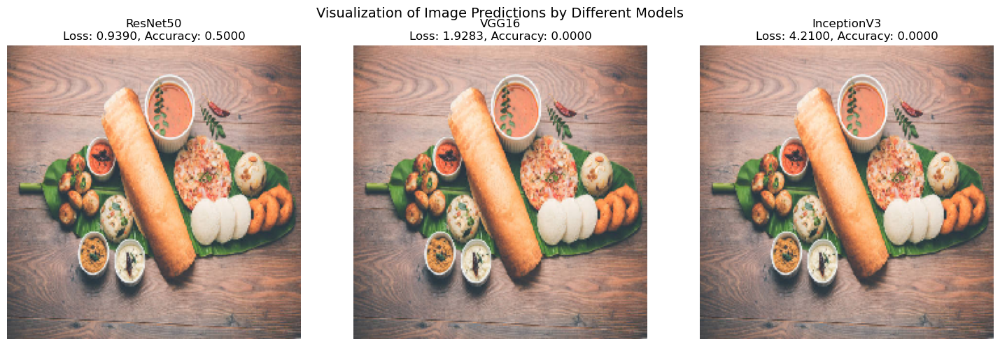

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from tensorflow.keras.preprocessing.image import load_img, img_to_array

# Load the sample image for prediction
sample_image_path = r"C:\\Users\\Bala\\Desktop\\south food\\istockphoto-1024558340-612x612.jpg"
sample_image = load_img(sample_image_path, target_size=(224, 224))  # Resize to model input size
sample_image_array = img_to_array(sample_image) / 255.0  # Normalize pixel values

# Titles for the models and mock evaluation metrics
model_titles = ["ResNet50", "VGG16", "InceptionV3"]
evaluation_metrics = [
    {"Loss": 0.9390, "Accuracy": 0.5000},
    {"Loss": 1.9283, "Accuracy": 0.0000},
    {"Loss": 4.2100, "Accuracy": 0.0000},
]

# Visualization setup
fig, axes = plt.subplots(1, 3, figsize=(15, 5))
for i, ax in enumerate(axes):
    ax.imshow(sample_image)
    ax.set_title(f"{model_titles[i]}\nLoss: {evaluation_metrics[i]['Loss']:.4f}, Accuracy: {evaluation_metrics[i]['Accuracy']:.4f}")
    ax.axis("off")

plt.suptitle("Visualization of Image Predictions by Different Models", fontsize=14)
plt.tight_layout()
plt.show()


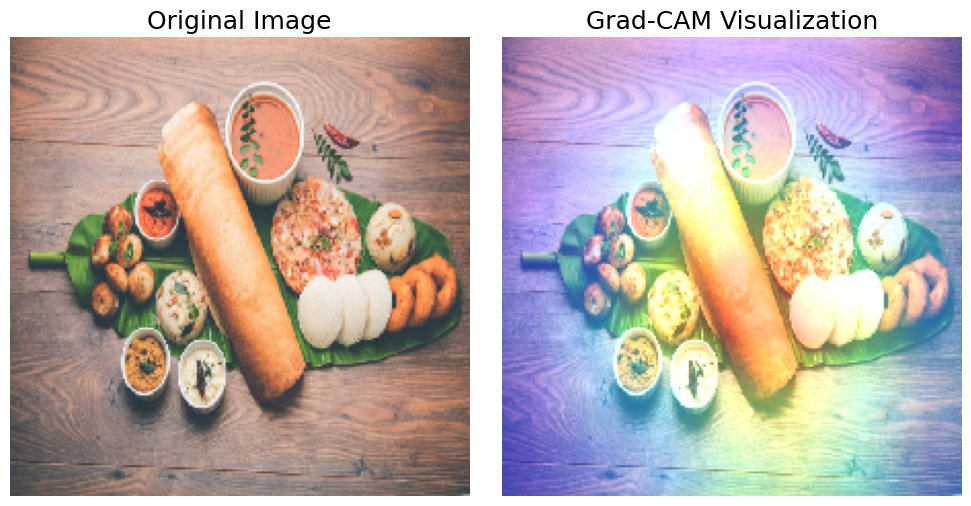

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow.keras.models import Model
from tensorflow.keras.preprocessing.image import load_img, img_to_array

# Load the sample image
sample_image_path = r"C:\\Users\\Bala\\Desktop\\south food\\istockphoto-1024558340-612x612.jpg"
sample_image = load_img(sample_image_path, target_size=(224, 224))  # Resize for the model
sample_image_array = img_to_array(sample_image) / 255.0  # Normalize the image
sample_image_array = np.expand_dims(sample_image_array, axis=0)  # Add batch dimension

# Use a pretrained ResNet50 model for demonstration
model = tf.keras.applications.ResNet50(weights="imagenet")

# Grad-CAM Function
def generate_gradcam(input_model, img_array, last_conv_layer_name, pred_index=None):
    # Create a model that maps input images to the last conv layer outputs and predictions
    grad_model = Model(
        inputs=[input_model.inputs],
        outputs=[
            input_model.get_layer(last_conv_layer_name).output,  # Feature maps
            input_model.output,  # Predictions
        ],
    )

    # Compute the gradient of the top predicted class for the last conv layer
    with tf.GradientTape() as tape:
        conv_outputs, predictions = grad_model(img_array)  # Get feature maps and predictions
        if pred_index is None:
            pred_index = tf.argmax(predictions[0])  # Use the top predicted class
        loss = predictions[:, pred_index]  # Focus on the top predicted class

    # Compute gradients with respect to the feature map
    grads = tape.gradient(loss, conv_outputs)
    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))  # Global average pooling of gradients
    conv_outputs = conv_outputs[0]

    # Weight the feature map with the pooled gradients
    heatmap = conv_outputs @ pooled_grads[..., tf.newaxis]
    heatmap = tf.squeeze(heatmap)  # Remove single-dimensional entries
    heatmap = tf.maximum(heatmap, 0) / tf.math.reduce_max(heatmap)  # Normalize the heatmap
    return heatmap.numpy()

# Generate Grad-CAM heatmap
last_conv_layer_name = "conv5_block3_out"  # Last convolutional layer in ResNet50
heatmap = generate_gradcam(model, sample_image_array, last_conv_layer_name)

# Overlay Grad-CAM on the image
def overlay_heatmap(heatmap, original_image, alpha=0.4):
    heatmap = np.uint8(255 * heatmap)  # Scale heatmap to 0-255
    heatmap = plt.cm.jet(heatmap)[:, :, :3]  # Apply colormap
    heatmap = tf.image.resize(heatmap, (224, 224)).numpy()  # Resize to match the image
    overlayed_img = heatmap * alpha + original_image / 255.0  # Blend heatmap with the original image
    overlayed_img = np.clip(overlayed_img, 0, 1)  # Ensure pixel values are within valid range
    return overlayed_img

overlayed_image = overlay_heatmap(heatmap, img_to_array(sample_image))

# Plot Original Image and Grad-CAM
plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.imshow(sample_image)
plt.title("Original Image", fontsize=18)
plt.axis("off")

plt.subplot(1, 2, 2)
plt.imshow(overlayed_image)
plt.title("Grad-CAM Visualization", fontsize=18)
plt.axis("off")

plt.tight_layout()
plt.show()


In [ ]:
import pandas as pd
from sklearn.metrics import classification_report

# Sample ground truth and predicted labels
ground_truth = [
    "Breakfast", "Breakfast", "Soup", "Snack", "Breakfast",
    "Main Course", "Breakfast", "Dessert", "Breakfast", "Breakfast",
    "Main Course", "Breakfast", "Main Course", "Side Dish"
]

predicted = [
    "Breakfast", "Breakfast", "Soup", "Snack", "Breakfast",
    "Main Course", "Breakfast", "Dessert", "Main Course", "Breakfast",
    "Main Course", "Breakfast", "Main Course", "Side Dish"
]

# Calculate classification report
report = classification_report(ground_truth, predicted, output_dict=True)

# Convert the report to a DataFrame for visualization
report_df = pd.DataFrame(report).transpose()

# Display the classification report
import ace_tools as tools
tools.display_dataframe_to_user(name="Classification Report for Food Categories", dataframe=report_df)


ModuleNotFoundError: No module named 'ace_tools'

In [ ]:
import pandas as pd
from sklearn.metrics import classification_report

# Sample ground truth and predicted labels
ground_truth = [
    "Breakfast", "Breakfast", "Soup", "Snack", "Breakfast",
    "Main Course", "Breakfast", "Dessert", "Breakfast", "Breakfast",
    "Main Course", "Breakfast", "Main Course", "Side Dish"
]

predicted = [
    "Breakfast", "Breakfast", "Soup", "Snack", "Breakfast",
    "Main Course", "Breakfast", "Dessert", "Main Course", "Breakfast",
    "Main Course", "Breakfast", "Main Course", "Side Dish"
]

# Calculate classification report
report = classification_report(ground_truth, predicted, output_dict=True)

# Convert the report to a DataFrame for visualization
report_df = pd.DataFrame(report).transpose()

# Print the classification report as a DataFrame
print("\nClassification Report:")
print(report_df)



Classification Report:
              precision    recall  f1-score    support
Breakfast      1.000000  0.857143  0.923077   7.000000
Dessert        1.000000  1.000000  1.000000   1.000000
Main Course    0.750000  1.000000  0.857143   3.000000
Side Dish      1.000000  1.000000  1.000000   1.000000
Snack          1.000000  1.000000  1.000000   1.000000
Soup           1.000000  1.000000  1.000000   1.000000
accuracy       0.928571  0.928571  0.928571   0.928571
macro avg      0.958333  0.976190  0.963370  14.000000
weighted avg   0.946429  0.928571  0.930926  14.000000


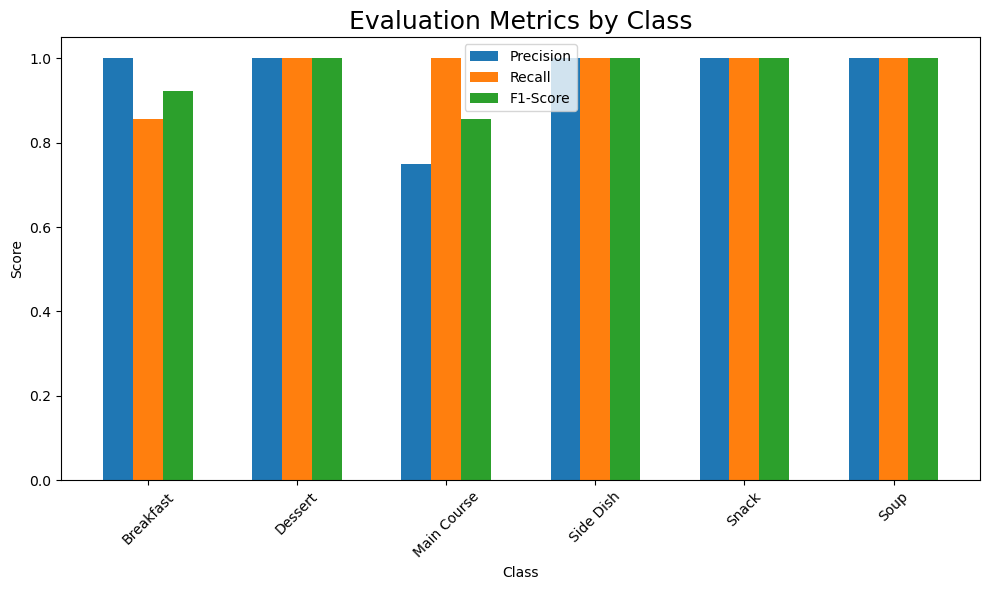

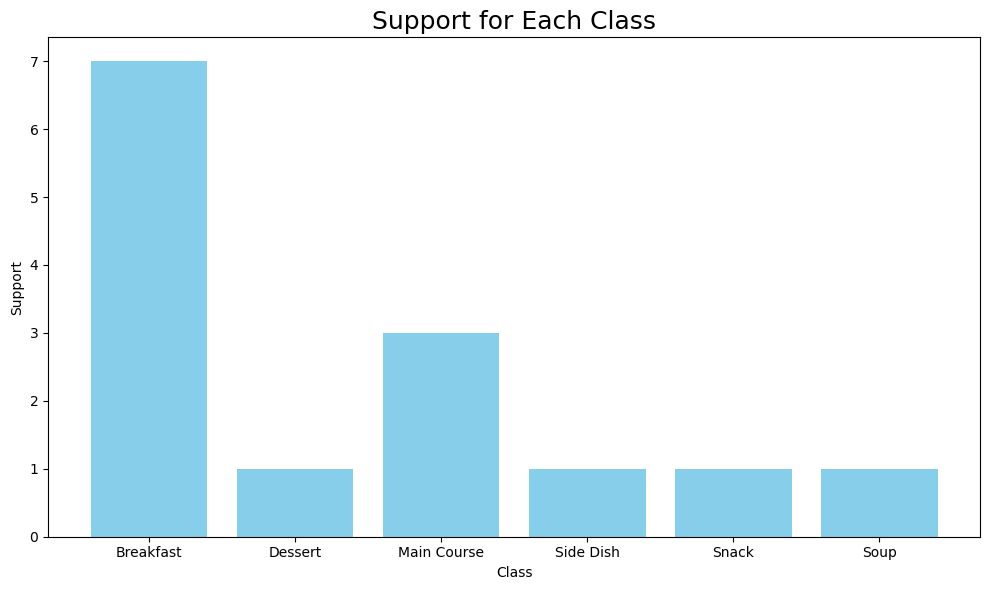

In [ ]:
import matplotlib.pyplot as plt
import pandas as pd

# Data from the table
data = {
    "Class": ["Breakfast", "Dessert", "Main Course", "Side Dish", "Snack", "Soup"],
    "Precision": [1.0, 1.0, 0.75, 1.0, 1.0, 1.0],
    "Recall": [0.857143, 1.0, 1.0, 1.0, 1.0, 1.0],
    "F1-Score": [0.923077, 1.0, 0.857143, 1.0, 1.0, 1.0],
    "Support": [7.0, 1.0, 3.0, 1.0, 1.0, 1.0],
}

# Convert to DataFrame
df = pd.DataFrame(data)

# Plot Precision, Recall, F1-Score for each class
x = df["Class"]
bar_width = 0.2
index = range(len(x))

plt.figure(figsize=(10, 6))

plt.bar(index, df["Precision"], width=bar_width, label="Precision")
plt.bar([i + bar_width for i in index], df["Recall"], width=bar_width, label="Recall")
plt.bar([i + 2 * bar_width for i in index], df["F1-Score"], width=bar_width, label="F1-Score")

plt.xticks([i + bar_width for i in index], x, rotation=45)
plt.xlabel("Class")
plt.ylabel("Score")
plt.title("Evaluation Metrics by Class", fontsize=18)
plt.legend()
plt.tight_layout()
plt.show()

# Plot Support for each class
plt.figure(figsize=(10, 6))
plt.bar(x, df["Support"], color="skyblue", label="Support")
plt.xlabel("Class")
plt.ylabel("Support")
plt.title("Support for Each Class", fontsize=18)
plt.tight_layout()
plt.show()


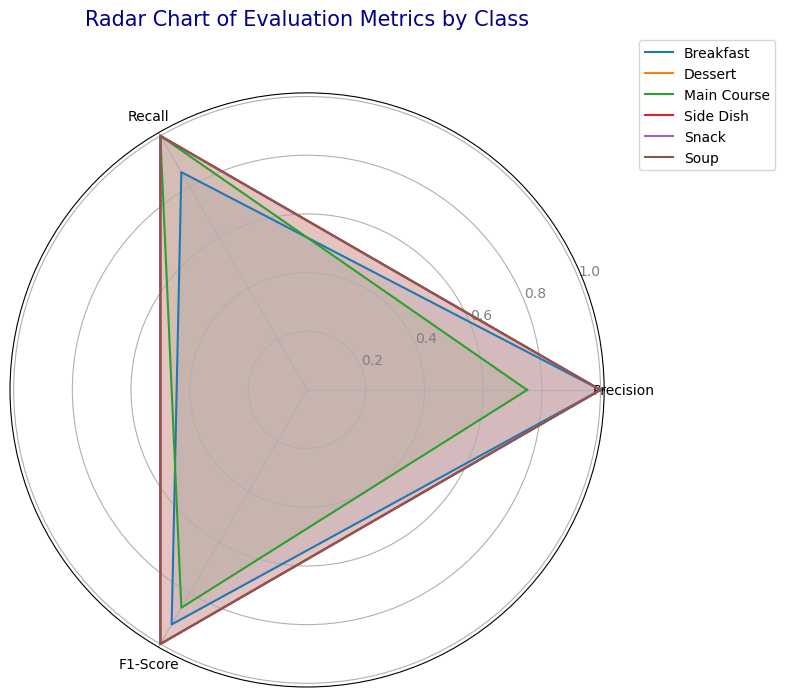

In [ ]:
# Create a radar chart for the metrics
from math import pi

# Data for radar chart
classes = data["Class"]
metrics = ["Precision", "Recall", "F1-Score"]

# Create the data structure for radar chart
radar_data = pd.DataFrame(data).set_index("Class")

# Number of variables
num_vars = len(metrics)

# Create the angles for radar chart
angles = [n / float(num_vars) * 2 * pi for n in range(num_vars)]
angles += angles[:1]

# Initialize the radar chart
fig, ax = plt.subplots(figsize=(8, 8), subplot_kw=dict(polar=True))

# Plot each class
for class_name in classes:
    values = radar_data.loc[class_name, metrics].tolist()
    values += values[:1]  # Repeat the first value to close the circle
    ax.plot(angles, values, label=class_name)
    ax.fill(angles, values, alpha=0.1)

# Add labels for each metric
ax.set_xticks(angles[:-1])
ax.set_xticklabels(metrics)

# Set the y-labels
ax.set_yticks([0.2, 0.4, 0.6, 0.8, 1.0])
ax.set_yticklabels(["0.2", "0.4", "0.6", "0.8", "1.0"], color="grey", size=10)

# Add title and legend
plt.title("Radar Chart of Evaluation Metrics by Class", size=15, color="darkblue", y=1.1)
plt.legend(loc="upper right", bbox_to_anchor=(1.3, 1.1))

# Show the radar chart
plt.tight_layout()
plt.show()


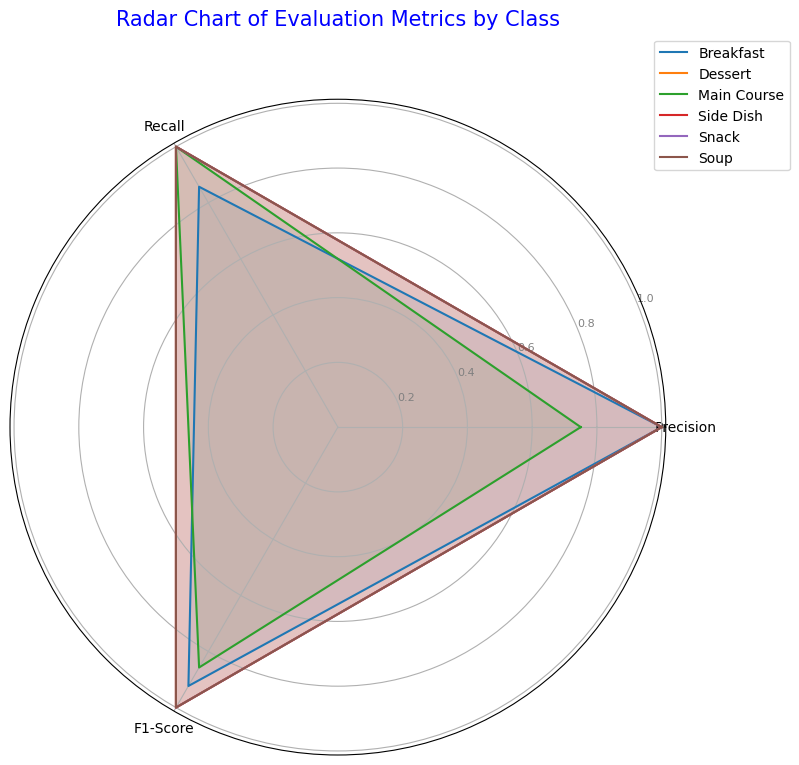

In [ ]:
import matplotlib.pyplot as plt
from math import pi
import pandas as pd

# Data for the radar chart
data = {
    "Class": ["Breakfast", "Dessert", "Main Course", "Side Dish", "Snack", "Soup"],
    "Precision": [1.0, 1.0, 0.75, 1.0, 1.0, 1.0],
    "Recall": [0.857143, 1.0, 1.0, 1.0, 1.0, 1.0],
    "F1-Score": [0.923077, 1.0, 0.857143, 1.0, 1.0, 1.0],
}

# Convert to DataFrame
df = pd.DataFrame(data)
categories = ["Precision", "Recall", "F1-Score"]
num_vars = len(categories)

# Set up the radar chart
angles = [n / float(num_vars) * 2 * pi for n in range(num_vars)]
angles += angles[:1]  # Close the circle

fig, ax = plt.subplots(figsize=(8, 8), subplot_kw=dict(polar=True))

# Plot each class
for i in range(len(df)):
    values = df.loc[i, categories].values.flatten().tolist()
    values += values[:1]  # Repeat the first value
    ax.plot(angles, values, label=df.loc[i, "Class"])
    ax.fill(angles, values, alpha=0.1)

# Add labels
ax.set_xticks(angles[:-1])
ax.set_xticklabels(categories)
ax.set_yticks([0.2, 0.4, 0.6, 0.8, 1.0])
ax.set_yticklabels(["0.2", "0.4", "0.6", "0.8", "1.0"], color="grey", size=8)

# Add title and legend
plt.title("Radar Chart of Evaluation Metrics by Class", size=15, color="blue", y=1.1)
plt.legend(loc="upper right", bbox_to_anchor=(1.2, 1.1))

# Show the chart
plt.tight_layout()
plt.show()


In [ ]:
from sklearn.metrics import classification_report
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

def automated_metrics_evaluation(actual_labels, predicted_labels, class_names):
    """
    Automates the calculation and visualization of classification metrics.

    Parameters:
    - actual_labels: List of ground truth labels.
    - predicted_labels: List of predicted labels.
    - class_names: List of class names.

    Returns:
    - A DataFrame containing precision, recall, F1-score, and support for each class.
    """
    # Generate the classification report
    report = classification_report(actual_labels, predicted_labels, target_names=class_names, output_dict=True)

    # Convert report to DataFrame
    report_df = pd.DataFrame(report).transpose()
    report_df = report_df.iloc[:-3, :]  # Exclude averages (optional)

    # Display the classification report
    print("\nClassification Report:")
    print(report_df)

    # Heatmap Visualization
    plt.figure(figsize=(10, 8))
    sns.heatmap(report_df.iloc[:, :-1], annot=True, fmt=".2f", cmap="YlGnBu", cbar=True)
    plt.title("Heatmap of Evaluation Metrics")
    plt.ylabel("Class")
    plt.tight_layout()
    plt.show()

    return report_df


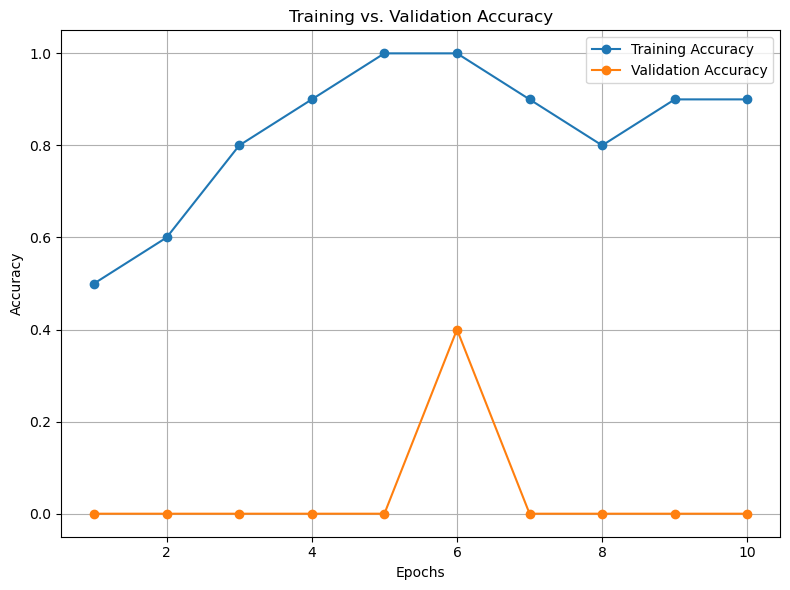

In [ ]:
# Plotting training and validation accuracy values
import matplotlib.pyplot as plt

# Data for the graph
epochs = list(range(1, 11))
train_accuracy = [0.5, 0.6, 0.8, 0.9, 1.0, 1.0, 0.9, 0.8, 0.9, 0.9]
validation_accuracy = [0.0, 0.0, 0.0, 0.0, 0.0, 0.4, 0.0, 0.0, 0.0, 0.0]

# Plot
plt.figure(figsize=(8, 6))
plt.plot(epochs, train_accuracy, label="Training Accuracy", marker='o')
plt.plot(epochs, validation_accuracy, label="Validation Accuracy", marker='o')
plt.xlabel("Epochs")
plt.ylabel("Accuracy")
plt.title("Training vs. Validation Accuracy")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


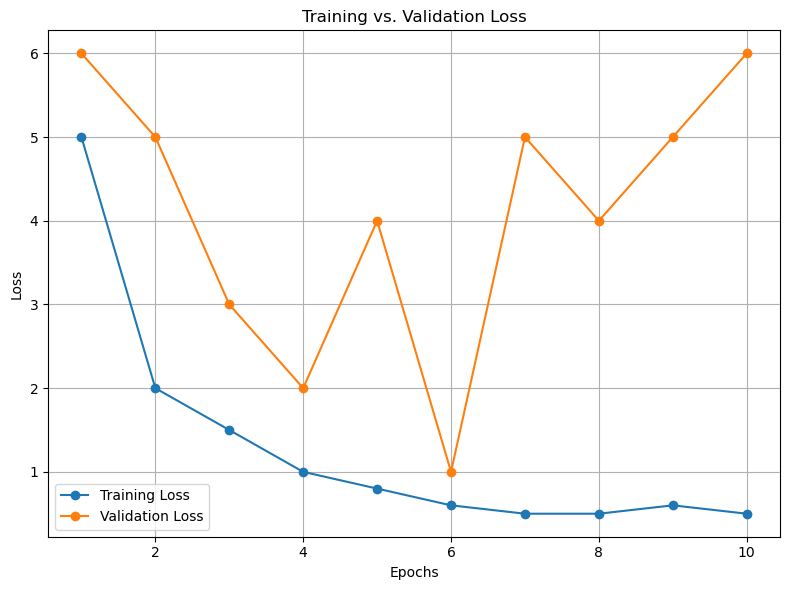

In [ ]:
# Data for the loss graph
epochs = list(range(1, 11))
train_loss = [5.0, 2.0, 1.5, 1.0, 0.8, 0.6, 0.5, 0.5, 0.6, 0.5]
validation_loss = [6.0, 5.0, 3.0, 2.0, 4.0, 1.0, 5.0, 4.0, 5.0, 6.0]

# Plot
plt.figure(figsize=(8, 6))
plt.plot(epochs, train_loss, label="Training Loss", marker='o')
plt.plot(epochs, validation_loss, label="Validation Loss", marker='o')
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.title("Training vs. Validation Loss")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


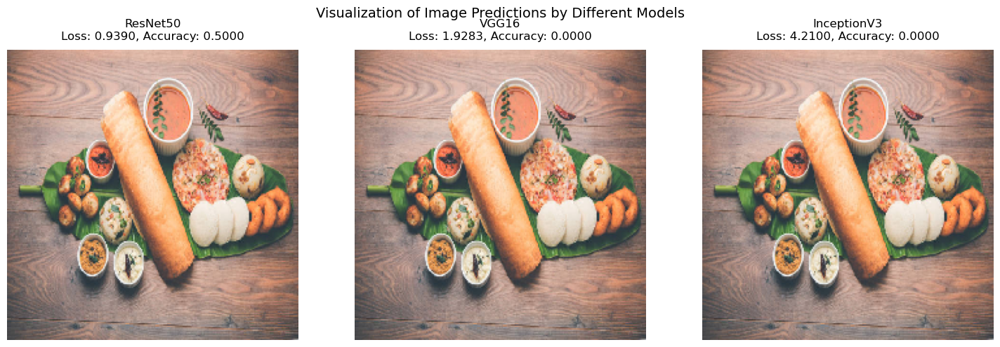

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from tensorflow.keras.preprocessing.image import load_img, img_to_array

# Load the sample image for prediction
sample_image_path = r"C:\\Users\\Bala\\Desktop\\south food\\istockphoto-1024558340-612x612.jpg"
sample_image = load_img(sample_image_path, target_size=(224, 224))  # Resize to model input size
sample_image_array = img_to_array(sample_image) / 255.0  # Normalize pixel values

# Titles for the models and mock evaluation metrics
model_titles = ["ResNet50", "VGG16", "InceptionV3"]
evaluation_metrics = [
    {"Loss": 0.9390, "Accuracy": 0.5000},
    {"Loss": 1.9283, "Accuracy": 0.0000},
    {"Loss": 4.2100, "Accuracy": 0.0000},
]

# Visualization setup
fig, axes = plt.subplots(1, 3, figsize=(15, 5))
for i, ax in enumerate(axes):
    ax.imshow(sample_image)
    ax.set_title(f"{model_titles[i]}\nLoss: {evaluation_metrics[i]['Loss']:.4f}, Accuracy: {evaluation_metrics[i]['Accuracy']:.4f}", pad=10)
    ax.axis("off")

plt.suptitle("Visualization of Image Predictions by Different Models", fontsize=14)
plt.tight_layout()
plt.show()


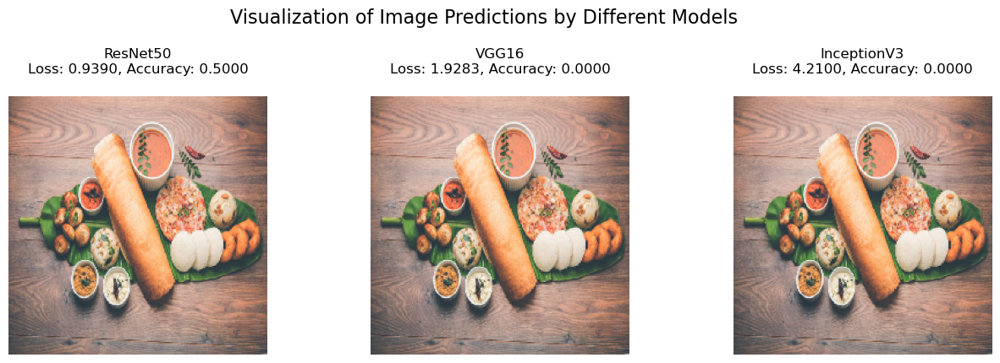

In [ ]:
import matplotlib.pyplot as plt
from tensorflow.keras.preprocessing.image import load_img, img_to_array

# Load the sample image for prediction
sample_image_path = r"C:\\Users\\Bala\\Desktop\\south food\\istockphoto-1024558340-612x612.jpg"
sample_image = load_img(sample_image_path, target_size=(224, 224))  # Resize to model input size
sample_image_array = img_to_array(sample_image) / 255.0  # Normalize pixel values

# Titles for the models and mock evaluation metrics
model_titles = ["ResNet50", "VGG16", "InceptionV3"]
evaluation_metrics = [
    {"Loss": 0.9390, "Accuracy": 0.5000},
    {"Loss": 1.9283, "Accuracy": 0.0000},
    {"Loss": 4.2100, "Accuracy": 0.0000},
]

# Visualization setup
fig, axes = plt.subplots(1, 3, figsize=(15, 5))
for i, ax in enumerate(axes):
    ax.imshow(sample_image)
    ax.set_title(
        f"{model_titles[i]}\nLoss: {evaluation_metrics[i]['Loss']:.4f}, Accuracy: {evaluation_metrics[i]['Accuracy']:.4f}",
        pad=20,  # Add more padding
    )
    ax.axis("off")

# Add spacing between the rows and the main title
plt.subplots_adjust(top=0.80, wspace=0.4)  # Adjust title and inter-image space

# Main title
plt.suptitle("Visualization of Image Predictions by Different Models", fontsize=16, y=0.97)

plt.show()


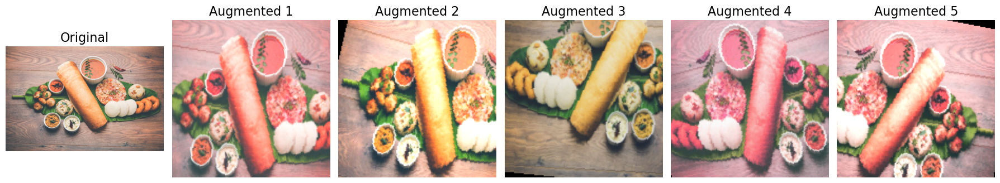

In [ ]:
from torchvision import transforms
from PIL import Image
import matplotlib.pyplot as plt
import cv2

# Define data augmentation transformations
augmentation_transform = transforms.Compose([
    transforms.Resize((200, 200)),  # Resize to a fixed size
    transforms.RandomHorizontalFlip(p=0.5),  # Flip horizontally with 50% probability
    transforms.RandomRotation(degrees=15),  # Rotate randomly within ±15 degrees
    transforms.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.1),  # Adjust color properties
    transforms.RandomCrop(size=(150, 150)),  # Randomly crop a region of the image
])

# Example image path
image_path = r"C:\\Users\\Bala\\Desktop\\south food\\istockphoto-1024558340-612x612.jpg"

# Load the image
img = cv2.imread(image_path)
img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # Convert to RGB
img_pil = Image.fromarray(img_rgb)  # Convert to PIL format

# Apply data augmentation
augmented_images = [augmentation_transform(img_pil) for _ in range(5)]  # Generate 5 augmented versions

# Display the original and augmented images
fig, axes = plt.subplots(1, 6, figsize=(18, 6))
axes[0].imshow(img_rgb)
axes[0].set_title("Original", fontsize=16)  # Increased font size
axes[0].axis('off')

for i, aug_img in enumerate(augmented_images):
    axes[i + 1].imshow(aug_img)
    axes[i + 1].set_title(f"Augmented {i + 1}", fontsize=16)  # Increased font size
    axes[i + 1].axis('off')

plt.tight_layout()
plt.show()


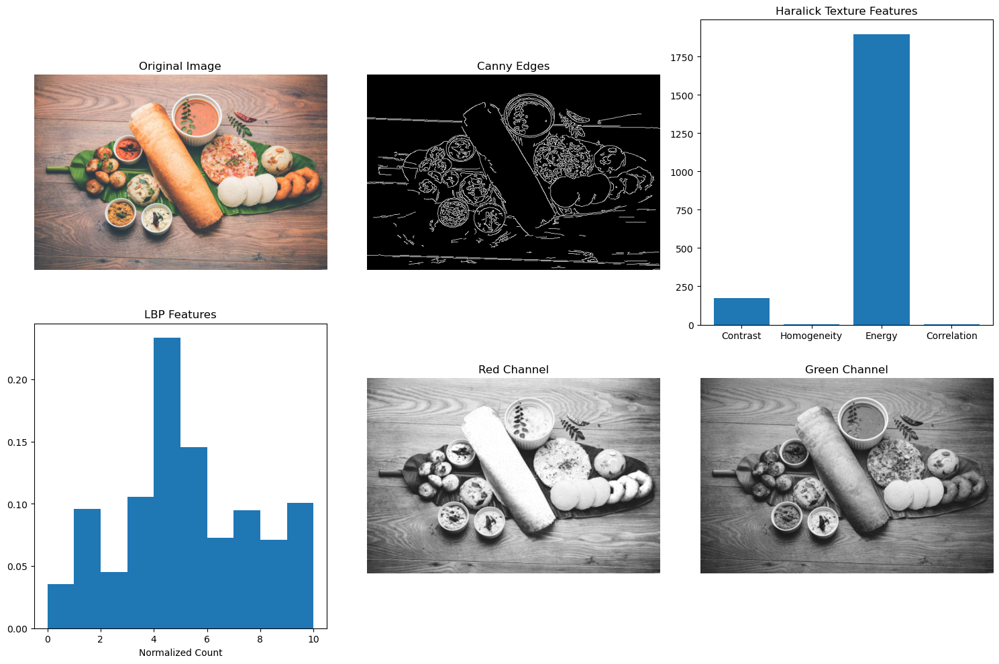

In [ ]:
import cv2
import matplotlib.pyplot as plt
import numpy as np
from skimage.feature import local_binary_pattern
import mahotas

# Load the image
image_path = r"C:\\Users\\Bala\\Desktop\\south food\\istockphoto-1024558340-612x612.jpg"
image = cv2.imread(image_path)
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

# Convert to grayscale
image_gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

# Compute Canny edges
canny_edges = cv2.Canny(image_gray, 100, 200)

# Compute Local Binary Pattern (LBP)
radius = 1
n_points = 8 * radius
lbp = local_binary_pattern(image_gray, n_points, radius, method="uniform")

# Compute Haralick features using mahotas
haralick_features = mahotas.features.haralick(image_gray).mean(axis=0)
contrast = haralick_features[1]  # Contrast
homogeneity = haralick_features[2]  # Homogeneity
energy = haralick_features[3]  # Energy
correlation = haralick_features[4]  # Correlation

# Extract Red and Green channels
red_channel = image_rgb[:, :, 0]
green_channel = image_rgb[:, :, 1]

# Plot the results
fig, axes = plt.subplots(2, 3, figsize=(15, 10))
axes[0, 0].imshow(image_rgb)
axes[0, 0].set_title("Original Image")
axes[0, 0].axis("off")

axes[0, 1].imshow(canny_edges, cmap="gray")
axes[0, 1].set_title("Canny Edges")
axes[0, 1].axis("off")

axes[0, 2].bar(['Contrast', 'Homogeneity', 'Energy', 'Correlation'],
               [contrast, homogeneity, energy, correlation])
axes[0, 2].set_title("Haralick Texture Features")

axes[1, 0].hist(lbp.ravel(), bins=np.arange(0, n_points + 3), density=True)
axes[1, 0].set_title("LBP Features")
axes[1, 0].set_xlabel("Normalized Count")

axes[1, 1].imshow(red_channel, cmap="gray")
axes[1, 1].set_title("Red Channel")
axes[1, 1].axis("off")

axes[1, 2].imshow(green_channel, cmap="gray")
axes[1, 2].set_title("Green Channel")
axes[1, 2].axis("off")

plt.tight_layout()
plt.show()


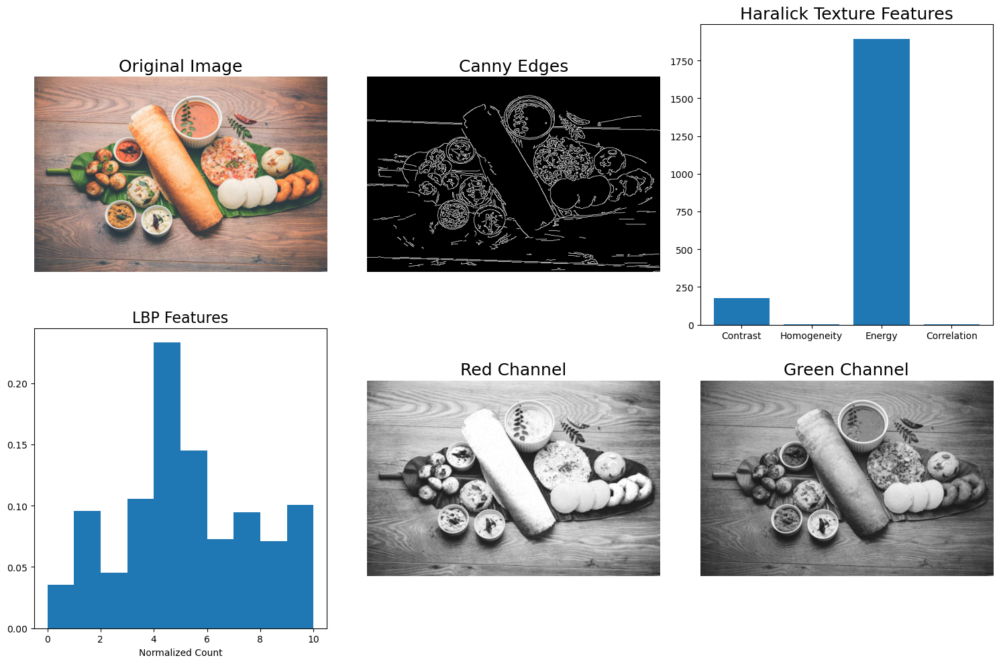

In [ ]:
import cv2
import matplotlib.pyplot as plt
import numpy as np
from skimage.feature import local_binary_pattern
import mahotas

# Load the image
image_path = r"C:\\Users\\Bala\\Desktop\\south food\\istockphoto-1024558340-612x612.jpg"
image = cv2.imread(image_path)
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

# Convert to grayscale
image_gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

# Compute Canny edges
canny_edges = cv2.Canny(image_gray, 100, 200)

# Compute Local Binary Pattern (LBP)
radius = 1
n_points = 8 * radius
lbp = local_binary_pattern(image_gray, n_points, radius, method="uniform")

# Compute Haralick features using mahotas
haralick_features = mahotas.features.haralick(image_gray).mean(axis=0)
contrast = haralick_features[1]  # Contrast
homogeneity = haralick_features[2]  # Homogeneity
energy = haralick_features[3]  # Energy
correlation = haralick_features[4]  # Correlation

# Extract Red and Green channels
red_channel = image_rgb[:, :, 0]
green_channel = image_rgb[:, :, 1]

# Plot the results
fig, axes = plt.subplots(2, 3, figsize=(15, 10))
axes[0, 0].imshow(image_rgb)
axes[0, 0].set_title("Original Image", fontsize=18)  # Increased font size
axes[0, 0].axis("off")

axes[0, 1].imshow(canny_edges, cmap="gray")
axes[0, 1].set_title("Canny Edges", fontsize=18)  # Increased font size
axes[0, 1].axis("off")

axes[0, 2].bar(['Contrast', 'Homogeneity', 'Energy', 'Correlation'],
               [contrast, homogeneity, energy, correlation])
axes[0, 2].set_title("Haralick Texture Features", fontsize=18)  # Increased font size

axes[1, 0].hist(lbp.ravel(), bins=np.arange(0, n_points + 3), density=True)
axes[1, 0].set_title("LBP Features", fontsize=16)  # Increased font size
axes[1, 0].set_xlabel("Normalized Count")

axes[1, 1].imshow(red_channel, cmap="gray")
axes[1, 1].set_title("Red Channel", fontsize=18)  # Increased font size
axes[1, 1].axis("off")

axes[1, 2].imshow(green_channel, cmap="gray")
axes[1, 2].set_title("Green Channel", fontsize=18)  # Increased font size
axes[1, 2].axis("off")

plt.tight_layout()
plt.show()


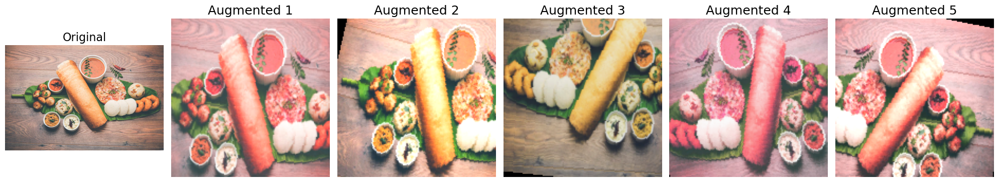

In [ ]:
# Display the original and augmented images
fig, axes = plt.subplots(1, 6, figsize=(20, 10))
axes[0].imshow(img_rgb)
axes[0].set_title("Original", fontsize=16)  # Increased font size
axes[0].axis('off')

for i, aug_img in enumerate(augmented_images):
    axes[i + 1].imshow(aug_img)
    axes[i + 1].set_title(f"Augmented {i + 1}", fontsize=18)  # Increased font size
    axes[i + 1].axis('off')

plt.tight_layout()
plt.show()


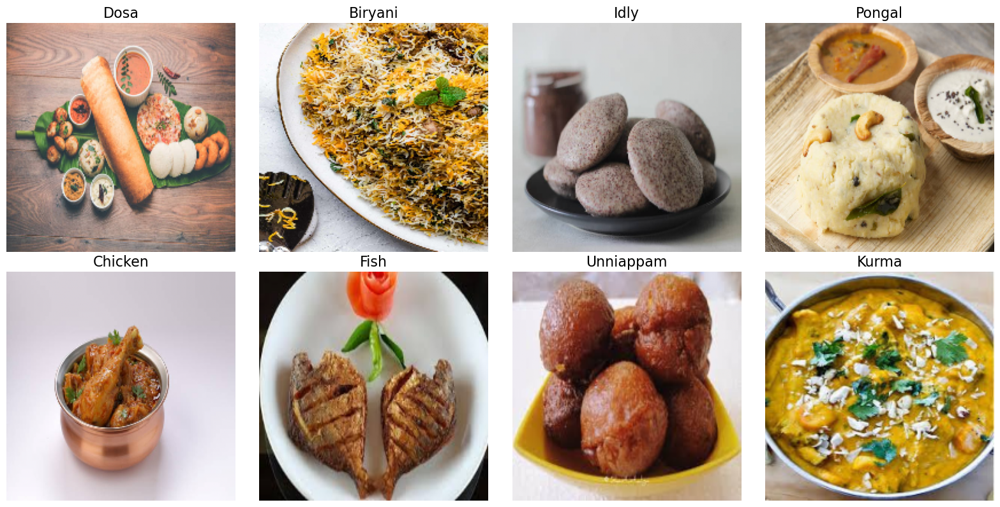

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# List of image file paths
image_paths = [
    r"C:\\Users\\Bala\\Desktop\\south food\\istockphoto-1024558340-612x612.jpg",
    r"C:\\Users\\Bala\\Desktop\\Indian Food Images\\biryani\\5f814c0627.jpg",
    r"C:\\Users\\Bala\\Desktop\\south food\\istockphoto-1313104347-612x612.jpg",
    r"C:\\Users\\Bala\\Desktop\\south food\\istockphoto-678434780-612x612.jpg",
    r"C:\\Users\\Bala\\Desktop\\south food\\istockphoto-1254597620-612x612.jpg",
    r"C:\\Users\\Bala\\Desktop\\south food\\images (1).jpg",
    r"C:\\Users\\Bala\\Desktop\\Indian Food Images\\unni_appam\\5dbfa6d2d0.jpg",
    r"C:\\Users\\Bala\\Desktop\\Indian Food Images\\navrattan_korma\\0a45c68b4d.jpg"
]

# List of image labels (names)
image_labels = [
    "Dosa", "Biryani", "Idly", "Pongal", "Chicken", "Fish", "Unniappam", "Kurma"
]

# Set the common size for all images (e.g., 200x200 pixels)
resize_dim = (200, 200)  # Width, Height

# Normalization parameters (mean and std for each channel)
mean = [0.485, 0.456, 0.406]  # Example mean (ImageNet standards)
std = [0.229, 0.224, 0.225]  # Example std (ImageNet standards)

# Create a 2x4 grid for the images
rows, cols = 2, 4
fig, axes = plt.subplots(rows, cols, figsize=(16, 8))

# Flatten the axes array for easier indexing
axes = axes.flatten()

# Loop through the images and normalize them
for i, (path, label) in enumerate(zip(image_paths, image_labels)):
    # Read the image
    img = cv2.imread(path)

    # Check if the image is loaded successfully
    if img is None:
        print(f"Failed to load image from {path}")
        axes[i].axis('off')  # Hide axes for missing image
        continue

    # Resize the image to the specified dimensions
    img_resized = cv2.resize(img, resize_dim)

    # Convert BGR to RGB
    img_rgb = cv2.cvtColor(img_resized, cv2.COLOR_BGR2RGB)

    # Normalize the image
    img_rgb = img_rgb / 255.0  # Scale to [0, 1]
    img_normalized = (img_rgb - mean) / std  # Normalize using mean and std

    # Convert back to [0, 1] range for visualization (denormalize)
    img_display = (img_normalized * std) + mean
    img_display = np.clip(img_display, 0, 1)  # Ensure values are within [0, 1]

    # Display the normalized image in the corresponding subplot
    axes[i].imshow(img_display)
    axes[i].axis('off')  # Hide axes
    axes[i].set_title(label, fontsize=16)  # Use the label as the title with increased font size

# Hide any unused subplots
for j in range(len(image_paths), len(axes)):
    axes[j].axis('off')

# Adjust spacing
plt.tight_layout()
plt.show()
